# import packages

In [2]:
#use this with schpf_p37 environment
!conda list

# packages in environment at /home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2:
#
# Name                    Version                   Build  Channel
_libgcc_mutex             0.1                 conda_forge    conda-forge
_openmp_mutex             4.5                       2_gnu    conda-forge
_r-mutex                  1.0.1               anacondar_1    conda-forge
alabaster                 0.7.12                     py_0    conda-forge
alsa-lib                  1.2.6.1              h7f98852_0    conda-forge
anndata                   0.8.0           py310hff52083_0    conda-forge
anyio                     3.6.1           py310hff52083_0    conda-forge
anytree                   2.8.0                    pypi_0    pypi
appdirs                   1.4.4              pyh9f0ad1d_0    conda-forge
argon2-cffi               21.3.0             pyhd8ed1ab_0    conda-forge
argon2-cffi-bindings      21.2.0          py310h5764c6d_2    conda-forge
arpack                    3.7.0                hde

In [3]:
def overlap_coefficient(set_a,set_b):
    min_len = min([len(set_a),len(set_b)])
    intersect_len = len(set_a.intersection(set_b))
    overlap = intersect_len/min_len
    return overlap


In [4]:
#custom library
from SPECTRA_processing_utils import *
from scrnaseq_preprocessing_utils import *

In [5]:
#import packages
import scanpy as sc
import scanpy.external as sce
import anndata as anndata
from anndata import AnnData

import time
import os
import numpy as np
import seaborn as sns
import pandas as pd
import re
import h5py
import scipy
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.patches as patches
import matplotlib.colors as colors
import matplotlib.font_manager
%matplotlib inline

# other packages
import glob
from collections import OrderedDict
from scipy.sparse import csr_matrix
from scanpy.external.pp import magic
from scipy.stats import zscore
import scipy.cluster.hierarchy as hc
from statistics import median
import math
from typing import Union
import numpy.matlib

In [6]:
DATA_DIR = '/data/peer/wallet/Jupyter/SPADE_Peer_validation/data/'
figure_save_path =  '/data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/'
source_save_path =  '/data/peer/wallet/Jupyter/SPADE_Peer_validation/figure_source/'

In [7]:
#set style
sns.set_style('white')
# define colors
color_map_clusters = ["#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059",
"#FFDBE5", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",
"#5A0007", "#809693", "#1B4400", "#4FC601", "#3B5DFF", "#4A3B53", "#FF2F80",
"#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", "#B903AA", "#D16100",
"#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",
"#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",
"#00489C", "#6F0062", "#0CBD66", "#EEC3FF", "#456D75", "#B77B68", "#7A87A1", "#788D66",
"#885578", "#FAD09F", "#FF8A9A", "#D157A0", "#BEC459", "#456648", "#0086ED", "#886F4C",
"#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",
"#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",
"#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",
"#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",
"#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#CB7E98", "#A4E804", "#324E72", "#6A3A4C"]

color_map_clusters_nogrey = ["#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",
"#5A0007", "#809693", "#1B4400", "#4FC601", "#3B5DFF", "#4A3B53", "#FF2F80",
"#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", "#B903AA", "#D16100",
"#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",
"#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",
"#00489C", "#6F0062", "#0CBD66", "#EEC3FF", "#456D75", "#B77B68", "#7A87A1", "#788D66",
"#885578", "#FAD09F", "#FF8A9A", "#D157A0", "#BEC459", "#456648", "#0086ED", "#886F4C",
"#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",
"#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",
"#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",
"#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",
"#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#CB7E98", "#A4E804", "#324E72", "#6A3A4C"]

blue_red = ['#0E518F','#DF480F']
expansion_dict = {'NE':'#0E518F','E': '#DF480F','nan':'#dedede'}
timepoint_dict = {'Pre':'#0E518F','On': '#DF480F','nan':'#dedede'}
subtype_color_dict = {'global':'#FFFFFF','TAM':'#FFFF00',
                 'DC_cDC2A':'#1CE6FF',
                 'pDC':'#FF34FF',
                 'M-MDC':'#FF4A46',
                 'mono_c':'#008941',
                 'mast':'#006FA6',
                      'TAM_TRMac':'#456D75',
                 'DC_cDC1':'#A30059',
                 'Gr-MDC':'#7A4900',
                 'DC_Langerhans':'#0000A6',
                      'DC_AXLpos_ITGAXpos':'#0CBD66',
                      'DC_FDC_PTPRCpos':'#EEC3FF',
                'DC_cDC3':'#63FFAC',
                'CD8_T':'#B79762',
                'Treg':'#004D43',
                'CD4_T':'#8FB0FF',
                'CD8_T':'#997D87',
                 'NK':'#5A0007',
                 'gdT':'#809693',
                    'ILC3':'#7900D7',
                       'CD8_T_KLRG1pos_effector_preexhausted':'#4FC601',
                 'CD4_T_naive':'#3B5DFF',
                 'CD4_T_TH1':'#4A3B53',
                 'CD8_T_TRM':'#FF2F80',
                'CD8_T_TRM_exhausted':'#61615A',
                 'CD8_T_naive':'#BA0900',
                 'CD8_T_KLRG1pos_effector_preexhausted':'#6B7900',
             'CD4_T_naive_low_libsize':'#00C2A0',
                 'CD8_T_naive':'#FFAA92',
             'NK_CD56bright':'#FF90C9',
                 'CD8_T_TEM_effector_exhausted-progenitor':'#B903AA',
            'gdT':'#D16100',
              'CD8_T_KLRG1pos_effector_nonexhausted':'#DDEFFF',
              'CD8_T_TRM_exhausted_proliferating':'#000035',
            'CD4_T_TH1_proliferating':'#7B4F4B',
               'NK_CD56dim':'#A1C299',
               'Treg':'#300018',
                  'CD8_T_KLRG1pos_effector_preexhausted':'#0AA6D8',
                         'MDC':'#013349',
                 'DC':'#FF0000',
                'mixed_T_M':'#636375',
                        'B_memory':'#372101',
                
                 'B_naive':'#FFB500',
                'plasma':'#C2FFED',
                'B_GC':'#A079BF',
                    'B_memory_switched':'#CC0744',
                'plasma_IgA':'#C0B9B2',
                 'B_memory_double_neg':'#C2FF99',
               'plasma_IgG':'#001E09',
                'plasmablast':'#00489C',
               'plasma_Be1':'#6F0062',
                     'M':'#B77B68',
                     'TNK':'#7A87A1',
                     'B':'#788D66',
                     'TAM_MKlike':'#885578',
                     'mono':'#34362D',
                     'mono_c':'#B4A8BD',
                     'mono_nc':'#00A6AA',
                     'ILC1':'#452C2C',
                     'CD4_T_TFH':'#A3C8C9',
                     'CD4_T_TFH_exhausted-progenitor':'#FF913F',
                     'CD4_T_TSCM':'#938A81',
                     'CD8_T_KLRG1neg_effector_preexhausted':'#575329',
                     'CD8_T_KLRG1pos_effector_exhausted':'#00FECF',
                     'CD8_T_TRM_nonexhausted':'#B05B6F',
                     'CD8_T_innate-like':'#8CD0FF',
                     'TNK_proliferating':'#3B9700',
                     'NK_CD56dim_proliferating':'#04F757',
                     'T':'#C8A1A1',
                     'T_proliferating':'#1E6E00',
                     'B_memory':"#BC23FF",
                      'B_naive':"#A77500",
                      'plasma':"#6367A9",
                 'B_GC':"#A05837",
                      'B_memory_switched':"#6B002C",
                 'B_naive':"#772600",
              'plasma_IgA':"#D790FF",
                'B_memory_double_neg':"#9B9700",
               'plasma_IgG':"#549E79",
                 'plasmablast':"#FFF69F",
                'plasma_IgG':"#201625",
                 'plasma_Be1':"#72418F",
                      'B':"#922329", 
                      'TNK':"#99ADC0",
                      'M': "#3A2465",
                      'nan':'#000000',
                      'B_GC_proliferating':'#5B4534',
                      'B_memory_switched_Be1':'#FDE8DC',
                      'B_memory_switched_proliferating':'#404E55',
                      'plasma_IgG_Be1':'#0089A3',
                       'B_proliferating':'#CB7E98'
                }


perturbation_map = ['#EFD060','#0289DE','#0289DE','#DCA6C4']
stage_map = ['#EFD060','#0289DE','#67C6F8','#DCA6C4']
stage_map_2 = ['#EFD060','#0289DE','#DCA6C4']
perturbation_stage_map_2 = ['#F95957', '#FF0300','#EFD060','#0289DE','#0289DE','#DCA6C4','#EFD060','#0289DE','#DCA6C4']
perturbation_stage_map = ['#F95957', '#FF0300','#e1e1e1','#e1e1e1','#e1e1e1','#e1e1e1', '#EFD060','#0289DE','#DCA6C4']
color_map_clusters_plt = cm = LinearSegmentedColormap.from_list(
        'color_map_clusters', color_map_clusters)
treat_untreat_palette = ['#0E518F', '#DF480F', '#a7a7a7']
#scanpy layout
sc.set_figure_params(scanpy=True, dpi=150, dpi_save=300, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=True, ipython_format='png2x')
sns.set_style('white')



batlow_20 = ['#1d2356','#1d2b59',
'#14375e',
'#134460',
'#1c5261',
'#235f5f',
'#396a58',
'#4c714e',
'#607843',
'#757e36',
'#8d8532',
'#a78b30',
'#c49138',
'#dc954d',
'#f09c6a',
'#f8a487',
'#f8aca2',
'#f8b5be',
'#f8c2d9',
'#eecbe1'] 
import random
random.seed(1)
random.shuffle(batlow_20)

# compare overlap coef for global scHPF and SPECTRA

In [8]:
adata_path_scHPF = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_scHPF-full.h5ad'

adata_path_SPECTRA =DATA_DIR +  'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded.h5ad'

SPECTRA_markers = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_raw_filtered_clustered_drops_annotated_nodrops_log1p_clustered_leukocytes_scran_annotated_clustered_imputed_hvgenes_andmarker_15000_clustered_imputed_v2_210501_annotated_maxmarkers.csv'
SLALOM_markers =DATA_DIR +  'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_SLALOM-full.csv'
scHPF_markers = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_scHPF-full_allmarkers.csv'

adata_path_SLALOM = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_SLALOM-full.h5ad'


input_gene_sets = DATA_DIR +'SPADE_genes_x_genesets.csv'
input_spec_gs = DATA_DIR + 'SPADE_cells_x_genesets_celltype-specific_modified_for_SPADE.csv'
input_general_gs = DATA_DIR + 'SPADE_cells_x_genesets_general.csv'
metadata_gs = DATA_DIR + 'SPADE_genesets_x_geneset_metadata_mod.csv'

gs_per_g_path =DATA_DIR +  'gs_per_g_df.csv'
g_per_gs_path =DATA_DIR +  'g_per_gs_df.csv'

NMF_save_path = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_NMF100fac.h5ad'

overlap_df_expimap_path = DATA_DIR +'Bassez_expimap_overlap_df_alphaalphal0.8_4khv.csv'# 'Bassez_expimap_overlap_df_alpha0.7_4khvgenes_softmask.csv'
overlap_df_SPECTRA_path = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_overlap.csv'
overlap_df_SPECTRA_spec_path = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_spec_overlap.csv'

overlap_df_SLALOM_path =DATA_DIR +  'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_SLALOM-full_overlap.csv'
overlap_df_scHPF_path = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_scHPF-full_overlap.csv'
overlap_df_NMF_path = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_NMF100fac_overlap.csv'


In [14]:
#fit NMF model
import numpy as np
X = adata_SPECTRA.X
from sklearn.decomposition import NMF
model = NMF(n_components=100, init='random', random_state=0)
W = model.fit_transform(X)
H = model.components_

NameError: name 'adata_SPECTRA' is not defined

In [ ]:
#retrieve NMF marker genes
NMF_weights = pd.DataFrame(H, columns=adata_SPECTRA.var_names).T #dataframe genes x factors
NMF_markers = pd.DataFrame()
for i in NMF_weights.columns:
    NMF_markers[i] = NMF_weights[i].sort_values(ascending=False).index[0:50]

#add to adata

adata_NMF = adata_SPECTRA.copy()
adata_NMF.uns['NMF_markers_global'] = {'NMF_'+str(x):list(NMF_markers[x]) for x in NMF_markers.columns}#transformation to numpy array required for writing adata

for i in NMF_markers.columns:
    adata_NMF.obs['NMF_'+str(i)] = np.array(W[:,i])

In [ ]:
adata_NMF.write(NMF_save_path)
print('saved data to:',NMF_save_path)

In [10]:
input_df = pd.read_csv(input_gene_sets)
input_df

,gs.name,g.name
0,all_multidrug-resistance,ABCC4
1,all_multidrug-resistance,ABCB4
2,all_multidrug-resistance,ABCC3
3,all_multidrug-resistance,ABCC1
4,all_porphyrine-heme_metabolism,UROS
...,...,...
7855,all_folate_metabolism,SLC19A1
7856,all_folate_metabolism,AMT
7857,all_folate_metabolism,FOLR3
7858,all_folate_metabolism,FTCD


In [11]:
input_spec = pd.read_csv(input_spec_gs)
input_spec

,gs.name,c.name
0,CD8-T_tumor-reactive-like_UP,CD8_T
1,DC_antigen-crosspresentation,DC
2,CD8-T_terminal-exhaustion,CD8_T
3,B_Breg_UP,B_memory
4,M_angiogenic-effectors,MDC
5,CD4-T_IL12_response,CD4_T
6,TNK_IL2_response,CD4_T
7,T_tcr-activation,CD8_T
8,CD4-T_TH22_UP,CD4_T
9,Mac_LPS_response,MDC


In [12]:
input_glob = pd.read_csv(input_general_gs)
input_glob

,gs.name,c.name
0,all_multidrug-resistance,all-cells
1,all_porphyrine-heme_metabolism,all-cells
2,all_TNF-via-NFkB_signaling,all-cells
3,all_glyoxylate-dicarboxylate_metabolism,all-cells
4,all_IL6-JAK-STAT3_signaling,all-cells
...,...,...
145,all_ethanol_metabolism,all-cells
146,all_taurine-hypotaurine_metabolism,all-cells
147,all_glycerophospholipid_metabolism,all-cells
148,all_complement_production,all-cells


In [13]:
#subset to gs used for SPECTRA

input_df_sub = input_df[input_df['gs.name'].isin(list(set(input_glob['gs.name']))+list(set(input_spec['gs.name'])))]
input_df_sub

,gs.name,g.name
0,all_multidrug-resistance,ABCC4
1,all_multidrug-resistance,ABCB4
2,all_multidrug-resistance,ABCC3
3,all_multidrug-resistance,ABCC1
4,all_porphyrine-heme_metabolism,UROS
...,...,...
7855,all_folate_metabolism,SLC19A1
7856,all_folate_metabolism,AMT
7857,all_folate_metabolism,FOLR3
7858,all_folate_metabolism,FTCD


In [14]:
metadata_df = pd.read_csv(metadata_gs)
metadata_df

,v.id,v.author,gs.name,gst.name,gsto.name,a.name
0,v_hs239,wallet,all_MYC_targets,bulk_curated,proliferation_cell_cycle,cellular_process
1,v_hs243,"wallet, Arthur_Liberzon_(MSigDB_Team)",all_TGFb_response,bulk_curated,immune_cellular_response,cellular_process
2,v_hs98,"Arthur_Liberzon_(MSigDB Team), wallet",all_TNF-via-NFkB_signaling,bulk_curated,immune_cellular_response,cellular_process
3,v_hs234,wallet,B_IgM-ligation_response,bulk_curated,immune_cellular_response,cellular_process
4,v_hs232,wallet,CD4-T_IL12_response,bulk_curated,immune_cellular_response,cellular_process
...,...,...,...,...,...,...
176,v_hs63b,wallet,M_angiogenic-effectors,manual_internal,immune_function,cellular_process
177,v_hs91,wallet,Mac_IFNG_response,manual_internal,immune_cellular_response,cellular_process
178,v_hs90,wallet,Mac_IL4-IL13_response,manual_internal,immune_cellular_response,cellular_process
179,v_hs52b,wallet,TNK_cytotoxicity-effectors,manual_internal,immune_function,cellular_process


In [15]:
metadata_df[metadata_df['gsto.name']=='cellular_homeostasis']

,v.id,v.author,gs.name,gst.name,gsto.name,a.name
16,v_hs219,10.5281/zenodo.2529950_210828,all_actin-cytoskeleton_regulation,manual_external,cellular_homeostasis,cellular_process
38,v_hs218,10.5281/zenodo.2529950_210828,all_circadian-rhythm,manual_external,cellular_homeostasis,cellular_process
52,v_hs221,10.5281/zenodo.2529950_210828,all_exocytosis,manual_external,cellular_homeostasis,cellular_process
111,v_hs224,10.5281/zenodo.2529950_210828,all_protein-degradation-proteasome,manual_external,cellular_homeostasis,cellular_process
131,v_hs185,10.1038/ncomms13041,all_transmembrane-transport-cellmembrane,manual_external,cellular_homeostasis,cellular_process
132,v_hs184,10.1038/ncomms13041,all_transmembrane-transport-ER,manual_external,cellular_homeostasis,cellular_process
133,v_hs186,10.1038/ncomms13041,all_transmembrane-transport-golgi,manual_external,cellular_homeostasis,cellular_process
134,v_hs187,10.1038/ncomms13041,all_transmembrane-transport-lysosome,manual_external,cellular_homeostasis,cellular_process
135,v_hs188,10.1038/ncomms13041,all_transmembrane-transport-mitochondrial,manual_external,cellular_homeostasis,cellular_process


In [16]:
#get dict to convert gs to gene set group annotations
metadata_df = metadata_df.set_index('gs.name')
topic_dict = metadata_df['gsto.name'].to_dict()
topic_dict

{'all_MYC_targets': 'proliferation_cell_cycle',
 'all_TGFb_response': 'immune_cellular_response',
 'all_TNF-via-NFkB_signaling': 'immune_cellular_response',
 'B_IgM-ligation_response': 'immune_cellular_response',
 'CD4-T_IL12_response': 'immune_cellular_response',
 'CD4-T_IL4_response': 'immune_cellular_response',
 'CD8-T_IL12_response': 'immune_cellular_response',
 'DC_LPS_response': 'immune_cellular_response',
 'Mac_CSF1_response': 'immune_cellular_response',
 'Mac_LPS_response': 'immune_cellular_response',
 'p-DC_CpG-TLR9_response': 'immune_cellular_response',
 'T_IL21_response': 'immune_cellular_response',
 'T_tcr-activation': 'immune_cellular_response',
 'TNK_IL2_response': 'immune_cellular_response',
 'TNK_IL2-STAT5-signaling': 'immune_cellular_response',
 'TNK_PD-1_signaling': 'immune_cellular_response',
 'all_actin-cytoskeleton_regulation': 'cellular_homeostasis',
 'all_ALA-ASP_metabolism': 'AA_metabolism',
 'all_amino-sugar-nucleotide-sugar_metabolism': 'metabolism',
 'all_apo

In [17]:
topic_dict_inv = {}
for key, value in topic_dict.items():
    if value in topic_dict_inv.keys():
        topic_dict_inv[value].append(key)
    else:
        topic_dict_inv[value] = [key]
topic_dict_inv

{'proliferation_cell_cycle': ['all_MYC_targets',
  'all_DNA_synthesis',
  'all_DNA-demethylation',
  'all_DNA-repair',
  'all_G1S-transition',
  'all_G2M-transition',
  'all_mitotic-spindle-component'],
 'immune_cellular_response': ['all_TGFb_response',
  'all_TNF-via-NFkB_signaling',
  'B_IgM-ligation_response',
  'CD4-T_IL12_response',
  'CD4-T_IL4_response',
  'CD8-T_IL12_response',
  'DC_LPS_response',
  'Mac_CSF1_response',
  'Mac_LPS_response',
  'p-DC_CpG-TLR9_response',
  'T_IL21_response',
  'T_tcr-activation',
  'TNK_IL2_response',
  'TNK_IL2-STAT5-signaling',
  'TNK_PD-1_signaling',
  'all_type-I-ifn-response',
  'all_type-II-ifn-response',
  'Mac_IFNG_response',
  'Mac_IL4-IL13_response'],
 'cellular_homeostasis': ['all_actin-cytoskeleton_regulation',
  'all_circadian-rhythm',
  'all_exocytosis',
  'all_protein-degradation-proteasome',
  'all_transmembrane-transport-cellmembrane',
  'all_transmembrane-transport-ER',
  'all_transmembrane-transport-golgi',
  'all_transmembran

In [18]:
#count genesets per gene , genes per geneset

gs_per_g = pd.DataFrame()
g_per_gs = pd.DataFrame()

for i in set(input_df_sub['gs.name']):
    g_per_gs.loc[i,'count'] = len(set(input_df_sub[input_df_sub['gs.name']==i]['g.name']))

for i in set(input_df_sub['g.name']):
    gs_per_g.loc[i,'count'] = len(set(input_df_sub[input_df_sub['g.name']==i]['gs.name']))
    
#save
gs_per_g.to_csv(gs_per_g_path)
g_per_gs.to_csv(g_per_gs_path)

In [19]:
#overlap coefficient of each gs vs each other

overlap_df = pd.DataFrame()

for i in set(input_df_sub['gs.name']):
    set_a = set(input_df_sub[input_df_sub['gs.name']==i]['g.name'])
    for j in set(input_df_sub['gs.name']):
        set_b = set(input_df_sub[input_df_sub['gs.name']==j]['g.name'])
        overlap_df.loc[i,j]=overlap_coefficient(set_a, set_b)
overlap_df
        

/scratch/lsftmp/17557008.tmpdir/ipykernel_46125/4185263173.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  overlap_df.loc[i,j]=overlap_coefficient(set_a, set_b)
/scratch/lsftmp/17557008.tmpdir/ipykernel_46125/4185263173.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  overlap_df.loc[i,j]=overlap_coefficient(set_a, set_b)
/scratch/lsftmp/17557008.tmpdir/ipykernel_46125/4185263173.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor perfor

,mast_granule-exocytosis,CD4-T_TH22_UP,all_HIS_metabolism,all_MET_metabolism,all_propanoate_metabolism,all_GPI-anchor_synthesis,all_riboflavin_metabolism,all_autophagy-selective,all_hedgehog_signaling,CD8-T_IL12_response,...,all_transmembrane-transport-ER,Mac_LPS_response,all_n-glycan_degradation,all_glutathione_metabolism,all_transmembrane-transport-lysosome,all_CYP_metabolism,all_glycogenolysis,TNK_IL2_response,all_mitophagy_regulation_positive,all_mitotic-spindle-component
mast_granule-exocytosis,1.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000
CD4-T_TH22_UP,0.0,1.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000
all_HIS_metabolism,0.0,0.0,1.000000,0.086957,0.0,0.0,0.0,0.000000,0.000000,0.043478,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000
all_MET_metabolism,0.0,0.0,0.086957,1.000000,0.0,0.0,0.0,0.000000,0.000000,0.043478,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000
all_propanoate_metabolism,0.0,0.0,0.000000,0.000000,1.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
all_CYP_metabolism,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.000000,0.000000
all_glycogenolysis,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.000000,0.000000
TNK_IL2_response,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,0.000000
all_mitophagy_regulation_positive,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,1.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.000000,0.090909


In [20]:
# get reordered row labels:
color_dict = {'cell_death_autophagy':batlow_20[0],
 'cellular_homeostasis':batlow_20[1],
 'cellular_stress_response':batlow_20[2],
 'hemostasis_coagulation':batlow_20[3],
 'immune_cellular_response':batlow_20[4],
 'immune_function':batlow_20[5],
 'metabolism':batlow_20[6],
 'proliferation_cell_cycle':batlow_20[11],
 'signaling':batlow_20[12],
             'AA_metabolism':batlow_20[9]}
#row_labels = [overlap_df.index[x] for x in g.dendrogram_row.reordered_ind] #retrieve row labels from clustermap
row_labels = list(overlap_df.index)
row_topics = [topic_dict[x] for x in row_labels] #convert to gs group annotations
row_colors =  [color_dict[x] for x in row_topics] #convert to colors

In [21]:
#plot  overlap with color sidebar
#save_name = 
sns.set(font_scale=0.5)
g = sns.clustermap(overlap_df,pivot_kws=None, method='average', metric='euclidean', 
           standard_scale=None, figsize=(30, 30), cbar_kws=None, row_cluster=True, 
           col_cluster=True, row_linkage=None, col_linkage=None, row_colors=row_colors, 
           col_colors=None, mask=None, dendrogram_ratio=0.2, colors_ratio=0.03, cmap='Blues',
           cbar_pos=(0.02, 0.8, 0.05, 0.18), tree_kws=None,vmin=0,center=0.5,vmax=1)
#plt.savefig(figure_save_path + save_name)
#print(save_name)

/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/seaborn/matrix.py:654: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


# global comparison

In [29]:
#adata
adata_scHPF = sc.read(adata_path_scHPF)

Only considering the two last: ['.0_50PC_reembedded_scHPF-full', '.h5ad'].
Only considering the two last: ['.0_50PC_reembedded_scHPF-full', '.h5ad'].


In [31]:
#calculate overlap coefficients for each factor vs every input gene set

overlap_df_scHPF = pd.DataFrame()

for i in ['scHPF_' + str(x) for x in range(100)]:
    for j in set(input_df['gs.name']):
        set_a = set(input_df[input_df['gs.name']==j]['g.name'])
        set_b = set(adata_scHPF.uns['scHPF_markers_global'][i])
        min_len = min([len(set_a),len(set_b)])
        intersect = set_a.intersection(set_b)
        overlap_coeff = len(intersect)/min_len
        overlap_df_scHPF.loc[i,j] = overlap_coeff
overlap_df_scHPF

/scratch/lsftmp/17557008.tmpdir/ipykernel_26668/2409423747.py:12: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  overlap_df_scHPF.loc[i,j] = overlap_coeff
/scratch/lsftmp/17557008.tmpdir/ipykernel_26668/2409423747.py:12: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  overlap_df_scHPF.loc[i,j] = overlap_coeff
/scratch/lsftmp/17557008.tmpdir/ipykernel_26668/2409423747.py:12: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider join

,all_creatinine_metabolism,all_fatty-acid-beta-oxidation-mitochondrial,all_cyclic-nucleotide_metabolism,all_mTORC1_signaling,all_keratan-sulfate_synthesis,all_transmembrane-transport-ER,all_NOD-like-receptor_signaling,all_Beta-Ala_metabolism,all_autophagy-of-mitochondria_regulation_positive,all_actin-cytoskeleton_regulation,...,all_exocytosis,all_peroxisome-component,all_p53-signaling,B_Breg_UP,all_TGFb_response,all_keratan-sulfate_degradation,all_selenoamino-acid_metabolism,all_cholesterol_metabolism,all_MYC_targets,CD4-T_TH9_UP
scHPF_0,0.0,0.0,0.047619,0.00,0.000000,0.0,0.00,0.142857,0.0,0.02,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0
scHPF_1,0.0,0.0,0.047619,0.00,0.000000,0.0,0.00,0.000000,0.0,0.02,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0
scHPF_2,0.0,0.0,0.047619,0.00,0.045455,0.0,0.02,0.000000,0.0,0.02,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0
scHPF_3,0.0,0.0,0.047619,0.00,0.000000,0.0,0.00,0.000000,0.0,0.02,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0
scHPF_4,0.0,0.0,0.000000,0.02,0.000000,0.0,0.06,0.000000,0.0,0.02,...,0.00,0.00,0.04,0.0,0.0,0.0,0.0,0.0,0.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
scHPF_95,0.0,0.0,0.023810,0.00,0.000000,0.0,0.00,0.000000,0.0,0.02,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0
scHPF_96,0.0,0.0,0.000000,0.00,0.000000,0.0,0.00,0.000000,0.0,0.00,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.02,0.0
scHPF_97,0.0,0.0,0.047619,0.00,0.000000,0.0,0.00,0.000000,0.0,0.02,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0
scHPF_98,0.0,0.0,0.000000,0.00,0.000000,0.0,0.00,0.000000,0.0,0.00,...,0.00,0.02,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0


In [33]:
overlap_df_scHPF.to_csv(overlap_df_scHPF_path)
print('saved to:',overlap_df_scHPF_path)

saved to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_scHPF-full_overlap.csv


In [ ]:
del adata_scHPF

In [ ]:
overlap_df_scHPF.to_csv(overlap_df_scHPF_path)
print('saved to:',overlap_df_scHPF_path)

In [20]:
overlap_df_scHPF = pd.read_csv(overlap_df_scHPF_path,index_col=0)
overlap_df_scHPF

,all_creatinine_metabolism,all_fatty-acid-beta-oxidation-mitochondrial,all_cyclic-nucleotide_metabolism,all_mTORC1_signaling,all_keratan-sulfate_synthesis,all_transmembrane-transport-ER,all_NOD-like-receptor_signaling,all_Beta-Ala_metabolism,all_autophagy-of-mitochondria_regulation_positive,all_actin-cytoskeleton_regulation,...,all_exocytosis,all_peroxisome-component,all_p53-signaling,B_Breg_UP,all_TGFb_response,all_keratan-sulfate_degradation,all_selenoamino-acid_metabolism,all_cholesterol_metabolism,all_MYC_targets,CD4-T_TH9_UP
scHPF_0,0.0,0.0,0.047619,0.00,0.000000,0.0,0.00,0.142857,0.0,0.02,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0
scHPF_1,0.0,0.0,0.047619,0.00,0.000000,0.0,0.00,0.000000,0.0,0.02,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0
scHPF_2,0.0,0.0,0.047619,0.00,0.045455,0.0,0.02,0.000000,0.0,0.02,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0
scHPF_3,0.0,0.0,0.047619,0.00,0.000000,0.0,0.00,0.000000,0.0,0.02,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0
scHPF_4,0.0,0.0,0.000000,0.02,0.000000,0.0,0.06,0.000000,0.0,0.02,...,0.00,0.00,0.04,0.0,0.0,0.0,0.0,0.0,0.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
scHPF_95,0.0,0.0,0.023810,0.00,0.000000,0.0,0.00,0.000000,0.0,0.02,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0
scHPF_96,0.0,0.0,0.000000,0.00,0.000000,0.0,0.00,0.000000,0.0,0.00,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.02,0.0
scHPF_97,0.0,0.0,0.047619,0.00,0.000000,0.0,0.00,0.000000,0.0,0.02,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0
scHPF_98,0.0,0.0,0.000000,0.00,0.000000,0.0,0.00,0.000000,0.0,0.00,...,0.00,0.02,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0


In [23]:
adata_NMF = sc.read(NMF_save_path)
adata_NMF

Only considering the two last: ['.0_50PC_reembedded_NMF100fac', '.h5ad'].
Only considering the two last: ['.0_50PC_reembedded_NMF100fac', '.h5ad'].


AnnData object with n_obs × n_vars = 97863 × 19984
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k2

In [24]:
#calculate overlap coefficients for each factor vs every input gene set

overlap_df_NMF = pd.DataFrame()

for i in ['NMF_' + str(x) for x in range(100)]:
    for j in set(input_df['gs.name']):
        set_a = set(input_df[input_df['gs.name']==j]['g.name'])
        set_b = set(adata_NMF.uns['NMF_markers_global'][i])
        min_len = min([len(set_a),len(set_b)])
        intersect = set_a.intersection(set_b)
        overlap_coeff = len(intersect)/min_len
        overlap_df_NMF.loc[i,j] = overlap_coeff
overlap_df_NMF

/scratch/lsftmp/17557008.tmpdir/ipykernel_28986/1611052147.py:12: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  overlap_df_NMF.loc[i,j] = overlap_coeff
/scratch/lsftmp/17557008.tmpdir/ipykernel_28986/1611052147.py:12: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  overlap_df_NMF.loc[i,j] = overlap_coeff
/scratch/lsftmp/17557008.tmpdir/ipykernel_28986/1611052147.py:12: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining 

,all_glycolysis,all_ROS-detoxification,all_GPI-anchor_synthesis,all_transmembrane-transport-cellmembrane,all_autophagic-cell-death,all_thiamin_metabolism,all_nucleophagy-late,all_thrombolysis-factor_production,CD8-T_tumor-reactive-like_UP,TNK_PD-1_signaling,...,all_transmembrane-transport-mitochondrial,all_carnitine-shuttle,TNK_cytotoxicity-effectors,all_inositol-phosphate_metabolism,all_triacylglycerol_synthesis,all_peroxisome-component,all_glutathione_metabolism,all_polyamines_metabolism,all_PI3K-AKT-mTOR_signaling,CD4-T_IL4_response
NMF_0,0.000000,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000,0.00,...,0.0,0.0,0.000000,0.0,0.0,0.00,0.0,0.0,0.08,0.000000
NMF_1,0.000000,0.03125,0.0,0.0,0.000000,0.0,0.0,0.090909,0.000,0.04,...,0.0,0.0,0.071429,0.0,0.0,0.04,0.0,0.0,0.02,0.071429
NMF_2,0.000000,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000,0.00,...,0.0,0.0,0.000000,0.0,0.0,0.00,0.0,0.0,0.00,0.000000
NMF_3,0.000000,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000,0.00,...,0.0,0.0,0.000000,0.0,0.0,0.00,0.0,0.0,0.02,0.000000
NMF_4,0.000000,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000,0.00,...,0.0,0.0,0.000000,0.0,0.0,0.00,0.0,0.0,0.02,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
NMF_95,0.111111,0.00000,0.0,0.0,0.090909,0.0,0.0,0.000000,0.000,0.04,...,0.0,0.0,0.000000,0.0,0.0,0.02,0.0,0.0,0.06,0.071429
NMF_96,0.037037,0.00000,0.0,0.0,0.090909,0.0,0.0,0.000000,0.000,0.00,...,0.0,0.0,0.071429,0.0,0.0,0.00,0.0,0.0,0.02,0.000000
NMF_97,0.037037,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000,0.00,...,0.0,0.0,0.000000,0.0,0.0,0.02,0.0,0.0,0.04,0.000000
NMF_98,0.000000,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000,0.00,...,0.0,0.0,0.000000,0.0,0.0,0.00,0.0,0.0,0.04,0.000000


In [25]:
del adata_NMF

In [26]:
overlap_df_NMF.to_csv(overlap_df_NMF_path)
print('saved to:',overlap_df_NMF_path)

saved to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_NMF100fac_overlap.csv


In [21]:
overlap_df_NMF = pd.read_csv(overlap_df_NMF_path, index_col=0)
overlap_df_NMF

,all_glycolysis,all_ROS-detoxification,all_GPI-anchor_synthesis,all_transmembrane-transport-cellmembrane,all_autophagic-cell-death,all_thiamin_metabolism,all_nucleophagy-late,all_thrombolysis-factor_production,CD8-T_tumor-reactive-like_UP,TNK_PD-1_signaling,...,all_transmembrane-transport-mitochondrial,all_carnitine-shuttle,TNK_cytotoxicity-effectors,all_inositol-phosphate_metabolism,all_triacylglycerol_synthesis,all_peroxisome-component,all_glutathione_metabolism,all_polyamines_metabolism,all_PI3K-AKT-mTOR_signaling,CD4-T_IL4_response
NMF_0,0.000000,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000,0.00,...,0.0,0.0,0.000000,0.0,0.0,0.00,0.0,0.0,0.08,0.000000
NMF_1,0.000000,0.03125,0.0,0.0,0.000000,0.0,0.0,0.090909,0.000,0.04,...,0.0,0.0,0.071429,0.0,0.0,0.04,0.0,0.0,0.02,0.071429
NMF_2,0.000000,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000,0.00,...,0.0,0.0,0.000000,0.0,0.0,0.00,0.0,0.0,0.00,0.000000
NMF_3,0.000000,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000,0.00,...,0.0,0.0,0.000000,0.0,0.0,0.00,0.0,0.0,0.02,0.000000
NMF_4,0.000000,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000,0.00,...,0.0,0.0,0.000000,0.0,0.0,0.00,0.0,0.0,0.02,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
NMF_95,0.111111,0.00000,0.0,0.0,0.090909,0.0,0.0,0.000000,0.000,0.04,...,0.0,0.0,0.000000,0.0,0.0,0.02,0.0,0.0,0.06,0.071429
NMF_96,0.037037,0.00000,0.0,0.0,0.090909,0.0,0.0,0.000000,0.000,0.00,...,0.0,0.0,0.071429,0.0,0.0,0.00,0.0,0.0,0.02,0.000000
NMF_97,0.037037,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000,0.00,...,0.0,0.0,0.000000,0.0,0.0,0.02,0.0,0.0,0.04,0.000000
NMF_98,0.000000,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000,0.00,...,0.0,0.0,0.000000,0.0,0.0,0.00,0.0,0.0,0.04,0.000000


In [32]:
glob_dict_scHPF = {x:'global' for x in overlap_df_scHPF.index}

In [36]:
overlap_df_expimap = pd.read_csv(overlap_df_expimap_path,index_col=0)
overlap_df_expimap

,all_multidrug-resistance,CD8-T_tumor-reactive-like_UP,all_autophagy-of-mitochondria,all_chondroitine-and-heparan-sulfate_synthesis,all_MET_metabolism,CD8-T_IL12_response,T_IL21_response,all_lactate_production,all_NAD_metabolism,all_reticulophagy,...,all_polyamines_metabolism,all_creatinine_metabolism,leuko_ROS_production,all_sphingolipid_metabolism,all_mitophagy,all_autophagic-cell-death,all_phosphoinositide_signaling,Mac_CSF1_response,all_mitophagy_regulation_positive,B_IgM-ligation_response
B_effector-1_UP,0.0,0.125,0.020000,0.000,0.000000,0.000000,0.0,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.027778,0.00,0.0,0.021277,0.000000,0.000000,0.040000
B_IgM-ligation_response,0.0,0.000,0.000000,0.000,0.000000,0.020000,0.0,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.000000,0.00,0.0,0.021277,0.000000,0.000000,0.300000
CD4-T_IL12_response,0.0,0.125,0.020408,0.025,0.000000,0.061224,0.0,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.000000,0.00,0.0,0.021277,0.000000,0.000000,0.000000
TNK_IL2_response,0.0,0.000,0.000000,0.000,0.000000,0.028571,0.0,0.0,0.111111,0.0,...,0.0,0.0,0.0,0.000000,0.00,0.0,0.000000,0.000000,0.000000,0.028571
TNK_IL2-STAT5-signaling,0.0,0.375,0.000000,0.000,0.000000,0.000000,0.0,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.000000,0.00,0.0,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
unconstrained_11,0.0,0.000,0.040000,0.000,0.000000,0.080000,0.0,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.027778,0.04,0.0,0.000000,0.058824,0.090909,0.040000
unconstrained_12,0.0,0.000,0.040000,0.000,0.043478,0.060000,0.0,0.1,0.000000,0.0,...,0.0,0.0,0.0,0.000000,0.00,0.0,0.000000,0.000000,0.000000,0.000000
unconstrained_13,0.0,0.000,0.060000,0.025,0.000000,0.060000,0.0,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.000000,0.04,0.0,0.000000,0.000000,0.090909,0.000000
unconstrained_14,0.0,0.000,0.080000,0.000,0.000000,0.020000,0.0,0.0,0.000000,0.0,...,0.0,0.0,0.1,0.000000,0.08,0.0,0.000000,0.000000,0.090909,0.020000


In [37]:
glob_dict_expimap = {x:'global' for x in overlap_df_expimap.index}

In [34]:
glob_dict_NMF = {x:'global' for x in overlap_df_NMF.index}
glob_dict_NMF

{'NMF_0': 'global',
 'NMF_1': 'global',
 'NMF_2': 'global',
 'NMF_3': 'global',
 'NMF_4': 'global',
 'NMF_5': 'global',
 'NMF_6': 'global',
 'NMF_7': 'global',
 'NMF_8': 'global',
 'NMF_9': 'global',
 'NMF_10': 'global',
 'NMF_11': 'global',
 'NMF_12': 'global',
 'NMF_13': 'global',
 'NMF_14': 'global',
 'NMF_15': 'global',
 'NMF_16': 'global',
 'NMF_17': 'global',
 'NMF_18': 'global',
 'NMF_19': 'global',
 'NMF_20': 'global',
 'NMF_21': 'global',
 'NMF_22': 'global',
 'NMF_23': 'global',
 'NMF_24': 'global',
 'NMF_25': 'global',
 'NMF_26': 'global',
 'NMF_27': 'global',
 'NMF_28': 'global',
 'NMF_29': 'global',
 'NMF_30': 'global',
 'NMF_31': 'global',
 'NMF_32': 'global',
 'NMF_33': 'global',
 'NMF_34': 'global',
 'NMF_35': 'global',
 'NMF_36': 'global',
 'NMF_37': 'global',
 'NMF_38': 'global',
 'NMF_39': 'global',
 'NMF_40': 'global',
 'NMF_41': 'global',
 'NMF_42': 'global',
 'NMF_43': 'global',
 'NMF_44': 'global',
 'NMF_45': 'global',
 'NMF_46': 'global',
 'NMF_47': 'global',
 '

In [28]:
overlap_df_scHPF.sort_values(by='all_LYS_metabolism',ascending=False)['all_LYS_metabolism'][0:17]


scHPF_27    0.111111
scHPF_75    0.055556
scHPF_90    0.055556
scHPF_83    0.055556
scHPF_64    0.055556
scHPF_40    0.055556
scHPF_74    0.055556
scHPF_49    0.055556
scHPF_59    0.000000
scHPF_73    0.000000
scHPF_72    0.000000
scHPF_71    0.000000
scHPF_70    0.000000
scHPF_69    0.000000
scHPF_68    0.000000
scHPF_67    0.000000
scHPF_66    0.000000
Name: all_LYS_metabolism, dtype: float64

In [29]:
overlap_df_scHPF.sort_values(by='CD8-T_tumor-reactive-like_UP',ascending=False)[['CD8-T_tumor-reactive-like_UP',
                                                                               'CD8-T_terminal-exhaustion']][0:17]

,CD8-T_tumor-reactive-like_UP,CD8-T_terminal-exhaustion
scHPF_89,0.375,0.230769
scHPF_17,0.375,0.384615
scHPF_12,0.250,0.000000
scHPF_57,0.125,0.076923
scHPF_34,0.125,0.076923
scHPF_36,0.125,0.000000
scHPF_13,0.125,0.000000
scHPF_0,0.000,0.000000
scHPF_66,0.000,0.076923
scHPF_73,0.000,0.000000


In [30]:
overlap_df_scHPF.sort_values(by='CD8-T_terminal-exhaustion',ascending=False)[['CD8-T_tumor-reactive-like_UP',
                                                                               'CD8-T_terminal-exhaustion']][0:17]

,CD8-T_tumor-reactive-like_UP,CD8-T_terminal-exhaustion
scHPF_17,0.375,0.384615
scHPF_90,0.000,0.230769
scHPF_89,0.375,0.230769
scHPF_57,0.125,0.076923
scHPF_34,0.125,0.076923
scHPF_66,0.000,0.076923
scHPF_0,0.000,0.000000
scHPF_64,0.000,0.000000
scHPF_72,0.000,0.000000
scHPF_71,0.000,0.000000


In [31]:
overlap_df_scHPF

,all_creatinine_metabolism,all_fatty-acid-beta-oxidation-mitochondrial,all_cyclic-nucleotide_metabolism,all_mTORC1_signaling,all_keratan-sulfate_synthesis,all_transmembrane-transport-ER,all_NOD-like-receptor_signaling,all_Beta-Ala_metabolism,all_autophagy-of-mitochondria_regulation_positive,all_actin-cytoskeleton_regulation,...,all_exocytosis,all_peroxisome-component,all_p53-signaling,B_Breg_UP,all_TGFb_response,all_keratan-sulfate_degradation,all_selenoamino-acid_metabolism,all_cholesterol_metabolism,all_MYC_targets,CD4-T_TH9_UP
scHPF_0,0.0,0.0,0.047619,0.00,0.000000,0.0,0.00,0.142857,0.0,0.02,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0
scHPF_1,0.0,0.0,0.047619,0.00,0.000000,0.0,0.00,0.000000,0.0,0.02,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0
scHPF_2,0.0,0.0,0.047619,0.00,0.045455,0.0,0.02,0.000000,0.0,0.02,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0
scHPF_3,0.0,0.0,0.047619,0.00,0.000000,0.0,0.00,0.000000,0.0,0.02,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0
scHPF_4,0.0,0.0,0.000000,0.02,0.000000,0.0,0.06,0.000000,0.0,0.02,...,0.00,0.00,0.04,0.0,0.0,0.0,0.0,0.0,0.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
scHPF_95,0.0,0.0,0.023810,0.00,0.000000,0.0,0.00,0.000000,0.0,0.02,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0
scHPF_96,0.0,0.0,0.000000,0.00,0.000000,0.0,0.00,0.000000,0.0,0.00,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.02,0.0
scHPF_97,0.0,0.0,0.047619,0.00,0.000000,0.0,0.00,0.000000,0.0,0.02,...,0.02,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0
scHPF_98,0.0,0.0,0.000000,0.00,0.000000,0.0,0.00,0.000000,0.0,0.00,...,0.00,0.02,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.0


In [32]:
#plot max overlap
#save_name = 
sns.set(font_scale=0.5)
sns.clustermap(overlap_df_scHPF,pivot_kws=None, method='average', metric='euclidean', 
           standard_scale=None, figsize=(30, 30), cbar_kws=None, row_cluster=True, 
           col_cluster=True, row_linkage=None, col_linkage=None, row_colors=None, 
           col_colors=None, mask=None, dendrogram_ratio=0.2, colors_ratio=0.03, cmap='Blues',
           cbar_pos=(0.02, 0.8, 0.05, 0.18), tree_kws=None,vmin=0,center=0.5,vmax=1)
#plt.savefig(figure_save_path + save_name)
#print(save_name)

/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/seaborn/matrix.py:654: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


In [33]:
overlap_df_scHPF['all_LYS_metabolism'].sort_values(ascending=False)[0:10]

scHPF_27    0.111111
scHPF_75    0.055556
scHPF_90    0.055556
scHPF_83    0.055556
scHPF_64    0.055556
scHPF_40    0.055556
scHPF_74    0.055556
scHPF_49    0.055556
scHPF_59    0.000000
scHPF_73    0.000000
Name: all_LYS_metabolism, dtype: float64

In [10]:
#adata
adata_SPECTRA = sc.read(adata_path_SPECTRA)
adata_SPECTRA.uns['SPADE_markers_global']

Only considering the two last: ['.0_50PC_reembedded', '.h5ad'].
Only considering the two last: ['.0_50PC_reembedded', '.h5ad'].


{'0-X-all_multidrug-resistance': array(['ABCC3', 'ABCC4', 'ABCC1', 'ABCB4', 'HSD17B4', 'LTC4S', 'NSDHL',
        'DHCR24', 'HSD3B7', 'SLC27A2', 'VPS4B', 'CEL', 'NDUFS8', 'GTF2H1',
        'CD44', 'RDH11', 'TRIP4', 'SAMSN1', 'NUMA1', 'CDKN2D', 'MTAP',
        'JUNB', 'SLC23A2', 'PI4K2A', 'SMAD2', 'UQCRFS1', 'BCAP31', 'NEMF',
        'CYB5B', 'USO1', 'DMTF1', 'GAPDH', 'TOPORS', 'UBE2G2', 'RAD23B',
        'NDUFA1', 'TMEM129', 'HDAC10', 'DAPP1', 'COMMD1', 'RAE1', 'PRMT2',
        'RNF187', 'SEC31A', 'CD74', 'M6PR', 'NDUFV1', 'NOP56', 'PDK1',
        'NUP205'], dtype=object),
 '1-X-all_porphyrine-heme_metabolism': array(['ALAS2', 'PPOX', 'CYBRD1', 'FECH', 'BLVRB', 'ALAS1', 'HMBS',
        'CPOX', 'HMOX2', 'ALAD', 'BLVRA', 'HCCS', 'UROD', 'UROS', 'FTH1',
        'HMOX1', 'SLC46A1', 'ISCU', 'UBE2L6', 'HINT1', 'S100A11', 'PRMT2',
        'PLA2G2A', 'ERP29', 'CNBP', 'PSME1', 'CCND3', 'DCXR', 'NDUFS2',
        'GSTK1', 'SLC9A3R1', 'SLC25A5', 'DGKA', 'PPIA', 'SLC25A6',
        'CDKN2A', 'COX6A1'

In [11]:
global_SPECTRA_factors_global = [x+'-X-norm' for x in adata_SPECTRA.uns['SPADE_markers_global'].keys()]
global_SPECTRA_factors_global

['0-X-all_multidrug-resistance-X-norm',
 '1-X-all_porphyrine-heme_metabolism-X-norm',
 '10-X-all_type-II-ifn-response-X-norm',
 '100-X-all_JAK-STAT_signaling-X-norm',
 '101-X-all_DNA_synthesis-X-norm',
 '102-X-all_G1S-transition-X-norm',
 '103-X-all_LYS_metabolism-X-norm',
 '104-X-all_hyaluronan_metabolism-X-norm',
 '105-X-all_GABA-shunt-X-norm',
 '106-X-all_propanoate_metabolism-X-norm',
 '107-X-all_GLU_metabolism-X-norm',
 '108-X-all_exocytosis-X-norm',
 '109-X-all_pyrimidine_synthesis-X-norm',
 '11-X-all_autophagy_regulation_positive-X-norm',
 '110-X-all_fatty-acid_synthesis-X-norm',
 '111-X-all_carnitine-shuttle-X-norm',
 '112-X-all_DNA-repair-X-norm',
 '113-X-all_biotin_metabolism-X-norm',
 '114-X-all_cyclic-nucleotide_metabolism-X-norm',
 '115-X-all_macroautophagy-X-norm',
 '116-X-all_p53-signaling-X-norm',
 '117-X-all_phosphoinositide_signaling-X-norm',
 '118-X-118-X-norm',
 '119-X-all_autophagy-nucleus-X-norm',
 '12-X-all_DNA-demethylation-X-norm',
 '120-X-all_glutathione_metab

In [22]:
#calculate overlap coefficients for each factor vs every input gene set
overlap_df_SPECTRA = pd.DataFrame()
marker_key = 'SPADE_markers_global'

for i in list(adata_SPECTRA.uns['SPADE_markers_global'].keys()):
    for j in set(input_df['gs.name']):
        set_a = set(input_df[input_df['gs.name']==j]['g.name'])
        set_b = set(adata_SPECTRA.uns['SPADE_markers_global'][i])
        min_len = min([len(set_a),len(set_b)])
        intersect = set_a.intersection(set_b)
        overlap_coeff = len(intersect)/min_len
        overlap_df_SPECTRA.loc[i,j] = overlap_coeff
overlap_df_SPECTRA

/scratch/lsftmp/17557008.tmpdir/ipykernel_45364/2929124889.py:12: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  overlap_df_SPECTRA.loc[i,j] = overlap_coeff
/scratch/lsftmp/17557008.tmpdir/ipykernel_45364/2929124889.py:12: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  overlap_df_SPECTRA.loc[i,j] = overlap_coeff
/scratch/lsftmp/17557008.tmpdir/ipykernel_45364/2929124889.py:12: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider 

,all_transmembrane-transport-golgi,all_autophagy-selective,Mac_IL4-IL13_response,all_autophagy-chaperone-mediated,all_circadian-rhythm,all_taurine-hypotaurine_metabolism,all_HIS_metabolism,all_heparan-sulfate_degradation,Mac_LPS_response,all_reticulophagy,...,all_GLU_metabolism,all_xenobiotics_metabolism,T_tcr-activation,all_ALA-ASP_metabolism,all_SASP,all_MYC_targets,all_chondroitine-and-heparan-sulfate_synthesis,all_transmembrane-transport-cellmembrane,all_eicosanoid_metabolism,all_GABA-shunt
0-X-all_multidrug-resistance,0.0,0.00,0.000000,0.0000,0.0,0.0,0.000000,0.0,0.00,0.0,...,0.000000,0.000000,0.00,0.000000,0.00,0.02,0.00,0.0,0.052632,0.0
1-X-all_porphyrine-heme_metabolism,0.0,0.00,0.000000,0.0000,0.0,0.0,0.000000,0.0,0.00,0.0,...,0.000000,0.000000,0.00,0.000000,0.00,0.02,0.00,0.0,0.000000,0.0
10-X-all_type-II-ifn-response,0.0,0.02,0.055556,0.0000,0.0,0.0,0.000000,0.0,0.00,0.0,...,0.000000,0.000000,0.04,0.000000,0.04,0.00,0.00,0.0,0.000000,0.0
100-X-all_JAK-STAT_signaling,0.0,0.00,0.055556,0.0000,0.0,0.0,0.000000,0.0,0.00,0.0,...,0.000000,0.000000,0.10,0.000000,0.00,0.00,0.00,0.0,0.000000,0.0
101-X-all_DNA_synthesis,0.0,0.00,0.000000,0.0625,0.0,0.0,0.000000,0.0,0.00,0.0,...,0.000000,0.000000,0.02,0.000000,0.00,0.04,0.00,0.0,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95-X-all_TRP_metabolism,0.0,0.00,0.000000,0.0625,0.0,0.0,0.434783,0.0,0.00,0.0,...,0.024390,0.100000,0.00,0.064516,0.00,0.00,0.00,0.0,0.105263,0.0
96-X-all_fatty-acid-beta-oxidation-mitochondrial,0.0,0.00,0.000000,0.0625,0.0,0.0,0.043478,0.0,0.02,0.0,...,0.000000,0.033333,0.00,0.000000,0.00,0.00,0.00,0.0,0.000000,0.0
97-X-all_ARG-PRO_metabolism,0.0,0.00,0.000000,0.0000,0.0,0.0,0.130435,0.0,0.00,0.0,...,0.341463,0.000000,0.02,0.354839,0.00,0.08,0.00,0.0,0.000000,0.4
98-X-all_selenoamino-acid_metabolism,0.0,0.00,0.000000,0.0000,0.0,0.0,0.000000,0.0,0.00,0.0,...,0.073171,0.066667,0.02,0.064516,0.02,0.04,0.00,0.0,0.000000,0.0


In [25]:
glob_dict = {x:'global' for x in overlap_df_SPECTRA.index}

In [24]:
#metabolic factors retrieved
metabolic_retrieved = []
all_genesets = list(overlap_df_SPECTRA[list(topic_dict_inv['metabolism']+topic_dict_inv['AA_metabolism'])])

for i in all_genesets:
    max_overlap = np.max(overlap_df_SPECTRA[i])
    if max_overlap >0.7:
        metabolic_retrieved.append(i)
    else:
        print(i,'not retrieved in Spectra factors')
        
print('Spectra retrieved',(len(metabolic_retrieved)/len(all_genesets))*100,'% of gene sets')

all_bile-acid_synthesis not retrieved in Spectra factors
all_biotin_metabolism not retrieved in Spectra factors
all_chondroitine-sulfate_degradation not retrieved in Spectra factors
all_CYP_metabolism not retrieved in Spectra factors
all_DNA-methylation not retrieved in Spectra factors
all_fatty-acid-beta-oxidation-peroxisomal not retrieved in Spectra factors
all_GABA-shunt not retrieved in Spectra factors
all_glyoxylate-dicarboxylate_metabolism not retrieved in Spectra factors
all_pyrimidine_synthesis not retrieved in Spectra factors
all_pyruvate_metabolism not retrieved in Spectra factors
all_retinol_metabolism not retrieved in Spectra factors
all_thiamin_metabolism not retrieved in Spectra factors
all_xenobiotics_metabolism not retrieved in Spectra factors
all_ALA-ASP_metabolism not retrieved in Spectra factors
all_ARG-PRO_metabolism not retrieved in Spectra factors
all_Beta-Ala_metabolism not retrieved in Spectra factors
all_CYS_metabolism not retrieved in Spectra factors
all_glyce

In [25]:
a = set(input_df[input_df['gs.name']=='f']['g.name'])
b = set(adata_SPECTRA.uns['SPADE_markers_global']['103-X-all_LYS_metabolism'])
a - b

set()

In [26]:
overlap_df_SPECTRA['all_LYS_metabolism'].sort_values()

0-X-all_multidrug-resistance            0.000000
58-X-all_fructose-mannose_metabolism    0.000000
56-X-all_glycogenesis                   0.000000
55-X-all_type-I-ifn-response            0.000000
54-X-all_urea-cycle                     0.000000
                                          ...   
39-X-all_glycerin-SER-THR_metabolism    0.166667
95-X-all_TRP_metabolism                 0.222222
97-X-all_ARG-PRO_metabolism             0.222222
74-X-all_HIS_metabolism                 0.388889
103-X-all_LYS_metabolism                0.722222
Name: all_LYS_metabolism, Length: 152, dtype: float64

In [27]:
#calculate overlap coefficients for each factor vs every input gene set
marker_key = 'SPADE_markers_specific'
overlap_df_SPECTRA_spec = pd.DataFrame()

for i in list(adata_SPECTRA.uns[marker_key].keys()):
        for k in list(adata_SPECTRA.uns[marker_key][i].keys()):
            for j in set(input_df['gs.name']):
                set_a = set(input_df[input_df['gs.name']==j]['g.name'])
                set_b = set(adata_SPECTRA.uns[marker_key][i][k])
                min_len = min([len(set_a),len(set_b)])
                intersect = set_a.intersection(set_b)
                overlap_coeff = len(intersect)/min_len
                overlap_df_SPECTRA_spec.loc[k,j] = overlap_coeff
overlap_df_SPECTRA_spec

/scratch/lsftmp/17557008.tmpdir/ipykernel_45364/1824989666.py:13: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  overlap_df_SPECTRA_spec.loc[k,j] = overlap_coeff
/scratch/lsftmp/17557008.tmpdir/ipykernel_45364/1824989666.py:13: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  overlap_df_SPECTRA_spec.loc[k,j] = overlap_coeff
/scratch/lsftmp/17557008.tmpdir/ipykernel_45364/1824989666.py:13: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance. 

,all_transmembrane-transport-golgi,all_autophagy-selective,Mac_IL4-IL13_response,all_autophagy-chaperone-mediated,all_circadian-rhythm,all_taurine-hypotaurine_metabolism,all_HIS_metabolism,all_heparan-sulfate_degradation,Mac_LPS_response,all_reticulophagy,...,all_GLU_metabolism,all_xenobiotics_metabolism,T_tcr-activation,all_ALA-ASP_metabolism,all_SASP,all_MYC_targets,all_chondroitine-and-heparan-sulfate_synthesis,all_transmembrane-transport-cellmembrane,all_eicosanoid_metabolism,all_GABA-shunt
152-X-152,0.1,0.00,0.000000,0.0000,0.000000,0.00,0.000000,0.0,0.08,0.0,...,0.00000,0.000000,0.04,0.000000,0.02,0.02,0.0,0.02,0.000000,0.0
153-X-B_Breg_UP,0.0,0.00,0.055556,0.0000,0.000000,0.00,0.000000,0.0,0.00,0.0,...,0.00000,0.000000,0.06,0.000000,0.00,0.00,0.0,0.00,0.000000,0.0
154-X-B_effector-2_UP,0.0,0.00,0.000000,0.0000,0.000000,0.00,0.000000,0.0,0.00,0.0,...,0.00000,0.000000,0.12,0.000000,0.04,0.02,0.0,0.00,0.000000,0.0
155-X-B_effector-1_UP,0.0,0.00,0.000000,0.0000,0.000000,0.00,0.000000,0.0,0.00,0.0,...,0.00000,0.000000,0.06,0.000000,0.02,0.00,0.0,0.00,0.000000,0.0
156-X-B_IgM-ligation_response,0.0,0.00,0.000000,0.0000,0.000000,0.00,0.000000,0.0,0.04,0.0,...,0.00000,0.000000,0.02,0.000000,0.00,0.00,0.0,0.00,0.000000,0.0
157-X-157,0.1,0.04,0.000000,0.0000,0.000000,0.00,0.043478,0.0,0.02,0.0,...,0.02439,0.000000,0.00,0.032258,0.00,0.02,0.0,0.00,0.000000,0.0
158-X-158,0.1,0.00,0.000000,0.0000,0.000000,0.00,0.000000,0.0,0.08,0.0,...,0.00000,0.000000,0.04,0.000000,0.02,0.02,0.0,0.02,0.000000,0.0
159-X-CD4-T_IL12_response,0.0,0.02,0.000000,0.0000,0.000000,0.00,0.000000,0.0,0.00,0.0,...,0.04878,0.000000,0.04,0.032258,0.02,0.02,0.0,0.00,0.026316,0.0
160-X-TNK_IL2_response,0.0,0.04,0.000000,0.0000,0.000000,0.00,0.000000,0.0,0.00,0.0,...,0.00000,0.000000,0.02,0.000000,0.02,0.04,0.0,0.02,0.000000,0.0
161-X-CD4-T_TH22_UP,0.0,0.00,0.000000,0.0000,0.000000,0.00,0.000000,0.0,0.00,0.0,...,0.00000,0.000000,0.06,0.000000,0.08,0.00,0.0,0.00,0.000000,0.0


In [28]:
overlap_df_SPECTRA_spec.to_csv(overlap_df_SPECTRA_spec_path)
print('saved to:',overlap_df_SPECTRA_spec_path)

saved to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_spec_overlap.csv


In [22]:
overlap_df_SPECTRA_spec = pd.read_csv(overlap_df_SPECTRA_spec_path,index_col=0)
overlap_df_SPECTRA_spec

,all_transmembrane-transport-golgi,all_autophagy-selective,Mac_IL4-IL13_response,all_autophagy-chaperone-mediated,all_circadian-rhythm,all_taurine-hypotaurine_metabolism,all_HIS_metabolism,all_heparan-sulfate_degradation,Mac_LPS_response,all_reticulophagy,...,all_GLU_metabolism,all_xenobiotics_metabolism,T_tcr-activation,all_ALA-ASP_metabolism,all_SASP,all_MYC_targets,all_chondroitine-and-heparan-sulfate_synthesis,all_transmembrane-transport-cellmembrane,all_eicosanoid_metabolism,all_GABA-shunt
152-X-152,0.1,0.00,0.000000,0.0000,0.000000,0.00,0.000000,0.0,0.08,0.0,...,0.00000,0.000000,0.04,0.000000,0.02,0.02,0.0,0.02,0.000000,0.0
153-X-B_Breg_UP,0.0,0.00,0.055556,0.0000,0.000000,0.00,0.000000,0.0,0.00,0.0,...,0.00000,0.000000,0.06,0.000000,0.00,0.00,0.0,0.00,0.000000,0.0
154-X-B_effector-2_UP,0.0,0.00,0.000000,0.0000,0.000000,0.00,0.000000,0.0,0.00,0.0,...,0.00000,0.000000,0.12,0.000000,0.04,0.02,0.0,0.00,0.000000,0.0
155-X-B_effector-1_UP,0.0,0.00,0.000000,0.0000,0.000000,0.00,0.000000,0.0,0.00,0.0,...,0.00000,0.000000,0.06,0.000000,0.02,0.00,0.0,0.00,0.000000,0.0
156-X-B_IgM-ligation_response,0.0,0.00,0.000000,0.0000,0.000000,0.00,0.000000,0.0,0.04,0.0,...,0.00000,0.000000,0.02,0.000000,0.00,0.00,0.0,0.00,0.000000,0.0
157-X-157,0.1,0.04,0.000000,0.0000,0.000000,0.00,0.043478,0.0,0.02,0.0,...,0.02439,0.000000,0.00,0.032258,0.00,0.02,0.0,0.00,0.000000,0.0
158-X-158,0.1,0.00,0.000000,0.0000,0.000000,0.00,0.000000,0.0,0.08,0.0,...,0.00000,0.000000,0.04,0.000000,0.02,0.02,0.0,0.02,0.000000,0.0
159-X-CD4-T_IL12_response,0.0,0.02,0.000000,0.0000,0.000000,0.00,0.000000,0.0,0.00,0.0,...,0.04878,0.000000,0.04,0.032258,0.02,0.02,0.0,0.00,0.026316,0.0
160-X-TNK_IL2_response,0.0,0.04,0.000000,0.0000,0.000000,0.00,0.000000,0.0,0.00,0.0,...,0.00000,0.000000,0.02,0.000000,0.02,0.04,0.0,0.02,0.000000,0.0
161-X-CD4-T_TH22_UP,0.0,0.00,0.000000,0.0000,0.000000,0.00,0.000000,0.0,0.00,0.0,...,0.00000,0.000000,0.06,0.000000,0.08,0.00,0.0,0.00,0.000000,0.0


In [24]:
spec_dict = {x:'specific' for x in overlap_df_SPECTRA_spec.index}

In [48]:
#global and specific factors
overlap_df_SPECTRA_merged = pd.concat([overlap_df_SPECTRA_spec,overlap_df_SPECTRA])

In [49]:
#metabolic factors retrieved
metabolic_retrieved = []
all_genesets = list(overlap_df_SPECTRA_merged.index)

for i in all_genesets:
    max_overlap = np.max(overlap_df_SPECTRA_merged.loc[i,:])
    if max_overlap <0.7:
        metabolic_retrieved.append(i)
    else:
        print(i,'not retrieved in Spectra factors')
        
print('Spectra retrieved',(len(metabolic_retrieved)/len(all_genesets))*100,'% of gene sets')

153-X-B_Breg_UP not retrieved in Spectra factors
154-X-B_effector-2_UP not retrieved in Spectra factors
156-X-B_IgM-ligation_response not retrieved in Spectra factors
159-X-CD4-T_IL12_response not retrieved in Spectra factors
160-X-TNK_IL2_response not retrieved in Spectra factors
161-X-CD4-T_TH22_UP not retrieved in Spectra factors
162-X-CD4-T_TH17_UP not retrieved in Spectra factors
163-X-TNK_IL2-STAT5-signaling not retrieved in Spectra factors
164-X-T_IL21_response not retrieved in Spectra factors
165-X-CD4-T_TH9_UP not retrieved in Spectra factors
166-X-CD4-T_TFH_UP not retrieved in Spectra factors
167-X-CD4-T_IL4_response not retrieved in Spectra factors
169-X-CD4-T_TH1_UP not retrieved in Spectra factors
171-X-CD8-T_tumor-reactive-like_UP not retrieved in Spectra factors
172-X-CD8-T_terminal-exhaustion not retrieved in Spectra factors
173-X-T_tcr-activation not retrieved in Spectra factors
174-X-CD8-T_IL12_response not retrieved in Spectra factors
175-X-TNK_PD-1_signaling not ret

In [53]:
#plot max overlap
#save_name = 
sns.set(font_scale=0.5)
sns.clustermap(overlap_df_SPECTRA,pivot_kws=None, method='average', metric='euclidean', 
           standard_scale=None, figsize=(30, 30), cbar_kws=None, row_cluster=True, 
           col_cluster=True, row_linkage=None, col_linkage=None, row_colors=None, 
           col_colors=None, mask=None, dendrogram_ratio=0.2, colors_ratio=0.03, cmap='Blues',
           cbar_pos=(0.02, 0.8, 0.05, 0.18), tree_kws=None,vmin=0,center=0.5,vmax=1)
#plt.savefig(figure_save_path + save_name)
#print(save_name)

/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/seaborn/matrix.py:654: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


In [54]:
overlap_df_SPECTRA.to_csv(overlap_df_SPECTRA_path)
print('saved to:',overlap_df_SPECTRA_path)

saved to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_overlap.csv


In [23]:
overlap_df_SPECTRA = pd.read_csv(overlap_df_SPECTRA_path,index_col=0)
overlap_df_SPECTRA

,all_xenobiotics_metabolism,all_n-glycan_degradation,all_retinol_metabolism,all_fatty-acid-metabolism,all_purine_metabolism,all_IL6-JAK-STAT3_signaling,all_hedgehog_signaling,all_protein-degradation-proteasome,all_mitophagy,all_autophagy_regulation_positive,...,CD4-T_IL4_response,all_TNF-via-NFkB_signaling,all_eicosanoid_metabolism,all_macroautophagy,DC_antigen-crosspresentation,all_riboflavin_metabolism,all_actin-cytoskeleton_regulation,all_GABA-shunt,all_ros_response,all_cholesterol-homeostasis
0-X-all_multidrug-resistance,0.000000,0.0,0.045455,0.12,0.0,0.02,0.0,0.18,0.0,0.00,...,0.000000,0.04,0.052632,0.06,0.000000,0.0,0.00,0.0,0.061224,0.02
1-X-all_porphyrine-heme_metabolism,0.000000,0.0,0.000000,0.18,0.0,0.04,0.0,0.02,0.0,0.04,...,0.000000,0.00,0.000000,0.02,0.000000,0.0,0.00,0.0,0.040816,0.02
10-X-all_type-II-ifn-response,0.000000,0.0,0.000000,0.02,0.0,0.30,0.0,0.00,0.0,0.00,...,0.071429,0.14,0.000000,0.04,0.000000,0.0,0.06,0.0,0.000000,0.00
100-X-all_JAK-STAT_signaling,0.000000,0.0,0.000000,0.00,0.0,0.00,0.0,0.00,0.0,0.00,...,0.000000,0.00,0.000000,0.00,0.000000,0.0,0.00,0.0,0.000000,0.00
101-X-all_DNA_synthesis,0.000000,0.0,0.000000,0.00,0.0,0.00,0.0,0.02,0.0,0.04,...,0.000000,0.08,0.000000,0.00,0.000000,0.0,0.02,0.0,0.000000,0.02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95-X-all_TRP_metabolism,0.100000,0.0,0.000000,0.18,0.0,0.00,0.0,0.02,0.0,0.02,...,0.000000,0.02,0.105263,0.00,0.000000,0.0,0.02,0.0,0.000000,0.02
96-X-all_fatty-acid-beta-oxidation-mitochondrial,0.033333,0.0,0.000000,0.16,0.0,0.00,0.0,0.14,0.0,0.00,...,0.000000,0.00,0.000000,0.04,0.000000,0.0,0.02,0.0,0.000000,0.00
97-X-all_ARG-PRO_metabolism,0.000000,0.0,0.000000,0.14,0.0,0.00,0.0,0.00,0.0,0.00,...,0.000000,0.00,0.000000,0.02,0.000000,0.0,0.00,0.4,0.000000,0.02
98-X-all_selenoamino-acid_metabolism,0.066667,0.0,0.000000,0.06,0.0,0.00,0.0,0.10,0.0,0.02,...,0.000000,0.08,0.000000,0.06,0.090909,0.0,0.04,0.0,0.020408,0.18


In [35]:
SPECTRA_series = pd.Series(np.max(overlap_df_SPECTRA,axis=1).reset_index()[0])
SPECTRA_series.index = ['SPECTRA']*len(SPECTRA_series)
SPECTRA_series

SPECTRA    1.000000
SPECTRA    0.850000
SPECTRA    0.882353
SPECTRA    1.000000
SPECTRA    1.000000
             ...   
SPECTRA    0.793103
SPECTRA    0.739130
SPECTRA    0.685714
SPECTRA    0.923077
SPECTRA    0.800000
Name: 0, Length: 152, dtype: float64

In [41]:
overlap_df_SLALOM.to_csv(overlap_df_SLALOM_path)
print('saved to:',overlap_df_SLALOM_path)

saved to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_SLALOM-full_overlap.csv


In [26]:
overlap_df_SLALOM = pd.read_csv(overlap_df_SLALOM_path,index_col=0)
overlap_df_SLALOM

,B_effector-2_UP,B_Breg_UP,all_inositol-phosphate_metabolism,all_glutathione_metabolism,p-DC_CpG-TLR9_response,TNK_IL2-STAT5-signaling,all_G2M-transition,all_DNA-demethylation,all_coagulation-factor_production,all_carnitine-shuttle,...,all_DNA-methylation,CD4-T_TH17_UP,all_riboflavin_metabolism,all_mitophagy_regulation_positive,mast_granule-exocytosis,all_fatty-acid-beta-oxidation-peroxisomal,all_TGFb_response,all_n-glycan_degradation,all_TCA-cycle,all_transmembrane-transport-cellmembrane
SLALOM_0,0.0,0.0,0.0,0.000000,0.142857,0.08,0.00,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.000000,0.0,0.00,0.000000,0.000000,0.00
SLALOM_1,0.0,0.0,0.0,0.041667,0.000000,0.04,0.00,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.000000,0.0,0.02,0.000000,0.047619,0.02
SLALOM_2,0.0,0.0,0.0,0.041667,0.000000,0.04,0.00,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.000000,0.0,0.02,0.000000,0.047619,0.02
SLALOM_3,0.0,0.0,0.0,0.041667,0.000000,0.04,0.02,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.000000,0.0,0.02,0.000000,0.047619,0.02
SLALOM_4,0.0,0.0,0.0,0.083333,0.000000,0.02,0.00,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.142857,0.0,0.02,0.000000,0.000000,0.00
SLALOM_5,0.0,0.0,0.0,0.000000,0.000000,0.08,0.00,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.000000,0.0,0.00,0.000000,0.000000,0.00
SLALOM_6,0.0,0.0,0.0,0.000000,0.000000,0.02,0.00,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.000000,0.0,0.04,0.000000,0.000000,0.00
SLALOM_7,0.0,0.0,0.0,0.041667,0.000000,0.04,0.00,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.000000,0.0,0.02,0.000000,0.047619,0.02
SLALOM_8,0.0,0.0,0.0,0.000000,0.142857,0.00,0.08,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.000000,0.0,0.00,0.000000,0.000000,0.00
SLALOM_9,0.0,0.0,0.0,0.000000,0.000000,0.02,0.00,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.000000,0.0,0.00,0.000000,0.000000,0.00


In [30]:
glob_dict_SLALOM = {x:'global' for x in overlap_df_SLALOM.index}

In [38]:
#merge dict containing factor cell type identities
celltype_dict = glob_dict_scHPF | glob_dict_NMF | glob_dict | spec_dict | glob_dict_expimap | glob_dict_SLALOM

In [39]:
SPECTRA_series = pd.Series(np.max(overlap_df_SPECTRA,axis=1).reset_index()[0])
SPECTRA_series.index = ['SPECTRA']*len(SPECTRA_series)
SPECTRA_series

SPECTRA    1.000000
SPECTRA    0.850000
SPECTRA    0.882353
SPECTRA    1.000000
SPECTRA    1.000000
             ...   
SPECTRA    0.793103
SPECTRA    0.739130
SPECTRA    0.685714
SPECTRA    0.923077
SPECTRA    0.800000
Name: 0, Length: 152, dtype: float64

In [40]:
SLALOM_series = pd.Series(np.max(overlap_df_SLALOM,axis=1).reset_index()[0])
SLALOM_series.index = ['SLALOM']*len(SLALOM_series)
SLALOM_series

SLALOM    0.470588
SLALOM    0.125000
SLALOM    0.900000
SLALOM    0.125000
SLALOM    0.600000
SLALOM    0.941176
SLALOM    0.120000
SLALOM    0.125000
SLALOM    0.750000
SLALOM    0.180000
SLALOM    0.470588
SLALOM    0.940000
SLALOM    0.900000
SLALOM    0.375000
SLALOM    0.692308
SLALOM    0.720000
SLALOM    0.600000
SLALOM    0.571429
SLALOM    0.677419
SLALOM    0.722222
Name: 0, dtype: float64

In [41]:
scHPF_series = pd.Series(np.max(overlap_df_scHPF,axis=1).reset_index()[0])
scHPF_series.index = ['scHPF']*len(scHPF_series)
scHPF_series

scHPF    0.142857
scHPF    0.100000
scHPF    0.125000
scHPF    0.100000
scHPF    0.111111
           ...   
scHPF    0.100000
scHPF    0.529412
scHPF    0.100000
scHPF    0.052632
scHPF    0.083333
Name: 0, Length: 100, dtype: float64

In [42]:
NMF_series = pd.Series(np.max(overlap_df_NMF,axis=1).reset_index()[0])
NMF_series.index = ['NMF']*len(NMF_series)
NMF_series

NMF    0.300000
NMF    0.294118
NMF    0.181818
NMF    0.100000
NMF    0.400000
         ...   
NMF    0.160000
NMF    0.300000
NMF    0.080000
NMF    0.240000
NMF    0.428571
Name: 0, Length: 100, dtype: float64

In [43]:
expimap_series = pd.Series(np.max(overlap_df_expimap,axis=1).reset_index()[0])
expimap_series.index = ['expimap']*len(expimap_series)
expimap_series

expimap    0.555556
expimap    0.333333
expimap    1.000000
expimap    0.894737
expimap    0.960000
             ...   
expimap    0.166667
expimap    0.250000
expimap    0.142857
expimap    0.166667
expimap    0.200000
Name: 0, Length: 155, dtype: float64

In [44]:
plotting_df  = pd.concat([SPECTRA_series,scHPF_series, NMF_series,SLALOM_series,expimap_series]).reset_index()
plotting_df

,index,0
0,SPECTRA,1.000000
1,SPECTRA,0.850000
2,SPECTRA,0.882353
3,SPECTRA,1.000000
4,SPECTRA,1.000000
...,...,...
522,expimap,0.166667
523,expimap,0.250000
524,expimap,0.142857
525,expimap,0.166667


SPECTRA_scHPF_NMF_SLALOM_expimap_overlap_newexpimap.svg


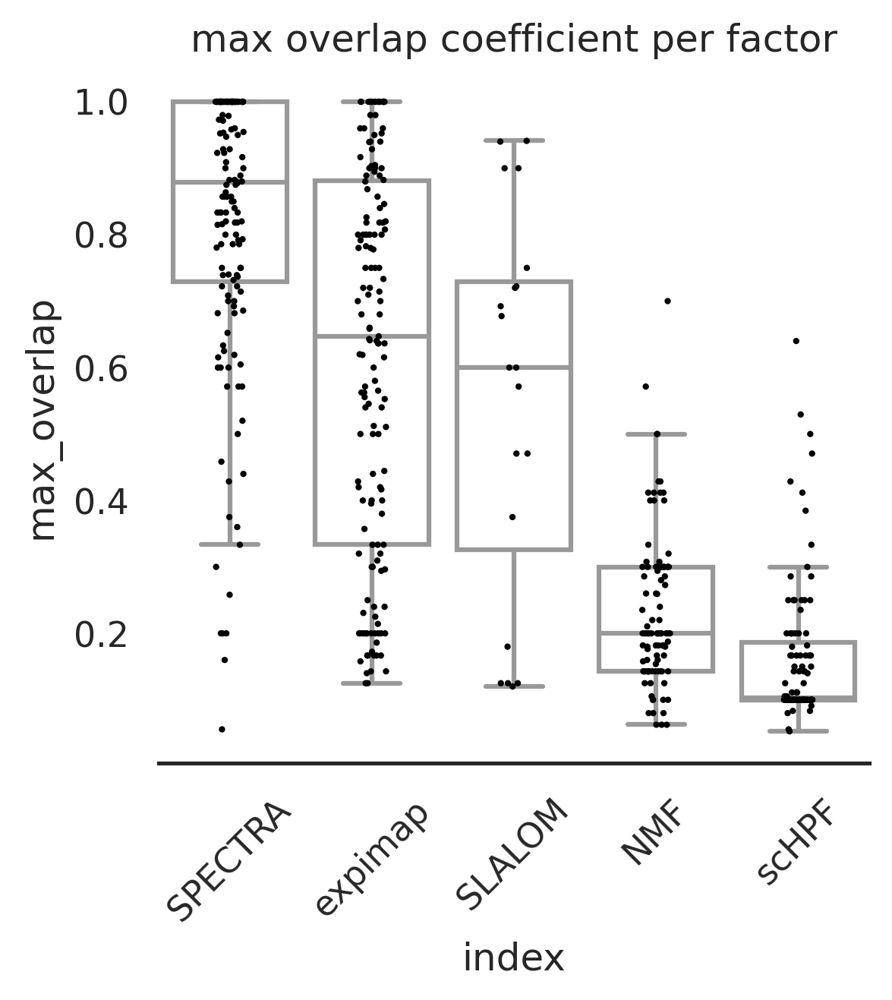

In [47]:
import seaborn as sns
save_name = 'SPECTRA_scHPF_NMF_SLALOM_expimap_overlap_newexpimap.svg'
sns.set_theme(style="white")
plt.set_ylim = (0,1)
# Draw a nested violinplot and split the violins for easier comparison
sns.boxplot(data = plotting_df, x='index', y=0,fliersize=0,color='#FFFFFF',order=['SPECTRA','expimap','SLALOM','NMF','scHPF'])
sns.stripplot(data = plotting_df, x='index', y=0,color='#000000', order=['SPECTRA','expimap','SLALOM','NMF','scHPF'], s=2)
sns.despine(left=True)
plt.ylabel('max_overlap')
plt.xticks(rotation=45)
plt.title('max overlap coefficient per factor')
plt.savefig(figure_save_path + save_name)
plotting_df.to_csv(source_save_path + save_name[:-3]+'_source_data.csv')
print(save_name)

# GSEA

## Tumor reactivity GSEA

In [162]:
factors_SPECTRA_all = ['0-X-all_multidrug-resistance', '1-X-all_porphyrine-heme_metabolism', '2-X-all_TNF-via-NFkB_signaling', '3-X-all_glyoxylate-dicarboxylate_metabolism', '4-X-all_IL6-JAK-STAT3_signaling', '5-X-5', '6-X-all_triacylglycerol_synthesis', '7-X-all_circadian-rhythm', '8-X-all_heparan-sulfate_degradation', '9-X-all_autophagy-of-mitochondria_regulation_positive', '10-X-all_type-II-ifn-response', '11-X-all_autophagy_regulation_positive', '12-X-all_DNA-demethylation', '13-X-all_TYR_metabolism', '14-X-all_autophagy-of-mitochondria', '15-X-all_autophagy-chaperone-mediated', '16-X-all_transmembrane-transport-golgi', '17-X-all_osmotic-stress-response', '18-X-all_o-glycan_synthesis', '19-X-all_transmembrane-transport-mitochondrial', '20-X-all_cytosolic-DNA-sensing_signaling', '21-X-all_mitophagy_regulation_positive', '22-X-all_posttranslation-modification', '23-X-leuko_transendothelial-migration', '24-X-all_autophagic-cell-death', '25-X-all_MHC-I-presentation', '26-X-all_histone-methylation', '27-X-all_G2M-transition', '28-X-28', '29-X-all_Beta-Ala_metabolism', '30-X-all_pterin_synthesis', '31-X-all_oxidative-phosphorylation', '32-X-all_creatinine_metabolism', '33-X-all_autophagy_regulation_positive', '34-X-all_NAD_metabolism', '35-X-all_wnt-beta-catenin-signaling', '36-X-36', '37-X-all_lipophagy', '38-X-all_CYS_metabolism', '39-X-all_glycerin-SER-THR_metabolism', '40-X-all_citric-acid-cycle', '41-X-all_ROS-detoxification', '42-X-all_NOD-like-receptor_signaling', '43-X-all_xenobiotics_metabolism', '44-X-44', '45-X-all_apoptosis', '46-X-all_oxidative-phosphorylation', '47-X-all_transmembrane-transport-lysosome', '48-X-all_bile-acid_synthesis', '49-X-all_peroxisome-component', '50-X-all_pyruvate_metabolism', '51-X-all_ros_response', '52-X-all_n-glycan_synthesis', '53-X-53', '54-X-all_urea-cycle', '55-X-all_type-I-ifn-response', '56-X-all_glycogenesis', '57-X-all_polyamines_metabolism', '58-X-all_fructose-mannose_metabolism', '59-X-all_thiamin_metabolism', '60-X-all_PI3K-AKT-mTOR_signaling', '61-X-all_fatty-acid-metabolism', '62-X-all_NOTCH_signaling', '63-X-all_purine_metabolism', '64-X-all_nucleotide_metabolism', '65-X-all_CoA_synthesis', '66-X-all_platelet-activation-factor_production', '67-X-all_ubiquinone_synthesis', '68-X-all_CYP_metabolism', '69-X-all_iron-uptake-and-storage', '70-X-all_chondroitine-and-heparan-sulfate_synthesis', '71-X-all_coagulation-factor_production', '72-X-all_VAL-LEU-ILE_metabolism', '73-X-all_glycogenolysis', '74-X-all_HIS_metabolism', '75-X-all_actin-cytoskeleton_regulation', '76-X-all_lactate_production', '77-X-all_SASP', '78-X-all_eicosanoid_metabolism', '79-X-all_riboflavin_metabolism', '80-X-leuko_ROS_production', '81-X-all_GPI-anchor_synthesis', '82-X-all_cholesterol_metabolism', '83-X-all_inositol-phosphate_metabolism', '84-X-all_unfolded-protein-response', '85-X-all_protein-degradation-proteasome', '86-X-all_retinol_metabolism', '87-X-all_cholesterol-homeostasis', '88-X-all_sphingolipid_metabolism', '89-X-all_transmembrane-transport-cellmembrane', '90-X-all_DNA-methylation', '91-X-all_pyrimidine_metabolism', '92-X-all_TLR_signaling', '93-X-all_ascorbate-uptake', '94-X-all_glycolysis', '95-X-all_TRP_metabolism', '96-X-all_fatty-acid-beta-oxidation-mitochondrial', '97-X-all_ARG-PRO_metabolism', '98-X-all_selenoamino-acid_metabolism', '99-X-all_galactose_metabolism', '100-X-all_JAK-STAT_signaling', '101-X-all_DNA_synthesis', '102-X-all_G1S-transition', '103-X-all_LYS_metabolism', '104-X-all_hyaluronan_metabolism', '105-X-all_GABA-shunt', '106-X-all_propanoate_metabolism', '107-X-all_GLU_metabolism', '108-X-all_exocytosis', '109-X-all_pyrimidine_synthesis', '110-X-all_fatty-acid_synthesis', '111-X-all_carnitine-shuttle', '112-X-all_DNA-repair', '113-X-all_biotin_metabolism', '114-X-all_cyclic-nucleotide_metabolism', '115-X-all_macroautophagy', '116-X-all_p53-signaling', '117-X-all_phosphoinositide_signaling', '118-X-118', '119-X-all_autophagy-nucleus', '120-X-all_glutathione_metabolism', '121-X-all_thrombolysis-factor_production', '122-X-all_ketone-body_metabolism', '123-X-all_nucleophagy-late', '124-X-124', '125-X-all_n-glycan_degradation', '126-X-all_autophagy-chaperone-mediated', '127-X-all_MHC-II-presentation', '128-X-all_transmembrane-transport-ER', '129-X-all_hypoxia-response', '130-X-all_TGFb_response', '131-X-all_n-glycan_degradation', '132-X-all_RIG-I-like-receptor_signaling', '133-X-all_amino-sugar-nucleotide-sugar_metabolism', '134-X-all_mitotic-spindle-component', '135-X-all_steroid_metabolism', '136-X-all_MYC_targets', '137-X-all_keratan-sulfate_synthesis', '138-X-all_hedgehog_signaling', '139-X-all_lipophagy', '140-X-all_pentose-phosphate-pathway', '141-X-all_mTORC1_signaling', '142-X-142', '143-X-all_pyroptosis', '144-X-all_purine_metabolism', '145-X-all_ethanol_metabolism', '146-X-all_taurine-hypotaurine_metabolism', '147-X-all_glycerophospholipid_metabolism', '148-X-all_complement_production', '149-X-all_folate_metabolism', '150-X-150', '151-X-151', '152-X-152', '153-X-B_Breg_UP', '154-X-B_effector-2_UP', '155-X-B_effector-1_UP', '156-X-B_IgM-ligation_response', '157-X-157', '158-X-158', '159-X-CD4-T_IL12_response', '160-X-TNK_IL2_response', '161-X-CD4-T_TH22_UP', '162-X-CD4-T_TH17_UP', '163-X-TNK_IL2-STAT5-signaling', '164-X-T_IL21_response', '165-X-CD4-T_TH9_UP', '166-X-CD4-T_TFH_UP', '167-X-CD4-T_IL4_response', '168-X-CD4-T_TH2_UP', '169-X-CD4-T_TH1_UP', '170-X-170', '171-X-CD8-T_tumor-reactive-like_UP', '172-X-CD8-T_terminal-exhaustion', '173-X-T_tcr-activation', '174-X-CD8-T_IL12_response', '175-X-TNK_PD-1_signaling', '176-X-TNK_cytotoxicity-effectors', '177-X-177', '178-X-178', '179-X-DC_LPS_response', '180-X-180', '181-X-181', '182-X-M_angiogenic-effectors', '183-X-Mac_LPS_response', '184-X-Mac_IL4-IL13_response', '185-X-Mac_CSF1_response', '186-X-Mac_IFNG_response', '187-X-187', '188-X-188', '189-X-Treg_FoxP3-stabilization', '190-X-190', '191-X-191', '192-X-mast_granule-exocytosis', '193-X-193', '194-X-p-DC_CpG-TLR9_response', '195-X-195', '196-X-196']

In [163]:
SPECTRA_marker_df = pd.read_csv(SPECTRA_markers,index_col=0) 
SPECTRA_marker_df = SPECTRA_marker_df.drop(columns = ['best_match','jaccard','cell_type','eta','eta_high'])
SPECTRA_marker_df.index = factors_SPECTRA_all
SPECTRA_marker_df = SPECTRA_marker_df.T
SPECTRA_marker_df

,0-X-all_multidrug-resistance,1-X-all_porphyrine-heme_metabolism,2-X-all_TNF-via-NFkB_signaling,3-X-all_glyoxylate-dicarboxylate_metabolism,4-X-all_IL6-JAK-STAT3_signaling,5-X-5,6-X-all_triacylglycerol_synthesis,7-X-all_circadian-rhythm,8-X-all_heparan-sulfate_degradation,9-X-all_autophagy-of-mitochondria_regulation_positive,...,187-X-187,188-X-188,189-X-Treg_FoxP3-stabilization,190-X-190,191-X-191,192-X-mast_granule-exocytosis,193-X-193,194-X-p-DC_CpG-TLR9_response,195-X-195,196-X-196
0,ABCC3,ALAS2,FOSB,GLO1,IL17RA,ACOX3,AGPAT3,NR1D1,SGSH,MUL1,...,SLC35A1,SLC35A1,SMAD3,SLC35A1,SLC35A1,VAMP8,SLC35A1,RNF145,TNFRSF9,SLC35A1
1,ABCC4,PPOX,NR4A1,HAGHL,PTPN1,EHHADH,AGPAT4,BHLHE41,NAGLU,CAMKK2,...,PPAT,PRDX3,ATF1,USP30,PRDX3,SNX4,RETREG2,HMGB2,ASS1,PRDX3
2,ABCC1,CYBRD1,NR4A3,GRHPR,REG1A,GEM,GPAT4,PER3,IDUA,FBXO7,...,UBE3D,AC103831.1,IL2RA,CYP11A1,AC103831.1,BTK,EGFR,OTULINL,ANKRD55,AC103831.1
3,ABCB4,FECH,F2RL1,HSPA8,IL18R1,DUSP4,MOGAT1,PER2,AC244197.3,ATP5IF1,...,RNF180,PBX1,CREB1,FBXO27,PBX1,VAMP7,PIGP,ZAP70,PLA2G4A,PBX1
4,HSD17B4,BLVRB,SIK1,HSP90AA1,PTPN2,NAMPT,AGPAT1,CRY1,IDS,PARK7,...,PPP4R2,LAG3,NFATC2,PTPN11,LAG3,SNAP23,HSPA4L,TCF7,DCP1A,LAG3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6392,SLC6A9,HTT,B3GNT8,HEYL,HTT,EMB,B3GNT8,AIF1,CH25H,B3GNT8,...,PDCD1LG2,HSD17B8,CUL1,NFATC1,HSD17B8,ITGAM,LYN,KIAA1109,ZAP70,HSD17B8
6393,AIF1,B3GNT8,CHDH,AMBRA1,EMB,AIF1,HPGDS,HTT,DBT,EGR1,...,CCL8,LINC02422,CHFR,TGFBR2,LINC02422,LAMTOR5,SNAP23,SEMA5A,ID2,LINC02422
6394,C1QB,CH25H,CH25H,CHST13,CH25H,HTT,ASRGL1,CH25H,TLR1,CHDH,...,PLCB2,SAC3D1,LINC02273,IL2RB,SAC3D1,YWHAB,SNX4,SUPT5H,HMGB2,SAC3D1
6395,FOSB,ST3GAL3,ACY3,AIF1,ST3GAL3,FOSB,EMB,ST3GAL3,ACY3,CH25H,...,OGFOD2,PI4K2A,CYB5D2,IL2RG,PI4K2A,RCHY1,VAMP8,DNAJC10,TCF7,PI4K2A


In [164]:
SLALOM_marker_df = pd.read_csv(SLALOM_markers,index_col=0) 
SLALOM_marker_df

,SLALOM_0,SLALOM_1,SLALOM_2,SLALOM_3,SLALOM_4,SLALOM_5,SLALOM_6,SLALOM_7,SLALOM_8,SLALOM_9,SLALOM_10,SLALOM_11,SLALOM_12,SLALOM_13,SLALOM_14,SLALOM_15,SLALOM_16,SLALOM_17,SLALOM_18,SLALOM_19
0,FTL,SLC35A1,HLA-B,CCNG2,S100A11,ISG15,CTSB,SLC35A1,STMN1,IGKC,CD74,GAPDH,TALDO1,CXCL13,CXCL13,CCL4,BATF,GNLY,THBS1,CLEC10A
1,CST3,AC103831.1,HLA-A,SLC35A1,GAPDH,IFI6,FTH1,LRAT,HMGB2,JCHAIN,HLA-DRA,PLIN2,TKT,TNFRSF18,PDCD1,CCL3,SH2D2A,CTSW,CXCL8,MRC1
2,HLA-DRA,LAG3,HLA-C,NOP16,LGALS1,LY6E,GLUL,PBX1,UBE2C,MZB1,HLA-DPA1,TPI1,PGD,ENTPD1,LAG3,CCL4L2,ITM2A,CD7,TYMP,IL13RA1
3,CD74,ITK,HLA-E,E2F2,GSTP1,MX1,TYROBP,LAG3,MKI67,SSR4,HLA-DRB1,ALDOA,PGLS,NOP16,ID2,EGR1,SLA,GZMB,ENG,CCL8
4,PSAP,PRNP,TAP1,TRIM63,YBX1,MT2A,CTSD,ITK,CKS2,XBP1,HLA-DPB1,MIF,G6PD,TRIM63,TOX,CCL3L1,LCP2,KLRD1,CCL2,CCL17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6392,RAC2,SLC25A1,LINC02422,CENPM,MTRF1,THRA,PFKP,RRM2,TSGA10,SLC3A1,AP2A2,RORA,THRA,GZMK,KCNC3,TNFSF8,IL10RB,LAMP1,PDGFB,ARG1
6393,CD2,SLC33A1,SAC3D1,SLBP,ACADSB,ATP2A2,ENO2,RRM1,MYL12B,PIPOX,AP2S1,CDKN1B,ATP2A2,GZMA,EOMES,LTA,NT5E,STXBP2,TGFB1,CDH1
6394,CD3D,PLOD3,PI4K2A,PCNA,SLC25A12,HSD17B8,GPI,SLC25A19,NCOR2,TMLHE,AP2B1,ETS1,HSD17B8,CCL4,NR4A3,CD40LG,PTPRO,LAMP2,SEMA4D,SOCS2
6395,BTG1,PLOD1,KCNC3,RRM2,SUPV3L1,KCNC3,TPI1,TYMS,CD160,AASS,AP2M1,CXCR4,LINC02422,NKG7,NR4A1,TNFRSF4,ANXA1,GZMA,PLAU,NR2F6


In [165]:
scHPF_marker_df = pd.read_csv(scHPF_markers,index_col=0) 
scHPF_marker_df

,scHPF_0,scHPF_1,scHPF_2,scHPF_3,scHPF_4,scHPF_5,scHPF_6,scHPF_7,scHPF_8,scHPF_9,...,scHPF_90,scHPF_91,scHPF_92,scHPF_93,scHPF_94,scHPF_95,scHPF_96,scHPF_97,scHPF_98,scHPF_99
0,AOC2,SH3TC2,PHKG1,SLC2A4,S100A12,CGA,AC010680.3,RAB3B,TPSAB1,NUPR2,...,SLC3A1,PRSS2,PTGDS,CCL18,CLGN,LINC00461,IFIT1,SLC2A4,ANKRD30A,AKR1B15
1,SLC2A4,SLC2A4,MAPK10,NGF,CD1B,DRAIC,LRP1B,GPT2,TPSB2,CLDN8,...,DCDC2,SLC17A3,LILRA4,C1QC,NKD2,INSM1,IFIT3,NGF,CHGB,UGT2B11
2,NGF,NGF,CHST1,SLC7A10,FCN1,ASB2,SLC2A4,BCAR3,CPA3,AP000350.6,...,PDE4C,LIPG,LRRC26,CCL13,OTX1,SLC2A4,RSAD2,SLC7A10,TFF1,UGT2B28
3,SLC7A10,SLC7A10,CA1,SLC6A4,LGALS2,RAB15,NGF,FOXP2,MS4A2,LGALS7B,...,BMP4,SLC2A4,DNASE1L3,ADAMDEC1,FAM69B,NGF,CMPK2,SLC6A4,TBX3,SYT8
4,SLC6A4,SLC6A4,GLRA3,THEM5,CDA,PTTG1,SLC7A10,C16orf74,GATA2,AC069277.1,...,AC096586.1,NGF,SCT,C1QB,LINC00309,SLC7A10,IFIT2,THEM5,TFF3,IL20RA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6392,TPT1,TPT1,TPT1,TPT1,LTB,CD69,TPT1,HLA-DRA,CD3D,TPT1,...,HLA-DRB5,TPT1,ZFP36L1,CD69,TPT1,TPT1,CCL5,TPT1,HLA-DRB5,PSME1
6393,HLA-B,HLA-B,HLA-B,HLA-B,ISG20,NKG7,HLA-B,MT2A,LTB,HLA-B,...,CCL4,HLA-B,TXNIP,LTB,HLA-B,HLA-B,TSC22D3,HLA-B,CCL4,ATP5MC2
6394,ACTB,ACTB,ACTB,ACTB,CD3D,CCL4,ACTB,HLA-DRB1,LSP1,ACTB,...,HLA-DRA,ACTB,JUN,CD2,ACTB,ACTB,DUSP1,ACTB,CCL5,CCL5
6395,TMSB4X,TMSB4X,TMSB4X,TMSB4X,CCL5,CCL5,TMSB4X,CCL5,CCL5,TMSB4X,...,HLA-DRB1,TMSB4X,CCL5,ISG20,TMSB4X,TMSB4X,FOS,TMSB4X,DUSP1,RAC2


In [166]:
SPECTRA_marker_df

,0-X-all_multidrug-resistance,1-X-all_porphyrine-heme_metabolism,2-X-all_TNF-via-NFkB_signaling,3-X-all_glyoxylate-dicarboxylate_metabolism,4-X-all_IL6-JAK-STAT3_signaling,5-X-5,6-X-all_triacylglycerol_synthesis,7-X-all_circadian-rhythm,8-X-all_heparan-sulfate_degradation,9-X-all_autophagy-of-mitochondria_regulation_positive,...,187-X-187,188-X-188,189-X-Treg_FoxP3-stabilization,190-X-190,191-X-191,192-X-mast_granule-exocytosis,193-X-193,194-X-p-DC_CpG-TLR9_response,195-X-195,196-X-196
0,ABCC3,ALAS2,FOSB,GLO1,IL17RA,ACOX3,AGPAT3,NR1D1,SGSH,MUL1,...,SLC35A1,SLC35A1,SMAD3,SLC35A1,SLC35A1,VAMP8,SLC35A1,RNF145,TNFRSF9,SLC35A1
1,ABCC4,PPOX,NR4A1,HAGHL,PTPN1,EHHADH,AGPAT4,BHLHE41,NAGLU,CAMKK2,...,PPAT,PRDX3,ATF1,USP30,PRDX3,SNX4,RETREG2,HMGB2,ASS1,PRDX3
2,ABCC1,CYBRD1,NR4A3,GRHPR,REG1A,GEM,GPAT4,PER3,IDUA,FBXO7,...,UBE3D,AC103831.1,IL2RA,CYP11A1,AC103831.1,BTK,EGFR,OTULINL,ANKRD55,AC103831.1
3,ABCB4,FECH,F2RL1,HSPA8,IL18R1,DUSP4,MOGAT1,PER2,AC244197.3,ATP5IF1,...,RNF180,PBX1,CREB1,FBXO27,PBX1,VAMP7,PIGP,ZAP70,PLA2G4A,PBX1
4,HSD17B4,BLVRB,SIK1,HSP90AA1,PTPN2,NAMPT,AGPAT1,CRY1,IDS,PARK7,...,PPP4R2,LAG3,NFATC2,PTPN11,LAG3,SNAP23,HSPA4L,TCF7,DCP1A,LAG3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6392,SLC6A9,HTT,B3GNT8,HEYL,HTT,EMB,B3GNT8,AIF1,CH25H,B3GNT8,...,PDCD1LG2,HSD17B8,CUL1,NFATC1,HSD17B8,ITGAM,LYN,KIAA1109,ZAP70,HSD17B8
6393,AIF1,B3GNT8,CHDH,AMBRA1,EMB,AIF1,HPGDS,HTT,DBT,EGR1,...,CCL8,LINC02422,CHFR,TGFBR2,LINC02422,LAMTOR5,SNAP23,SEMA5A,ID2,LINC02422
6394,C1QB,CH25H,CH25H,CHST13,CH25H,HTT,ASRGL1,CH25H,TLR1,CHDH,...,PLCB2,SAC3D1,LINC02273,IL2RB,SAC3D1,YWHAB,SNX4,SUPT5H,HMGB2,SAC3D1
6395,FOSB,ST3GAL3,ACY3,AIF1,ST3GAL3,FOSB,EMB,ST3GAL3,ACY3,CH25H,...,OGFOD2,PI4K2A,CYB5D2,IL2RG,PI4K2A,RCHY1,VAMP8,DNAJC10,TCF7,PI4K2A


In [50]:
#get background markers (identical to Spectra preprocessing)
adata = adata_SPECTRA
hv =3000

adata.var['ighm'] = adata.var_names.str.startswith('IGHM')
adata.var['iglc'] = adata.var_names.str.startswith('IGLC')
adata.var['ighg'] = adata.var_names.str.startswith('IGHG')
adata.var['igha'] = adata.var_names.str.startswith('IGHA')
adata.var['ighv'] = adata.var_names.str.startswith('IGHV')
adata.var['iglv'] = adata.var_names.str.startswith('IGLV')
adata.var['igkv'] = adata.var_names.str.startswith('IGKV')
adata.var['trbv'] = adata.var_names.str.startswith('TRBV')
adata.var['trav'] = adata.var_names.str.startswith('TRAV')
adata.var['trgv'] = adata.var_names.str.startswith('TRGV')
adata.var['trdv'] = adata.var_names.str.startswith('TRDV')
adata.var['hb'] = adata.var_names.str.startswith('HB')
adata = adata[:,~(adata.var['hb']|adata.var['ighm']|adata.var['iglc']|adata.var['ighg']|adata.var['igha']|adata.var['ighv']|adata.var['trgv']|adata.var['trdv']|adata.var['iglv']|adata.var['igkv']|adata.var['trav']|adata.var['trbv'])]  
sc.pp.highly_variable_genes(adata, n_top_genes = hv, flavor = "cell_ranger")

#remove genes that don't appear in the data
gene_lst = adata.var.index
remove = []
genes = []
for gene_name in input_df["g.name"]:
    if gene_name not in gene_lst:
        input_df = input_df[input_df["g.name"] != gene_name]
full_genes = list(input_df["g.name"])
bools = []
for name in adata.var.index:
    if name in full_genes:
        bools.append(True)
    else:
        bools.append(False)
bools = np.array(bools)
adata2 = adata[:,adata.var.highly_variable.values|bools]

vocab = list(adata2.var_names)

/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


In [51]:
vocab

['KCNC3',
 'NDUFS3',
 'HACD1',
 'FAM214A',
 'TBCD',
 'AC124312.1',
 'PLAGL2',
 'CD40LG',
 'AC022182.1',
 'USP53',
 'SPOP',
 'PILRA',
 'LTBP1',
 'COX10',
 'SLC16A1',
 'STEAP3',
 'CRYBA4',
 'GRAMD1C',
 'LIMK2',
 'CES1',
 'KLHL42',
 'AZI2',
 'CD79B',
 'IGFL2',
 'ALDH1B1',
 'CRYZ',
 'ST6GALNAC6',
 'PAX5',
 'AC025171.3',
 'KCNJ3',
 'ATF6',
 'FABP4',
 'NFATC2',
 'PKP1',
 'HGF',
 'UBQLN4',
 'KIAA0513',
 'RORA',
 'FYCO1',
 'MFAP4',
 'PREB',
 'CDC25B',
 'CHDH',
 'TRDMT1',
 'SYNJ2',
 'TAL1',
 'PIGF',
 'ABCA10',
 'ADAR',
 'MHENCR',
 'PGAM5',
 'LAMTOR1',
 'TUBA1A',
 'ESR2',
 'CLIC3',
 'GALNT10',
 'WDR45',
 'GAS6',
 'SYP',
 'AL603756.1',
 'MBNL2',
 'RBBP4',
 'DGKZ',
 'TNFSF9',
 'AP1B1',
 'CRTAM',
 'ACSS1',
 'PTRH2',
 'ECHDC2',
 'TNNC2',
 'DNAJB2',
 'CCDC66',
 'SCAI',
 'FEM1A',
 'FCGRT',
 'AC020916.1',
 'IFNG',
 'PGS1',
 'CPS1',
 'ST3GAL5',
 'ACADM',
 'FAM30A',
 'RASAL2',
 'TATDN2',
 'IGF1R',
 'CNTF',
 'WFDC2',
 'ATP5MF',
 'EPSTI1',
 'CD81',
 'KMT2E',
 'ZNF808',
 'H2AFX',
 'NBEAL2',
 'FCGR2A',
 'FAP

In [ ]:
#enrich gs for SPECTRA
#factor_dict = adata_SPECTRA.uns['SPADE_markers_specific']['CD8_T'] | adata_SPECTRA.uns['SPADE_markers_global']
factor_dict = SPECTRA_marker_df.to_dict(orient='list')
#restrict to spec number of makers 
factor_dict = {k:v[0:50] for k,v in factor_dict.items()}
#gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec[input_spec['c.name']=='CD8_T']['gs.name'])
gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec['gs.name'])

all_gs = {}
for i in set(input_df['gs.name']):
    if i in gene_sets_of_interest:
        all_gs[i]= list(input_df[input_df['gs.name']==i]['g.name'])


enr_df_SPECTRA,enr_dict_SPECTRA = enrich_factors(all_gs, factor_dict, background=6398)

In [169]:
enr_df_SPECTRA

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Genes,factor
0,CUSTOM47915677506432,CD8-T_IL12_response,2/146,0.316697,0.438504,2.199958,PI4K2A;RAE1,0-X-all_multidrug-resistance
1,CUSTOM47915677506432,TNK_IL2-STAT5-signaling,1/195,0.788530,0.790234,0.961559,CD44,0-X-all_multidrug-resistance
2,CUSTOM47915677506432,all_DNA-repair,3/150,0.111725,0.223450,3.059241,BCAP31;RAE1;GTF2H1,0-X-all_multidrug-resistance
3,CUSTOM47915677506432,all_G1S-transition,1/20,0.145422,0.249294,9.428677,CDKN2D,0-X-all_multidrug-resistance
4,CUSTOM47915677506432,all_IL6-JAK-STAT3_signaling,1/85,0.488963,0.533414,2.237640,CD44,0-X-all_multidrug-resistance
...,...,...,...,...,...,...,...,...
35,CUSTOM47915677506432,all_ros_response,1/49,0.320156,0.572585,3.887052,PRNP,196-X-196
36,CUSTOM47915677506432,all_transmembrane-transport-cellmembrane,1/49,0.320156,0.572585,3.887052,SLC26A7,196-X-196
37,CUSTOM47915677506432,all_transmembrane-transport-golgi,1/10,0.075509,0.468065,18.437229,SLC35A1,196-X-196
38,CUSTOM47915677506432,all_unfolded-protein-response,2/108,0.206364,0.485562,2.988503,ATF3;XBP1,196-X-196


In [ ]:
#enrich gs for SPECTRA
#factor_dict = adata_SPECTRA.uns['SPADE_markers_specific']['CD8_T'] | adata_SPECTRA.uns['SPADE_markers_global']
factor_dict = SPECTRA_marker_df.to_dict(orient='list')
#restrict to spec number of makers 
factor_dict = {k:v[0:50] for k,v in factor_dict.items()}
#gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec[input_spec['c.name']=='CD8_T']['gs.name'])
gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec['gs.name'])

all_gs = {}
for i in set(input_df['gs.name']):
    if i in gene_sets_of_interest:
        all_gs[i]= list(input_df[input_df['gs.name']==i]['g.name'])


enr_df_SPECTRA,enr_dict_SPECTRA = enrich_factors(all_gs, factor_dict, background=vocab)

In [171]:
enr_df_SPECTRA

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Genes,factor
0,CUSTOM47915692348928,CD8-T_IL12_response,2/146,0.316763,0.438595,2.199606,PI4K2A;RAE1,0-X-all_multidrug-resistance
1,CUSTOM47915692348928,TNK_IL2-STAT5-signaling,1/195,0.788582,0.790286,0.961404,CD44,0-X-all_multidrug-resistance
2,CUSTOM47915692348928,all_DNA-repair,3/150,0.111764,0.223528,3.058752,BCAP31;RAE1;GTF2H1,0-X-all_multidrug-resistance
3,CUSTOM47915692348928,all_G1S-transition,1/20,0.145443,0.249331,9.427199,CDKN2D,0-X-all_multidrug-resistance
4,CUSTOM47915692348928,all_IL6-JAK-STAT3_signaling,1/85,0.489017,0.533473,2.237285,CD44,0-X-all_multidrug-resistance
...,...,...,...,...,...,...,...,...
35,CUSTOM47915692348928,all_ros_response,1/49,0.320197,0.572647,3.886440,PRNP,196-X-196
36,CUSTOM47915692348928,all_transmembrane-transport-cellmembrane,1/49,0.320197,0.572647,3.886440,SLC26A7,196-X-196
37,CUSTOM47915692348928,all_transmembrane-transport-golgi,1/10,0.075520,0.468133,18.434343,SLC35A1,196-X-196
38,CUSTOM47915692348928,all_unfolded-protein-response,2/108,0.206412,0.485676,2.988028,ATF3;XBP1,196-X-196


#enrich gs for SPECTRA
factor_dict = adata_SPECTRA.uns['SPADE_markers_specific']['CD8_T'] | adata_SPECTRA.uns['SPADE_markers_global']
gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec[input_spec['c.name']=='CD8_T']['gs.name'])

all_gs = {}
for i in set(input_df['gs.name']):
    if i in gene_sets_of_interest:
        all_gs[i]= list(input_df[input_df['gs.name']==i]['g.name'])


enr_df_SPECTRA,enr_dict_SPECTRA = enrich_factors(all_gs, factor_dict, background=6398)

In [ ]:
#enrich gs for scHPF
#factor_dict = adata_scHPF.uns['SPADE_markers_specific']['CD8_T'] | adata_scHPF.uns['SPADE_markers_global']
factor_dict = scHPF_marker_df.to_dict(orient='list')
#gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec[input_spec['c.name']=='CD8_T']['gs.name'])
gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec['gs.name'])
#restrict to spec number of makers 
factor_dict = {k:v[0:50] for k,v in factor_dict.items()}

all_gs = {}
for i in set(input_df['gs.name']):
    if i in gene_sets_of_interest:
        all_gs[i]= list(input_df[input_df['gs.name']==i]['g.name'])


enr_df_scHPF,enr_dict_scHPF = enrich_factors(all_gs, factor_dict, background=vocab)

In [ ]:
#enrich gs for SLALOM
#factor_dict = adata_SLALOM.uns['SPADE_markers_specific']['CD8_T'] | adata_SLALOM.uns['SPADE_markers_global']
factor_dict = SLALOM_marker_df.to_dict(orient='list')
#gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec[input_spec['c.name']=='CD8_T']['gs.name'])
gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec['gs.name'])

#restrict to spec number of makers 
factor_dict = {k:v[0:50] for k,v in factor_dict.items()}

all_gs = {}
for i in set(input_df['gs.name']):
    if i in gene_sets_of_interest:
        all_gs[i]= list(input_df[input_df['gs.name']==i]['g.name'])


enr_df_SLALOM,enr_dict_SLALOM = enrich_factors(all_gs, factor_dict, background=vocab)

In [174]:
enr_df_SPECTRA

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Genes,factor
0,CUSTOM47915692348928,CD8-T_IL12_response,2/146,0.316763,0.438595,2.199606,PI4K2A;RAE1,0-X-all_multidrug-resistance
1,CUSTOM47915692348928,TNK_IL2-STAT5-signaling,1/195,0.788582,0.790286,0.961404,CD44,0-X-all_multidrug-resistance
2,CUSTOM47915692348928,all_DNA-repair,3/150,0.111764,0.223528,3.058752,BCAP31;RAE1;GTF2H1,0-X-all_multidrug-resistance
3,CUSTOM47915692348928,all_G1S-transition,1/20,0.145443,0.249331,9.427199,CDKN2D,0-X-all_multidrug-resistance
4,CUSTOM47915692348928,all_IL6-JAK-STAT3_signaling,1/85,0.489017,0.533473,2.237285,CD44,0-X-all_multidrug-resistance
...,...,...,...,...,...,...,...,...
35,CUSTOM47915692348928,all_ros_response,1/49,0.320197,0.572647,3.886440,PRNP,196-X-196
36,CUSTOM47915692348928,all_transmembrane-transport-cellmembrane,1/49,0.320197,0.572647,3.886440,SLC26A7,196-X-196
37,CUSTOM47915692348928,all_transmembrane-transport-golgi,1/10,0.075520,0.468133,18.434343,SLC35A1,196-X-196
38,CUSTOM47915692348928,all_unfolded-protein-response,2/108,0.206412,0.485676,2.988028,ATF3;XBP1,196-X-196


In [175]:
#prepare data for plotting (SPECTRA)
factors_of_interest = ['CD8-T_tumor-reactive-like_UP', 'CD8-T_terminal-exhaustion']
enr_df_factor_sub = enr_df_SPECTRA[enr_df_SPECTRA['Term'].isin(factors_of_interest)]#[['Odds Ratio','Adjusted P-value']]

enr_df_factor_plot = pd.DataFrame()

for i in set(enr_df_factor_sub['factor']):
    enr_df_factor_sub_fac = enr_df_factor_sub[enr_df_factor_sub['factor']==i].set_index('Term')
    if 'CD8-T_terminal-exhaustion' in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP' not in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Odds Ratio']
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = 1
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = 1
    elif 'CD8-T_terminal-exhaustion' not in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] =1
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = 1
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Odds Ratio']
    elif 'CD8-T_terminal-exhaustion' in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] =enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Odds Ratio']   
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Odds Ratio']   
    else:
        print('skipping',i)

enr_df_factor_plot_SPECTRA = enr_df_factor_plot

In [176]:
#prepare data for plotting (scHPF)
factors_of_interest = ['CD8-T_tumor-reactive-like_UP', 'CD8-T_terminal-exhaustion']
enr_df_factor_sub = enr_df_scHPF[enr_df_scHPF['Term'].isin(factors_of_interest)]#[['Odds Ratio','Adjusted P-value']]

enr_df_factor_plot = pd.DataFrame()

for i in set(enr_df_factor_sub['factor']):
    enr_df_factor_sub_fac = enr_df_factor_sub[enr_df_factor_sub['factor']==i].set_index('Term')
    if 'CD8-T_terminal-exhaustion' in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP' not in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Odds Ratio']
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = 1
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = 1
    elif 'CD8-T_terminal-exhaustion' not in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] =1
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = 1
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Odds Ratio']
    elif 'CD8-T_terminal-exhaustion' in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] =enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Odds Ratio']   
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Odds Ratio']   
    else:
        print('skipping',i)

enr_df_factor_plot_scHPF = enr_df_factor_plot

In [177]:
#prepare data for plotting (SLALOM)
factors_of_interest = ['CD8-T_tumor-reactive-like_UP', 'CD8-T_terminal-exhaustion']
enr_df_factor_sub = enr_df_SLALOM[enr_df_SLALOM['Term'].isin(factors_of_interest)]#[['Odds Ratio','Adjusted P-value']]

enr_df_factor_plot = pd.DataFrame()

for i in set(enr_df_factor_sub['factor']):
    enr_df_factor_sub_fac = enr_df_factor_sub[enr_df_factor_sub['factor']==i].set_index('Term')
    if 'CD8-T_terminal-exhaustion' in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP' not in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Odds Ratio']
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = 1
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = 1
    elif 'CD8-T_terminal-exhaustion' not in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] =1
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = 1
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Odds Ratio']
    elif 'CD8-T_terminal-exhaustion' in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] =enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Odds Ratio']   
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Odds Ratio']   
    else:
        print('skipping',i)

enr_df_factor_plot_SLALOM = enr_df_factor_plot

In [178]:
#merge for plotting
enr_df_factor_plot_scHPF['method'] = len(enr_df_factor_plot_scHPF)*['scHPF']
enr_df_factor_plot_SPECTRA['method'] = len(enr_df_factor_plot_SPECTRA)*['SPECTRA']
enr_df_factor_plot_SLALOM['method'] = len(enr_df_factor_plot_SLALOM)*['SLALOM']

enr_df_factor_plot_merge = pd.concat([enr_df_factor_plot_SLALOM,enr_df_factor_plot_scHPF, enr_df_factor_plot_SPECTRA])
enr_df_factor_plot_merge['tumor_reac_10log(1/pval)'] = enr_df_factor_plot_merge['CD8-T_tumor-reactive-like_UP_p'].apply(lambda x: math.log(1/x, 10))
enr_df_factor_plot_merge['exhaust_10log(1/pval)'] = enr_df_factor_plot_merge['CD8-T_terminal-exhaustion_p'].apply(lambda x: math.log(1/x, 10))

In [ ]:
import seaborn as sns
sns.set_theme(style="white")
save_name = 'Bassez_tumorreac_exhaustion_GSEA_factors_SLALOM.svg'

sns.relplot(x="exhaust_10log(1/pval)", y="tumor_reac_10log(1/pval)", hue="method", s=200,
            alpha=0.5,palette=['#9d00b9'],
            height=6, data=enr_df_factor_plot_merge[enr_df_factor_plot_merge['method']=='SLALOM'])
plt.xlim(-2,25)
plt.ylim(-2,25)
plt.savefig(figure_save_path + save_name)

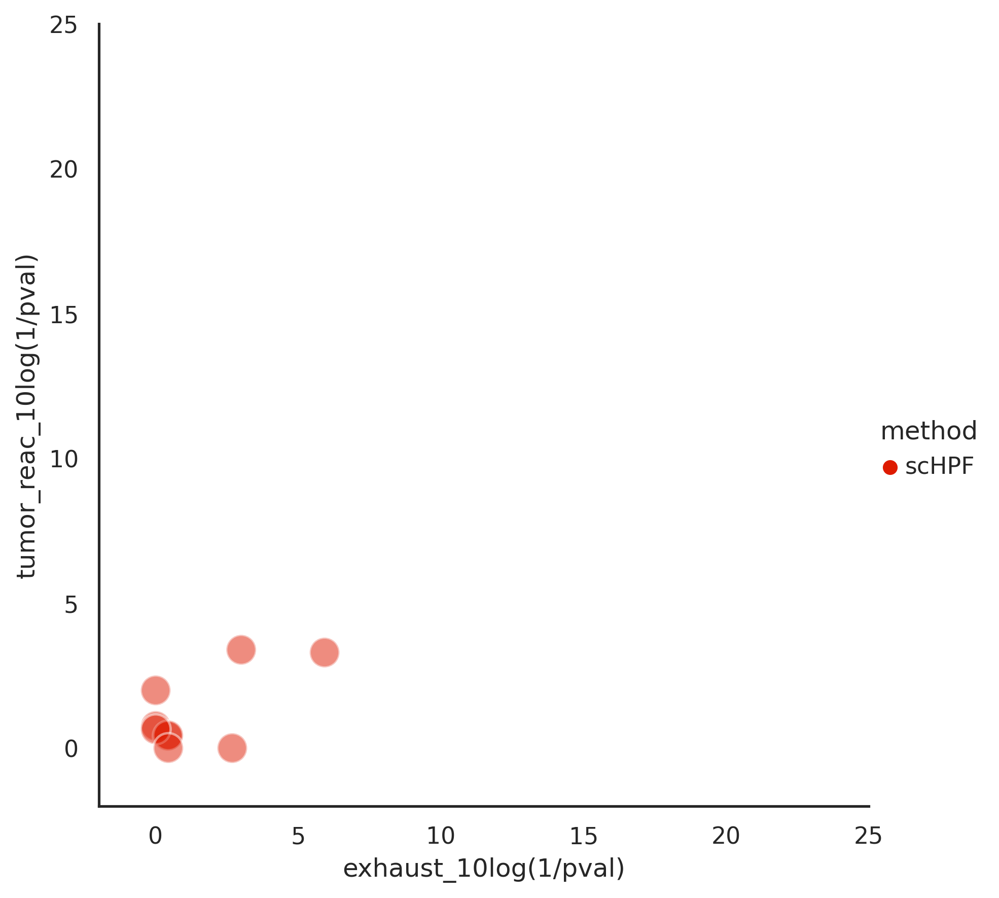

In [204]:
import seaborn as sns
sns.set_theme(style="white")
save_name = 'Bassez_tumorreac_exhaustion_GSEA_factors_scHPF.svg'

# Plot miles per gallon against horsepower with other semantics
sns.relplot(x="exhaust_10log(1/pval)", y="tumor_reac_10log(1/pval)", hue="method", s=200,
            alpha=.5,palette=['#de1b00'],
            height=6, data=enr_df_factor_plot_merge[enr_df_factor_plot_merge['method']=='scHPF'])
plt.xlim(-2,25)
plt.ylim(-2,25)
plt.savefig(figure_save_path + save_name)

## scHPF on CD8 subset

This scHPF model was trained only on the the CD8 T cells

In [42]:
adata_scHPF_CD8_path = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_scHPF_CD8.h5ad'
word2id_path = '/data/peer/wallet/Jupyter/SPADE_Peer_validation/data/word2id_CD8_scHPF.csv'

In [43]:
word2id_df = pd.read_csv(word2id_path).T
id2word = dict(zip([int(x) for x in list(word2id_df[1][1:])],list(word2id_df[0][1:])))
id2word

{0: 'KCNC3',
 1: 'NDUFS3',
 2: 'HACD1',
 3: 'FAM214A',
 4: 'TBCD',
 5: 'AC124312.1',
 6: 'PLAGL2',
 7: 'CD40LG',
 8: 'AC022182.1',
 9: 'USP53',
 10: 'SPOP',
 11: 'PILRA',
 12: 'LTBP1',
 13: 'COX10',
 14: 'SLC16A1',
 15: 'STEAP3',
 16: 'CRYBA4',
 17: 'GRAMD1C',
 18: 'LIMK2',
 19: 'CES1',
 20: 'KLHL42',
 21: 'AZI2',
 22: 'CD79B',
 23: 'IGFL2',
 24: 'ALDH1B1',
 25: 'CRYZ',
 26: 'ST6GALNAC6',
 27: 'PAX5',
 28: 'AC025171.3',
 29: 'KCNJ3',
 30: 'ATF6',
 31: 'FABP4',
 32: 'NFATC2',
 33: 'PKP1',
 34: 'HGF',
 35: 'UBQLN4',
 36: 'KIAA0513',
 37: 'RORA',
 38: 'FYCO1',
 39: 'MFAP4',
 40: 'PREB',
 41: 'CDC25B',
 42: 'CHDH',
 43: 'TRDMT1',
 44: 'SYNJ2',
 45: 'TAL1',
 46: 'PIGF',
 47: 'ABCA10',
 48: 'ADAR',
 49: 'MHENCR',
 50: 'PGAM5',
 51: 'LAMTOR1',
 52: 'TUBA1A',
 53: 'ESR2',
 54: 'CLIC3',
 55: 'GALNT10',
 56: 'WDR45',
 57: 'GAS6',
 58: 'SYP',
 59: 'AL603756.1',
 60: 'MBNL2',
 61: 'RBBP4',
 62: 'DGKZ',
 63: 'TNFSF9',
 64: 'AP1B1',
 65: 'CRTAM',
 66: 'ACSS1',
 67: 'PTRH2',
 68: 'ECHDC2',
 69: 'TNNC

In [52]:
vocab = list(id2word.values())

In [20]:
adata_scHPF_CD8 = sc.read(adata_scHPF_CD8_path)
adata_scHPF_CD8

Only considering the two last: ['.0_50PC_reembedded_scHPF_CD8', '.h5ad'].
Only considering the two last: ['.0_50PC_reembedded_scHPF_CD8', '.h5ad'].


AnnData object with n_obs × n_vars = 31925 × 19984
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k2

In [ ]:
#calculate overlap coefficients for each factor vs every input gene set

overlap_df_scHPF_CD8 = pd.DataFrame()

for i in ['scHPF_' + str(x) for x in range(100)]:
    for j in set(input_df['gs.name']):
        set_a = set(input_df[input_df['gs.name']==j]['g.name'])
        set_b = set(adata_scHPF_CD8.uns['scHPF_markers_global'][i])
        min_len = min([len(set_a),len(set_b)])
        intersect = set_a.intersection(set_b)
        overlap_coeff = len(intersect)/min_len
        overlap_df_scHPF_CD8.loc[i,j] = overlap_coeff
overlap_df_scHPF_CD8

In [33]:
#transform marker genes into an array
#restrict to top 50 markers like for Spectra
scHPF_CD8_factors =[ 'scHPF_0', 'scHPF_1', 'scHPF_2', 'scHPF_3', 'scHPF_4', 'scHPF_5', 'scHPF_6', 'scHPF_7', 'scHPF_8', 'scHPF_9', 'scHPF_10', 'scHPF_11', 'scHPF_12', 'scHPF_13', 'scHPF_14', 'scHPF_15', 'scHPF_16', 'scHPF_17', 'scHPF_18', 'scHPF_19', 'scHPF_20', 'scHPF_21', 'scHPF_22', 'scHPF_23', 'scHPF_24', 'scHPF_25', 'scHPF_26', 'scHPF_27', 'scHPF_28', 'scHPF_29', 'scHPF_30', 'scHPF_31', 'scHPF_32', 'scHPF_33', 'scHPF_34', 'scHPF_35', 'scHPF_36', 'scHPF_37', 'scHPF_38', 'scHPF_39', 'scHPF_40', 'scHPF_41', 'scHPF_42', 'scHPF_43', 'scHPF_44', 'scHPF_45', 'scHPF_46', 'scHPF_47', 'scHPF_48', 'scHPF_49', 'scHPF_50', 'scHPF_51', 'scHPF_52', 'scHPF_53', 'scHPF_54', 'scHPF_55', 'scHPF_56', 'scHPF_57', 'scHPF_58', 'scHPF_59', 'scHPF_60', 'scHPF_61', 'scHPF_62', 'scHPF_63', 'scHPF_64', 'scHPF_65', 'scHPF_66', 'scHPF_67', 'scHPF_68', 'scHPF_69', 'scHPF_70', 'scHPF_71', 'scHPF_72', 'scHPF_73', 'scHPF_74', 'scHPF_75', 'scHPF_76', 'scHPF_77', 'scHPF_78', 'scHPF_79', 'scHPF_80', 'scHPF_81', 'scHPF_82', 'scHPF_83', 'scHPF_84', 'scHPF_85', 'scHPF_86', 'scHPF_87', 'scHPF_88', 'scHPF_89', 'scHPF_90', 'scHPF_91', 'scHPF_92', 'scHPF_93', 'scHPF_94', 'scHPF_95', 'scHPF_96', 'scHPF_97', 'scHPF_98', 'scHPF_99']
factor_list = []
for i in scHPF_CD8_factors:
    factor_list.append(list(adata_scHPF_CD8.uns['scHPF_markers_global'][i])[0:50])
                       
adata_scHPF_CD8.uns['scHPF_markers_global'] = factor_list #np.array(factor_list)

In [39]:
scHPF_CD8_marker_df = pd.DataFrame(adata_scHPF_CD8.uns['scHPF_markers_global']).T
scHPF_CD8_marker_df.columns= scHPF_CD8_factors
scHPF_CD8_marker_df

,scHPF_0,scHPF_1,scHPF_2,scHPF_3,scHPF_4,scHPF_5,scHPF_6,scHPF_7,scHPF_8,scHPF_9,...,scHPF_90,scHPF_91,scHPF_92,scHPF_93,scHPF_94,scHPF_95,scHPF_96,scHPF_97,scHPF_98,scHPF_99
0,RCAN2,KIR3DL3,MSMB,SYP,AC016831.5,NPW,PGAM2,AL359504.2,CELSR1,TCIM,...,AL035701.1,HRASLS2,AC005332.3,AC233755.1,VSIG4,SLC25A37,SELL,MTRNR2L10,HSPA1A,UST
1,SELP,CDA,FANK1,AC108860.2,HHEX,PDCD1LG2,AMPD1,LAD1,CNN1,PALMD,...,ARAP3,EHHADH,KMO,WNT10B,DYSF,SPAG4,C12orf42,BEX5,HSPA1B,LEPR
2,CD19,FGD1,SLCO2A1,SLC24A4,CSF2RB,SLCO4A1,REG1A,AC005618.1,LILRB5,CLEC14A,...,PDE9A,CD86,SDR16C5,FAM13C,CLEC11A,CPLX1,CDHR3,GCSAM,HIF1A-AS2,WNT1
3,KLHL14,OLIG2,SLC12A3,CLDN14,IL20RA,MT3,GACAT2,OPRPN,UNC13C,PILRA,...,ESM1,EGFL6,CXCL1,KLK6,ARHGEF4,RASEF,PRRT2,SNORC,TREM2,FGFR2
4,GDF7,GALNT13,APC2,OBP2A,ARHGAP24,CENPM,GALNT13,CYP39A1,FOXC2,ACKR3,...,SNX22,ITGB8,EMX2,C4B,MOXD1,CHAC1,ANKRD55,MRAS,CLEC7A,ME1
5,AL161781.2,OBP2A,GALNT13,AC103831.1,MS4A2,PSPH,OBP2A,AL080317.2,IGLL1,APLNR,...,CHGB,TNFRSF11B,CNR1,IGLJ3,LY86,NCCRP1,AC119396.1,FBXL22,STS,ZNF831
6,CLEC17A,AC103831.1,OBP2A,AC134981.1,HK3,OXCT2,MYT1,KRT1,CRLF2,TNK1,...,METTL24,CSF2,GALNT13,AMPD1,FOLR2,TLR2,AC020911.2,PFKFB2,BCAR3,CCR6
7,IL27,AC134981.1,AC103831.1,AC133065.1,MUM1L1,BUB1,AC103831.1,LINC01607,AC053513.1,NKX3-1,...,TSPAN6,CLNK,OBP2A,REG1A,DGAT2,ALAS2,CPA5,OCRL,HK2,PRSS35
8,SALL1,AC133065.1,AC134981.1,AMPD1,AL139384.2,POU2AF1,AC134981.1,CNR1,AC134981.1,POLR3G,...,NT5M,WNT6,AC103831.1,GACAT2,MARCH1,HAS3,PASK,ACSL6,ABCB9,WFS1
9,CDC20B,AMPD1,AC133065.1,REG1A,SLC24A4,NFIL3,AC027130.1,NETO1,AMPD1,FCRL6,...,ENTPD2,LINC02446,AC134981.1,GALNT13,GNAI1,LGALS7B,CHN1,RILP,CCDC3,SPRED2


In [54]:
def enrich_factors(gsets, factor_dict, background='hsapiens_gene_ensembl'):
    ''' 
    calculate gene set enrichment scores for gene sets in factor marker genes.
    gsets: 'dictionary containing gene set names (keys) and gene sets (values)'
    factor_dict: 'dictionary containing factor names (keys) and factor marker genes (values)
    background: 'background genes to use for gsea enrichr (accepts string for reference genome in gseapy or int for background gene number)
    ''' 
    import gseapy as gp
    #gsets= {'CD8-T_tumor-reactive-like_UP':list(input_df[input_df['gs.name']=='CD8-T_tumor-reactive-like_UP']['g.name']),
           # 'CD8-T_terminal-exhaustion':list(input_df[input_df['gs.name']=='CD8-T_terminal-exhaustion']['g.name'])}
    gsets= gsets

    enr_df_list = []
    enr_dict = {}

    for i,v in factor_dict.items():
        glist = list(v)
        enr = gp.enrichr(gene_list=glist,
                     gene_sets=gsets,
                     background=background, # or the number of genes, e.g 20000
                     outdir=None,
                     verbose=True)
        enr.results['factor'] = len(enr.results)*[i]
        enr_df_list.append(enr.results)
        enr_dict[i] = enr
    enr_df = pd.concat(enr_df_list)

    return enr_df,enr_dict

In [ ]:
#enrich gs for scHPF_CD8
#factor_dict = adata_scHPF_CD8.uns['SPADE_markers_specific']['CD8_T'] | adata_scHPF_CD8.uns['SPADE_markers_global']
factor_dict = scHPF_CD8_marker_df.to_dict(orient='list')
#gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec[input_spec['c.name']=='CD8_T']['gs.name'])
gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec['gs.name'])
#restrict to spec number of makers 
factor_dict = {k:v[0:50] for k,v in factor_dict.items()}

all_gs = {}
for i in set(input_df['gs.name']):
    if i in gene_sets_of_interest:
        all_gs[i]= list(input_df[input_df['gs.name']==i]['g.name'])


enr_df_scHPF_CD8,enr_dict_scHPF_CD8 = enrich_factors(all_gs, factor_dict, background=vocab)

In [ ]:
#enrich gs for SLALOM
#factor_dict = adata_SLALOM.uns['SPADE_markers_specific']['CD8_T'] | adata_SLALOM.uns['SPADE_markers_global']
factor_dict = SLALOM_marker_df.to_dict(orient='list')
#gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec[input_spec['c.name']=='CD8_T']['gs.name'])
gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec['gs.name'])

#restrict to spec number of makers 
factor_dict = {k:v[0:50] for k,v in factor_dict.items()}

all_gs = {}
for i in set(input_df['gs.name']):
    if i in gene_sets_of_interest:
        all_gs[i]= list(input_df[input_df['gs.name']==i]['g.name'])


enr_df_SLALOM,enr_dict_SLALOM = enrich_factors(all_gs, factor_dict, background=vocab)

In [174]:
enr_df_SPECTRA

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Genes,factor
0,CUSTOM47915692348928,CD8-T_IL12_response,2/146,0.316763,0.438595,2.199606,PI4K2A;RAE1,0-X-all_multidrug-resistance
1,CUSTOM47915692348928,TNK_IL2-STAT5-signaling,1/195,0.788582,0.790286,0.961404,CD44,0-X-all_multidrug-resistance
2,CUSTOM47915692348928,all_DNA-repair,3/150,0.111764,0.223528,3.058752,BCAP31;RAE1;GTF2H1,0-X-all_multidrug-resistance
3,CUSTOM47915692348928,all_G1S-transition,1/20,0.145443,0.249331,9.427199,CDKN2D,0-X-all_multidrug-resistance
4,CUSTOM47915692348928,all_IL6-JAK-STAT3_signaling,1/85,0.489017,0.533473,2.237285,CD44,0-X-all_multidrug-resistance
...,...,...,...,...,...,...,...,...
35,CUSTOM47915692348928,all_ros_response,1/49,0.320197,0.572647,3.886440,PRNP,196-X-196
36,CUSTOM47915692348928,all_transmembrane-transport-cellmembrane,1/49,0.320197,0.572647,3.886440,SLC26A7,196-X-196
37,CUSTOM47915692348928,all_transmembrane-transport-golgi,1/10,0.075520,0.468133,18.434343,SLC35A1,196-X-196
38,CUSTOM47915692348928,all_unfolded-protein-response,2/108,0.206412,0.485676,2.988028,ATF3;XBP1,196-X-196


In [59]:
#prepare data for plotting (scHPF_CD8)
factors_of_interest = ['CD8-T_tumor-reactive-like_UP', 'CD8-T_terminal-exhaustion']
enr_df_factor_sub = enr_df_scHPF_CD8[enr_df_scHPF_CD8['Term'].isin(factors_of_interest)]#[['Odds Ratio','Adjusted P-value']]

enr_df_factor_plot = pd.DataFrame()

for i in set(enr_df_factor_sub['factor']):
    enr_df_factor_sub_fac = enr_df_factor_sub[enr_df_factor_sub['factor']==i].set_index('Term')
    if 'CD8-T_terminal-exhaustion' in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP' not in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Odds Ratio']
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = 1
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = 1
    elif 'CD8-T_terminal-exhaustion' not in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] =1
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = 1
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Odds Ratio']
    elif 'CD8-T_terminal-exhaustion' in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] =enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Odds Ratio']   
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Odds Ratio']   
    else:
        print('skipping',i)

enr_df_factor_plot_scHPF_CD8 = enr_df_factor_plot

In [61]:
enr_df_factor_plot_scHPF_CD8

,CD8-T_terminal-exhaustion,CD8-T_terminal-exhaustion_p,CD8-T_tumor-reactive-like_UP_p,CD8-T_tumor-reactive-like_UP
scHPF_5,1.000000,1.000000,0.182633,22.778966
scHPF_42,34.847173,0.001642,1.000000,1.000000
scHPF_73,34.847173,0.001703,1.000000,1.000000
scHPF_94,1.000000,1.000000,0.301274,22.778966
scHPF_34,34.847173,0.002027,0.217420,22.778966
scHPF_43,24.377625,0.061887,0.061887,38.747726
scHPF_33,14.331089,0.317670,0.011714,38.747726
scHPF_24,1.000000,1.000000,0.250058,22.778966
scHPF_57,1.000000,1.000000,0.228291,22.778966
scHPF_59,14.331089,0.377499,1.000000,1.000000


In [63]:
enr_df_factor_plot_scHPF_CD8['tumor_reac_10log(1/pval)'] = enr_df_factor_plot_scHPF_CD8['CD8-T_tumor-reactive-like_UP_p'].apply(lambda x: math.log(1/x, 10))
enr_df_factor_plot_scHPF_CD8['exhaust_10log(1/pval)'] = enr_df_factor_plot_scHPF_CD8['CD8-T_terminal-exhaustion_p'].apply(lambda x: math.log(1/x, 10))

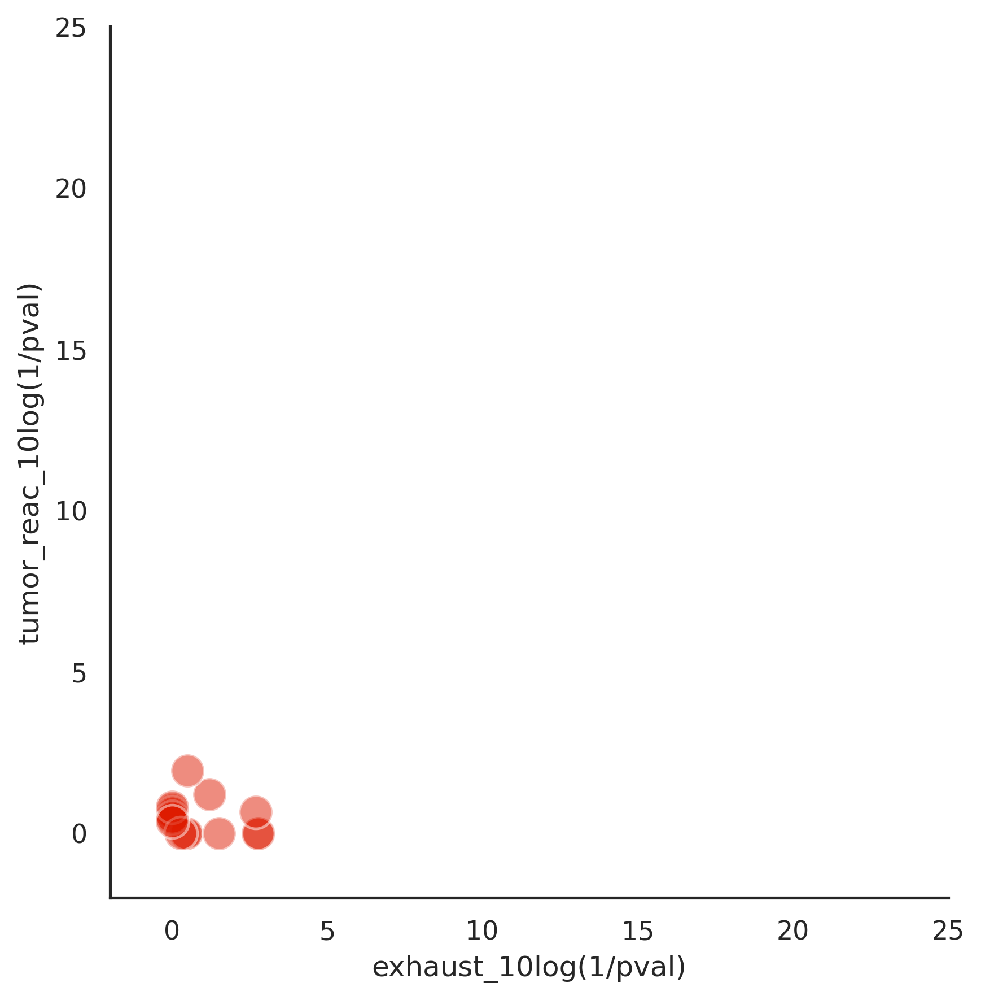

In [66]:
import seaborn as sns
sns.set_theme(style="white")
save_name = 'Bassez_tumorreac_exhaustion_GSEA_factors_scHPF_CD8.svg'

# Plot miles per gallon against horsepower with other semantics
sns.relplot(x="exhaust_10log(1/pval)", y="tumor_reac_10log(1/pval)", s=200,
            alpha=.5,color=['#de1b00'],
            height=6, data=enr_df_factor_plot_scHPF_CD8)
plt.xlim(-2,25)
plt.ylim(-2,25)
plt.savefig(figure_save_path + save_name)

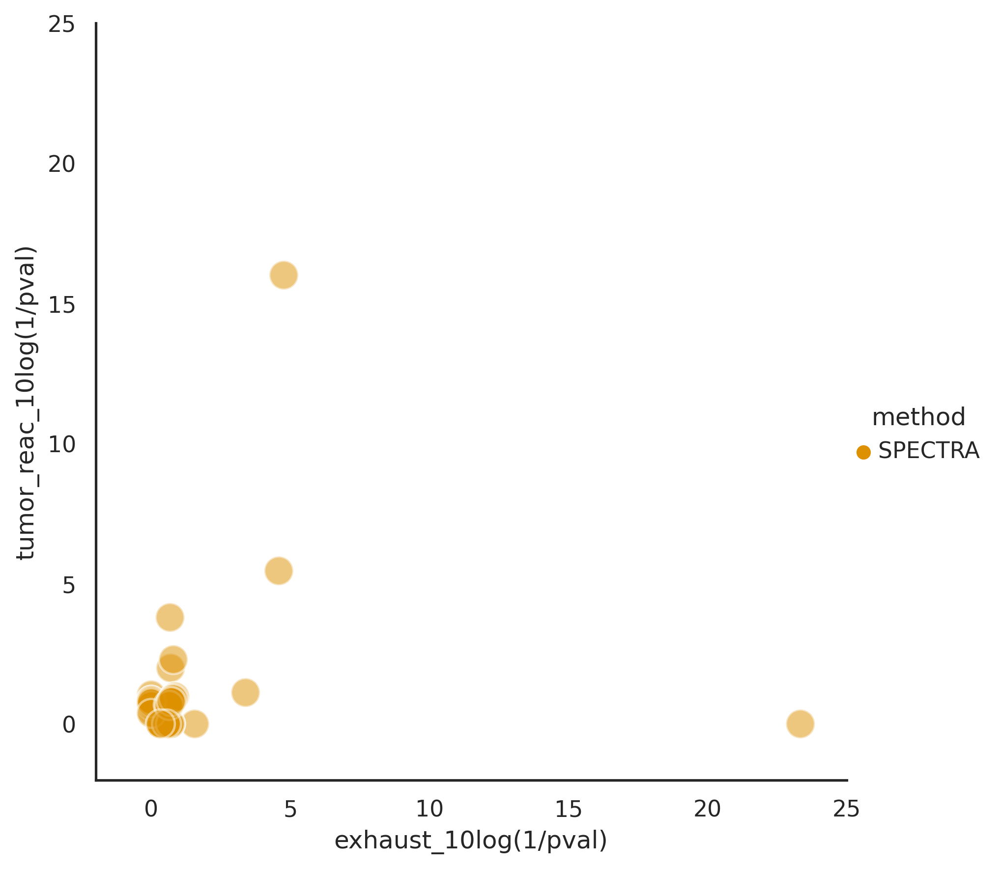

In [207]:
import seaborn as sns
sns.set_theme(style="white")
save_name = 'Bassez_tumorreac_exhaustion_GSEA_factors_SPECTRA.svg'

# Plot miles per gallon against horsepower with other semantics
sns.relplot(x="exhaust_10log(1/pval)", y="tumor_reac_10log(1/pval)", hue="method", s=200,
            alpha=0.5,palette=['#de9100'],
            height=6, data=enr_df_factor_plot_merge[enr_df_factor_plot_merge['method']=='SPECTRA'])
plt.xlim(-2,25)
plt.ylim(-2,25)
plt.savefig(figure_save_path + save_name)

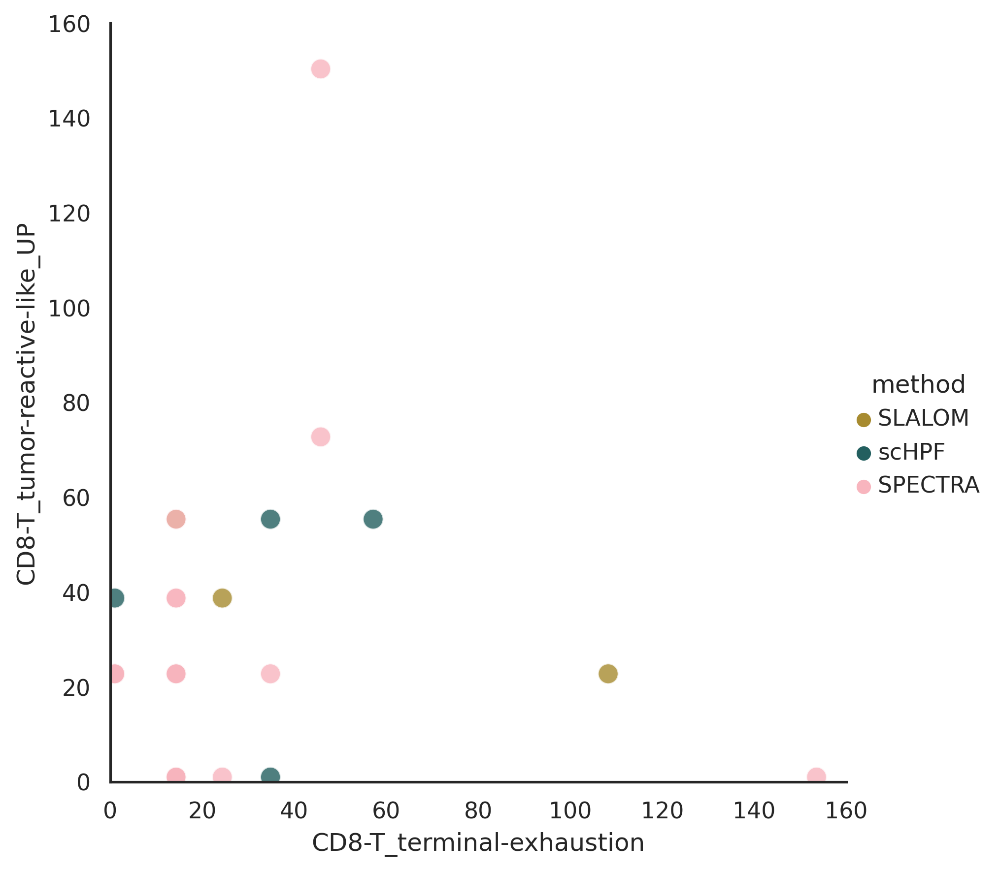

In [209]:
import seaborn as sns
sns.set_theme(style="white")
save_name = 'Bassez_tumorreac_exhaustion_GSEA_factors.svg'

# Plot miles per gallon against horsepower with other semantics
sns.relplot(x="CD8-T_terminal-exhaustion", y="CD8-T_tumor-reactive-like_UP", hue="method",
            s=100, alpha=.8, palette=batlow_20[0:3],
            height=6, data=enr_df_factor_plot_merge)
plt.xlim(0,160)
plt.ylim(0,160)
plt.savefig(figure_save_path + save_name)

In [ ]:
## compare overlaps in scatter plots 

#subset to gene sets of interest
overlap_df_SLALOM_sub = overlap_df_SLALOM[['CD8-T_terminal-exhaustion','CD8-T_tumor-reactive-like_UP']]
overlap_df_SLALOM_sub['method'] = len(overlap_df_SLALOM_sub)*['SLALOM']
overlap_df_scHPF_sub = overlap_df_scHPF[['CD8-T_terminal-exhaustion','CD8-T_tumor-reactive-like_UP']]
overlap_df_scHPF_sub['method'] = len(overlap_df_scHPF_sub)*['scHPF']
overlap_df_SPECTRA_sub = overlap_df_SPECTRA[['CD8-T_terminal-exhaustion','CD8-T_tumor-reactive-like_UP']]
overlap_df_SPECTRA_sub['method'] = len(overlap_df_SPECTRA_sub)*['SPECTRA']

#concatenate dfs
combined_df  = pd.concat([overlap_df_SLALOM_sub,overlap_df_scHPF_sub,overlap_df_SPECTRA_sub])

## Lysine metabolism GSEA

In [138]:
#prepare data for plotting (SPECTRA)
factors_of_interest = ['all_LYS_metabolism']
enr_df_factor_sub = enr_df_SPECTRA[enr_df_SPECTRA['Term'].isin(factors_of_interest)]#[['Odds Ratio','Adjusted P-value']]

enr_df_factor_plot = pd.DataFrame()

for i in set(enr_df_factor_sub['factor']):
    enr_df_factor_sub_fac = enr_df_factor_sub[enr_df_factor_sub['factor']==i].set_index('Term')
    if 'all_LYS_metabolism' not in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'all_LYS_metabolism_p'] = 1
            enr_df_factor_plot.loc[i,'all_LYS_metabolism'] = 1
    elif 'all_LYS_metabolism'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'all_LYS_metabolism_p'] = enr_df_factor_sub_fac.loc['all_LYS_metabolism','Adjusted P-value']
            enr_df_factor_plot.loc[i,'all_LYS_metabolism'] = enr_df_factor_sub_fac.loc['all_LYS_metabolism','Odds Ratio']
    else:
        print('skipping',i)

enr_df_factor_plot_SPECTRA = enr_df_factor_plot

In [139]:
enr_df_factor_plot_SPECTRA

,all_LYS_metabolism_p,all_LYS_metabolism
61-X-all_fatty-acid-metabolism,3.071089e-01,11.719927
36-X-36,2.885010e-01,11.719927
191-X-191,4.681327e-01,11.719927
188-X-188,4.681327e-01,11.719927
152-X-152,4.681327e-01,11.719927
95-X-all_TRP_metabolism,3.506642e-05,37.428152
158-X-158,4.681327e-01,11.719927
13-X-all_TYR_metabolism,1.900172e-01,11.719927
41-X-all_ROS-detoxification,2.529440e-01,11.719927
38-X-all_CYS_metabolism,2.716733e-01,11.719927


In [140]:
#prepare data for plotting (scHPF)
factors_of_interest = ['all_LYS_metabolism']
enr_df_factor_sub = enr_df_scHPF[enr_df_scHPF['Term'].isin(factors_of_interest)]#[['Odds Ratio','Adjusted P-value']]

enr_df_factor_plot = pd.DataFrame()

for i in set(enr_df_factor_sub['factor']):
    enr_df_factor_sub_fac = enr_df_factor_sub[enr_df_factor_sub['factor']==i].set_index('Term')
    if 'all_LYS_metabolism' not in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'all_LYS_metabolism_p'] = 1
            enr_df_factor_plot.loc[i,'all_LYS_metabolism'] = 1
    elif 'all_LYS_metabolism'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'all_LYS_metabolism_p'] = enr_df_factor_sub_fac.loc['all_LYS_metabolism','Adjusted P-value']
            enr_df_factor_plot.loc[i,'all_LYS_metabolism'] = enr_df_factor_sub_fac.loc['all_LYS_metabolism','Odds Ratio']
    else:
        print('skipping',i)

enr_df_factor_plot_scHPF = enr_df_factor_plot

In [141]:
#prepare data for plotting (SLALOM)
factors_of_interest = ['all_LYS_metabolism']
enr_df_factor_sub = enr_df_SLALOM[enr_df_SLALOM['Term'].isin(factors_of_interest)]#[['Odds Ratio','Adjusted P-value']]

enr_df_factor_plot = pd.DataFrame()

for i in set(enr_df_factor_sub['factor']):
    enr_df_factor_sub_fac = enr_df_factor_sub[enr_df_factor_sub['factor']==i].set_index('Term')
    if 'all_LYS_metabolism' not in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'all_LYS_metabolism_p'] = 1
            enr_df_factor_plot.loc[i,'all_LYS_metabolism'] = 1
    elif 'all_LYS_metabolism'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'all_LYS_metabolism_p'] = enr_df_factor_sub_fac.loc['all_LYS_metabolism','Adjusted P-value']
            enr_df_factor_plot.loc[i,'all_LYS_metabolism'] = enr_df_factor_sub_fac.loc['all_LYS_metabolism','Odds Ratio']
    else:
        print('skipping',i)

enr_df_factor_plot_SLALOM = enr_df_factor_plot

In [142]:
#merge for plotting
enr_df_factor_plot_scHPF['method'] = len(enr_df_factor_plot_scHPF)*['scHPF']
enr_df_factor_plot_SPECTRA['method'] = len(enr_df_factor_plot_SPECTRA)*['SPECTRA']
enr_df_factor_plot_SLALOM['method'] = len(enr_df_factor_plot_SLALOM)*['SLALOM']

enr_df_factor_plot_merge = pd.concat([enr_df_factor_plot_SLALOM,enr_df_factor_plot_scHPF, enr_df_factor_plot_SPECTRA])
enr_df_factor_plot_merge['all_LYS_metabolism_10log(1/pval)'] = enr_df_factor_plot_merge['all_LYS_metabolism_p'].apply(lambda x: math.log(1/x, 10))
enr_df_factor_plot_merge

,all_LYS_metabolism_p,all_LYS_metabolism,method,all_LYS_metabolism_10log(1/pval)
SLALOM_1,4.564294e-01,11.719927,SLALOM,0.340626
SLALOM_7,4.681327e-01,11.719927,SLALOM,0.329631
SLALOM_12,5.610644e-01,11.719927,SLALOM,0.250987
SLALOM_19,3.374823e-01,11.719927,SLALOM,0.471749
SLALOM_15,1.832878e-01,11.719927,SLALOM,0.736866
SLALOM_2,4.187849e-01,11.719927,SLALOM,0.378009
SLALOM_9,2.459768e-03,28.497927,SLALOM,2.609106
scHPF_64,4.593509e-01,11.719927,scHPF,0.337855
scHPF_74,2.952970e-01,11.719927,scHPF,0.529741
scHPF_83,2.952970e-01,11.719927,scHPF,0.529741


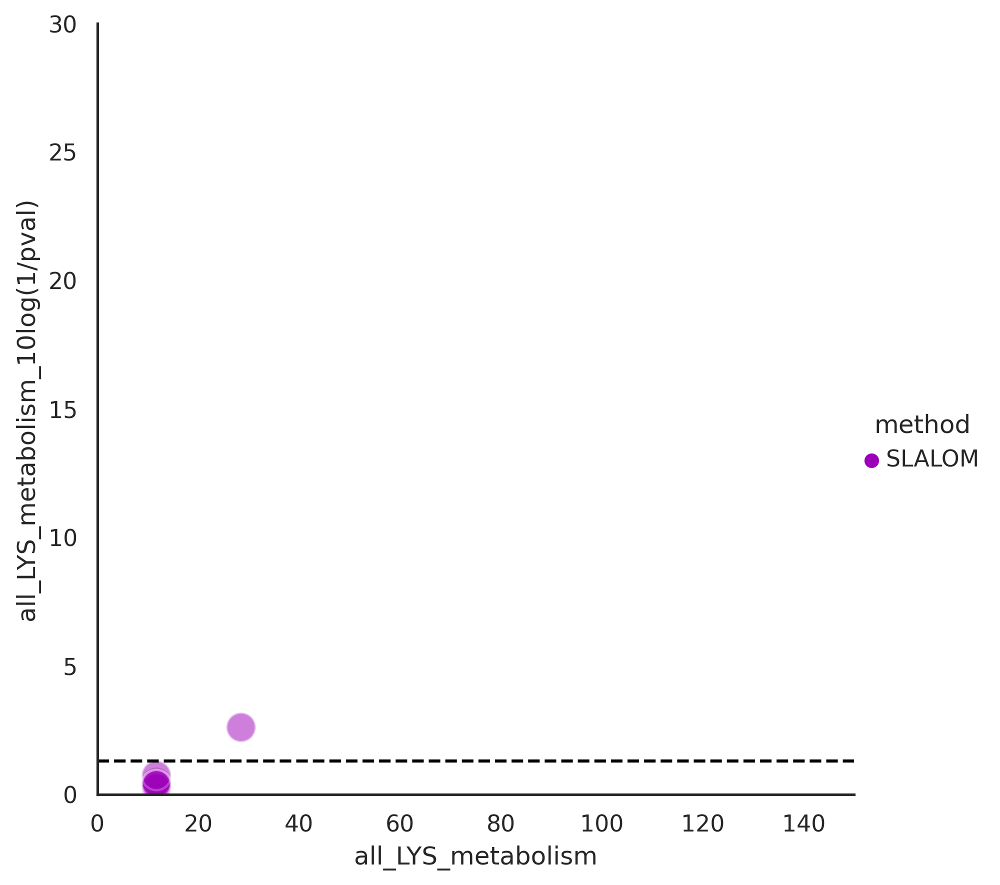

In [155]:
import seaborn as sns
sns.set_theme(style="white")
save_name = 'Bassez_LYS_GSEA_factors_SLALOM.svg'

# Plot miles per gallon against horsepower with other semantics
sns.relplot(x="all_LYS_metabolism", y="all_LYS_metabolism_10log(1/pval)", hue="method", s=200,
            alpha=0.5,palette=['#9d00b9'],
            height=6, data=enr_df_factor_plot_merge[enr_df_factor_plot_merge['method']=='SLALOM'])
plt.xlim(0,150)
plt.ylim(0,30)
plt.axhline(math.log(1/0.05,10),color='#000000',linestyle='--')
plt.savefig(figure_save_path + save_name)

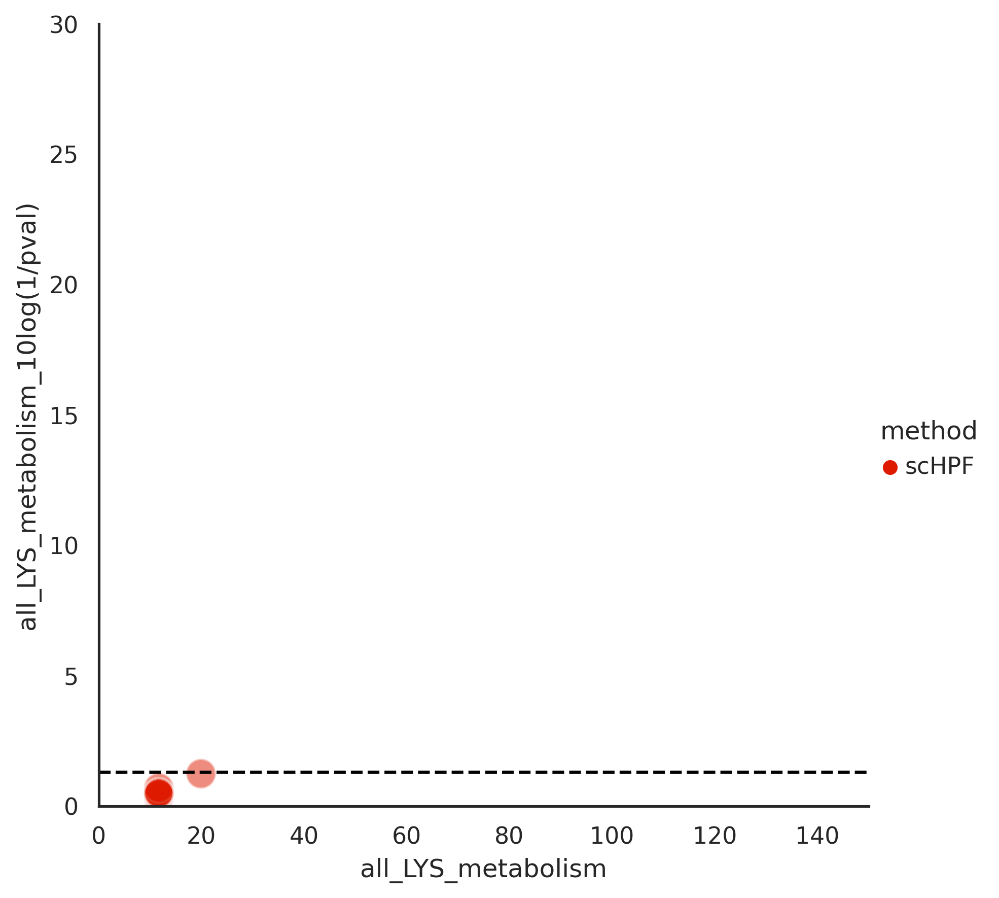

In [158]:
import seaborn as sns
sns.set_theme(style="white")
save_name = 'Bassez_LYS_GSEA_factors_scHPF.svg'

# Plot miles per gallon against horsepower with other semantics
sns.relplot(x="all_LYS_metabolism", y="all_LYS_metabolism_10log(1/pval)", hue="method", s=200,
            alpha=0.5,palette=['#de1b00'],
            height=6, data=enr_df_factor_plot_merge[enr_df_factor_plot_merge['method']=='scHPF'])
plt.xlim(0,150)
plt.ylim(0,30)
plt.axhline(math.log(1/0.05,10),color='#000000',linestyle='--')
plt.savefig(figure_save_path + save_name)

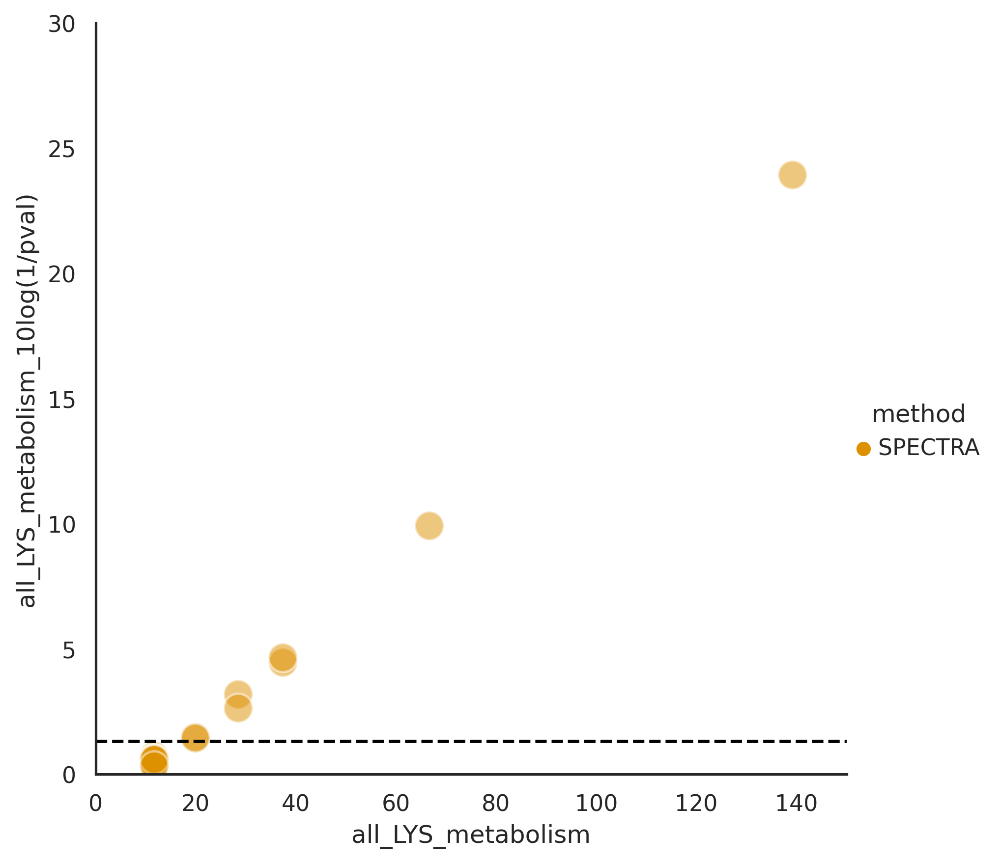

In [159]:
import seaborn as sns
sns.set_theme(style="white")
save_name = 'Bassez_LYS_GSEA_factors_SPECTRA.svg'

# Plot miles per gallon against horsepower with other semantics
sns.relplot(x="all_LYS_metabolism", y="all_LYS_metabolism_10log(1/pval)", hue="method", s=200,
            alpha=0.5,palette=['#de9100'],
            height=6, data=enr_df_factor_plot_merge[enr_df_factor_plot_merge['method']=='SPECTRA'])
plt.xlim(0,150)
plt.ylim(0,30)
plt.axhline(math.log(1/0.05,10),color='#000000',linestyle='--')
plt.savefig(figure_save_path + save_name)

### compare this with SPECTRA, we found a highly plasma specific LYS factor there

In [21]:
SPECTRA_LYS = list(adata_SPECTRA.uns['SPADE_markers_global']['103-X-all_LYS_metabolism'])
SPECTRA_LYS

['BBOX1',
 'AASS',
 'SPCS2',
 'ALDH7A1',
 'TMLHE',
 'SLC7A1',
 'SPCS3',
 'SLC6A8',
 'SLC25A15',
 'PLPBP',
 'AADAT',
 'SPCS1',
 'PIPOX',
 'PYCR3',
 'SLC6A7',
 'PYCR2',
 'SLC7A2',
 'SLC3A1',
 'XBP1',
 'SEC11C',
 'SDF2L1',
 'HSP90B1',
 'HSPA5',
 'TPT1',
 'MYDGF',
 'PDIA6',
 'TMEM59',
 'SELENOS',
 'OSTC',
 'SSR3',
 'SEC61B',
 'SSR4',
 'SEC61G',
 'CANX',
 'PLPP5',
 'FKBP11',
 'DNAJB9',
 'HERPUD1',
 'TMED2',
 'NUCB2',
 'TRAM1',
 'SSR1',
 'ERLEC1',
 'SEC61A1',
 'FKBP2',
 'SERP1',
 'IGKC',
 'ITM2C',
 'ALDH2',
 'MTDH']

In [59]:
color_dict = {'ER-stress':'#FFFF00',
 'ER_protein_synthesis':'#1CE6FF',
 'ER_stress':'#FF34FF',
 'LYS_metabolism':'#FF4A46',
 'NFkB_signaling': '#008941',
 'Notch_signaling':'#006FA6',
 'Ras_signaling': '#A30059',
 'VitB6_metabolism': '#7A4900',
 'aberrant':'#0000A6',
 'adhesion':'#63FFAC',
 'autophagy': '#B79762',
 'calcium_signaling': '#004D43',
 'cell_cycle': '#8FB0FF',
 'chemotaxis':'#997D87',
 'cholesterol_metabolism':'#5A0007',
 'creatinine_metabolism': '#809693',
 'cytoskeleton': '#1B4400',
 'development': '#4FC601',
 'differentiation': '#3B5DFF',
 'disulfide_bond':'#4A3B53',
 'glutathione_metabolism':'#FF2F80',
 'glycolipid_metabolism':'#61615A',
 'hypoxia':'#BA0900',
 'ion_channel': '#6B7900',
 'lipid_metabolims':'#00C2A0',
 'marker':'#FFAA92',
 'non-coding': '#FF90C9',
 'phospholipid_metabolism': '#B903AA',
 'proliferation': '#D16100',
 'proline_metabolism': '#DDEFFF',
 'protein_glycosylation': '#000035',
 'protein_synthesis':'#7B4F4B',
 'signaling': '#A1C299',
 'survival': '#300018',
 'transcription': '#0AA6D8',
 'transcription_factor': '#013349',
 'unknown': '#00846F',
 'urea_cycle': '#372101'}


In [60]:
#which marker class of top plasma cell specific

marker_dict ={
    'BBOX1':'LYS_metabolism', 'AASS':'LYS_metabolism', 'SPCS2':'LYS_metabolism', 'ALDH7A1':'LYS_metabolism', 'TMLHE':'LYS_metabolism', 
              'SLC7A1':'LYS_metabolism', 
              'SPCS3':'LYS_metabolism',
       'SLC6A8':'creatinine_metabolism', 'SLC25A15':'urea_cycle', 'PLPBP':'VitB6_metabolism', 
              'AADAT':'LYS_metabolism', 'SPCS1':'LYS_metabolism', 'PIPOX':'LYS_metabolism', 'PYCR3':'proline_metabolism',
       'SLC6A7':'proline_metabolism', 'PYCR2':'proline_metabolism', 'SLC7A2':'LYS_metabolism', 'SLC3A1':'LYS_metabolism', 'XBP1':'ER_stress',
              'SEC11C':'ER_stress', 'SDF2L1':'ER_stress',
       'HSP90B1':'ER_stress', 'HSPA5':'ER_stress', 'TPT1':'proliferation', 'MYDGF':'proliferation', 
              'PDIA6':'ER_stress', 'TMEM59':'autophagy', 'SELENOS':'ER_stress',
       'OSTC':'protein_glycosylation', 'SSR3':'ER_stress', 'SEC61B':'ER_protein_synthesis', 'SSR4':'protein_glycosylation',
              'SEC61G':'ER_protein_synthesis', 'CANX':'protein_glycosylation', 'PLPP5':'phospholipid_metabolism',
       'FKBP11':'protein_synthesis', 'DNAJB9':'ER_stress', 'HERPUD1':'ER_stress', 'TMED2':'ER_protein_synthesis',
              'NUCB2':'transcription_factor', 'TRAM1':'protein_glycosylation', 'SSR1':'ER_protein_synthesis',
       'ERLEC1':'protein_glycosylation', 'SEC61A1':'protein_synthesis', 
              'FKBP2':'protein_synthesis', 'SERP1':'ER_stress', 'IGKC':'marker', 'ITM2C':'differentiation', 'ALDH2':'LYS_metabolism',
       'MTDH':'NFkB_signaling'}

In [61]:
len(set(marker_dict.keys()).intersection(set(adata_SPECTRA.uns['SPADE_markers_global']['103-X-all_LYS_metabolism'])))

50

In [62]:
#count categories
counts = []
labels=[]
marker_class = [marker_dict[x] for x in SPECTRA_LYS]

for i in set(marker_class):
    counts.append(marker_class.count(i))
    labels.append(i)

SPECTRA_pie_interpret.svg


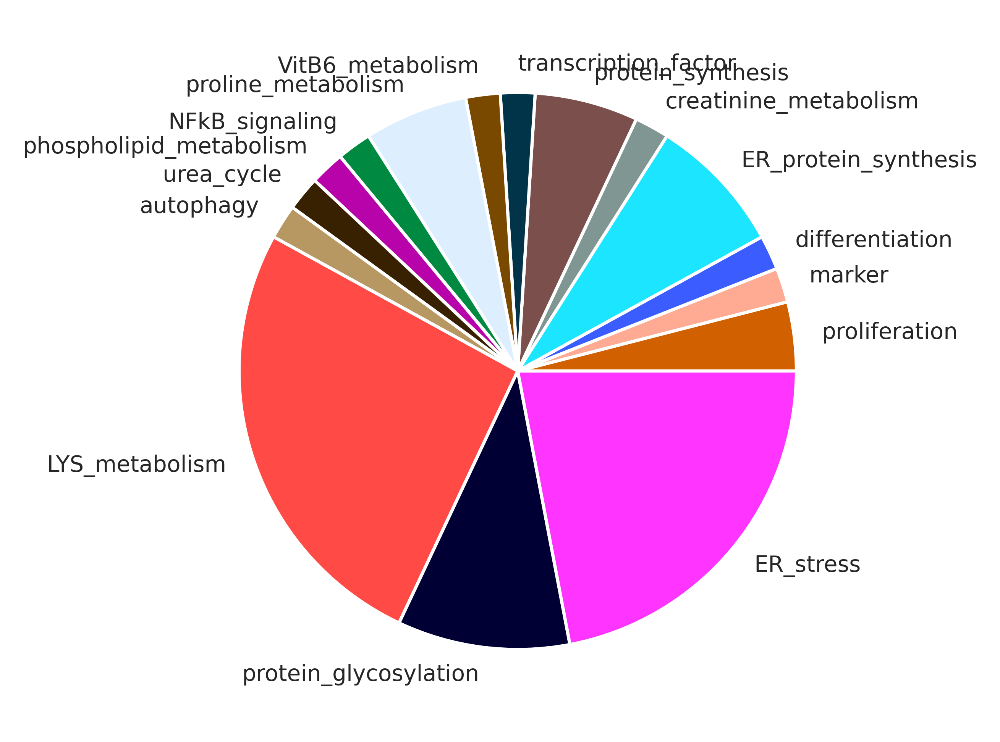

In [63]:
#plot
save_name= 'SPECTRA_pie_interpret.svg'
fig, ax = plt.subplots()
plt.pie(counts, labels = labels,colors=[color_dict[x] for x in labels])
plt.savefig(figure_save_path+save_name)
print(save_name)

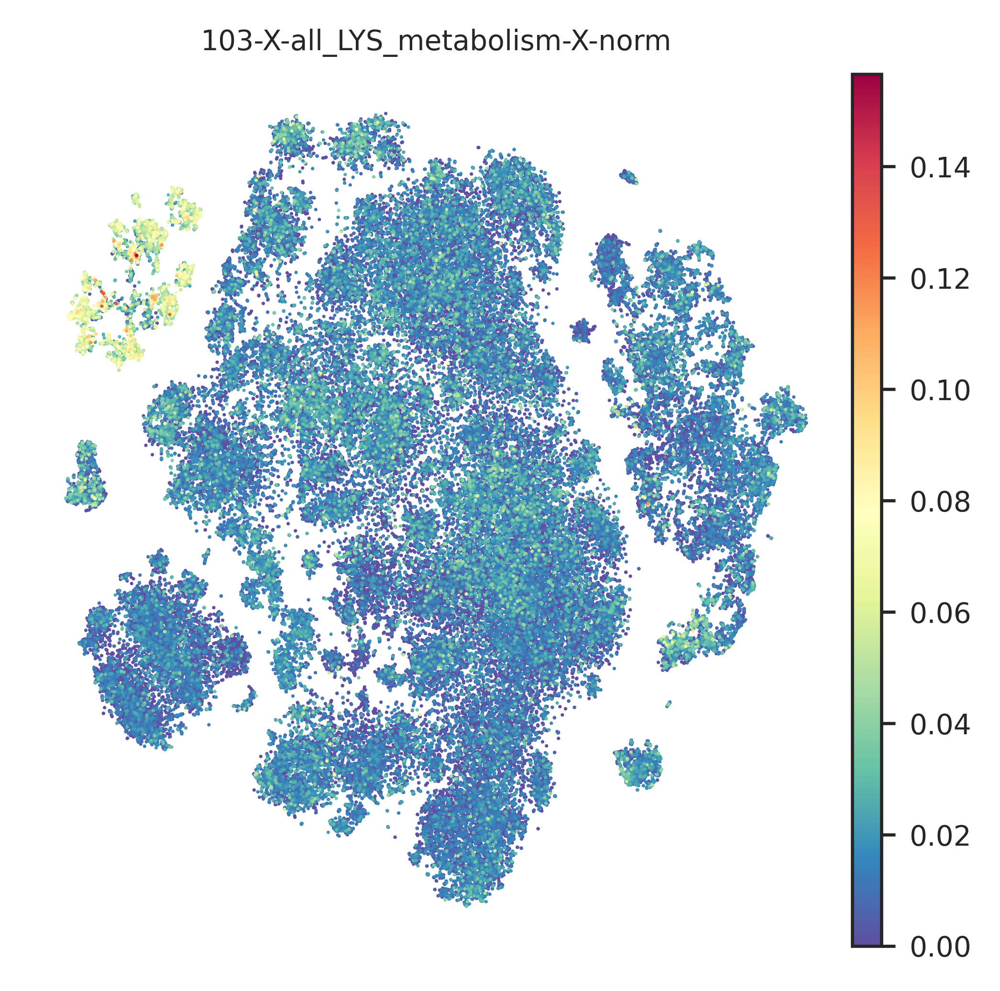

In [39]:
sc.pl.tsne(adata_SPECTRA, color = '103-X-all_LYS_metabolism-X-norm', s = 3, cmap='Spectral_r', legend_fontsize = 10,save='Bassez_103-X-all_LYS_metabolism-X-norm.svg', vmin=0)

## compare with scHPF

In [41]:
scHPF_LYS = list(adata_scHPF.uns['scHPF_markers_global']['scHPF_27'])
scHPF_LYS

['CCL17',
 'UBD',
 'CCL19',
 'ACHE',
 'IDO1',
 'AOC1',
 'CXCL9',
 'TIFAB',
 'NCCRP1',
 'LAD1',
 'FSCN1',
 'ANKRD22',
 'EBI3',
 'CSF2RA',
 'TFPI2',
 'PDCD1LG2',
 'CD1E',
 'SLC6A12',
 'SLC1A2',
 'RTN1',
 'RASSF4',
 'CLEC9A',
 'AL353608.3',
 'ALDH2',
 'GSN',
 'TUBB2B',
 'LAMP3',
 'CD80',
 'SERPINF2',
 'SERPINF1',
 'GUCY1B1',
 'PIPOX',
 'UPB1',
 'ENPP2',
 'CALHM6',
 'PLA2G4A',
 'ERC2',
 'SLC18A1',
 'CCND1',
 'CD40',
 'TMEM176A',
 'FBXO27',
 'CD274',
 'CFB',
 'TMEM176B',
 'TNFRSF11B',
 'GPT',
 'IL4I1',
 'LIPG',
 'ELOVL7']

In [51]:
adata_scHPF

AnnData object with n_obs × n_vars = 97863 × 19984
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k2

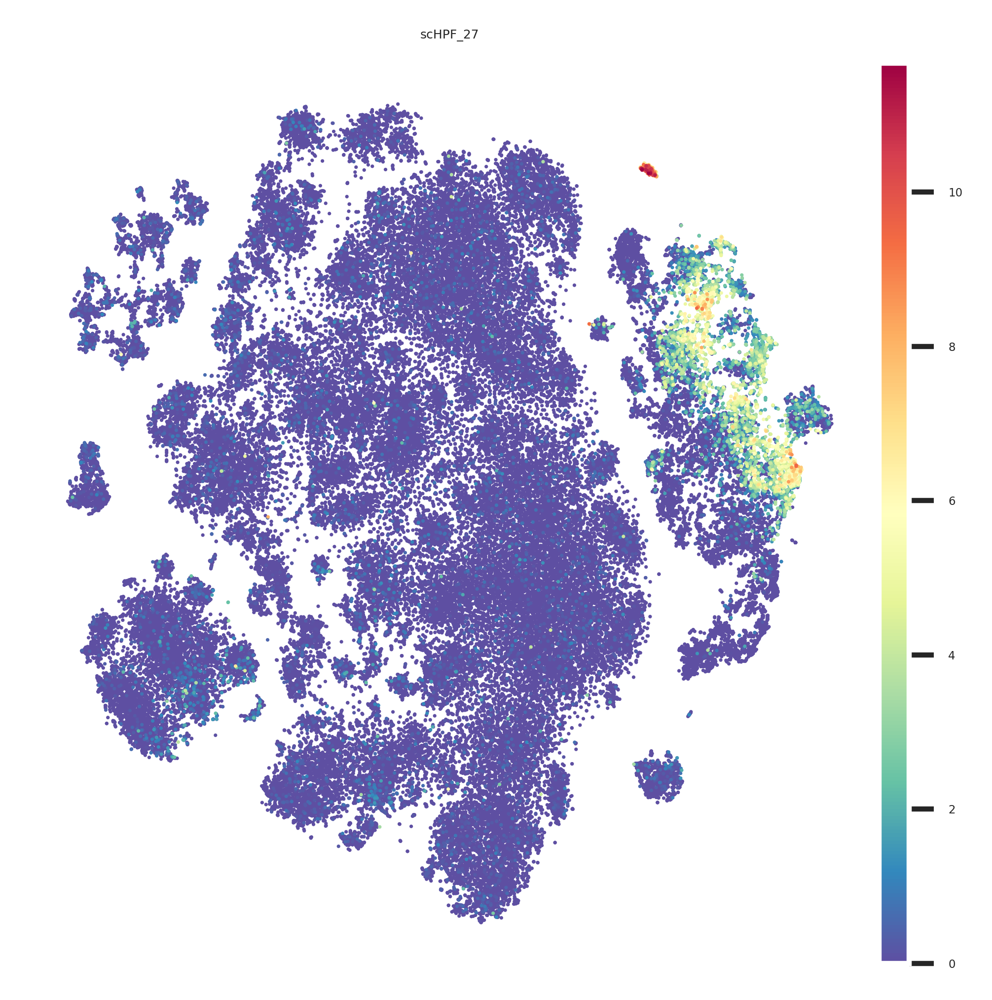

In [234]:
sc.pl.tsne(adata_scHPF, color = ['scHPF_27'], s = 3, cmap='Spectral_r', legend_fontsize = 10,save='Bassez_scHPF_27_LYS.svg', vmin=0)

In [52]:
scHPF_factors = ['scHPF_0', 'scHPF_1', 'scHPF_2', 'scHPF_3', 'scHPF_4', 'scHPF_5', 'scHPF_6', 'scHPF_7', 'scHPF_8', 'scHPF_9', 'scHPF_10', 'scHPF_11', 'scHPF_12', 'scHPF_13', 'scHPF_14', 'scHPF_15', 'scHPF_16', 'scHPF_17', 'scHPF_18', 'scHPF_19', 'scHPF_20', 'scHPF_21', 'scHPF_22', 'scHPF_23', 'scHPF_24', 'scHPF_25', 'scHPF_26', 'scHPF_27', 'scHPF_28', 'scHPF_29', 'scHPF_30', 'scHPF_31', 'scHPF_32', 'scHPF_33', 'scHPF_34', 'scHPF_35', 'scHPF_36', 'scHPF_37', 'scHPF_38', 'scHPF_39', 'scHPF_40', 'scHPF_41', 'scHPF_42', 'scHPF_43', 'scHPF_44', 'scHPF_45', 'scHPF_46', 'scHPF_47', 'scHPF_48', 'scHPF_49', 'scHPF_50', 'scHPF_51', 'scHPF_52', 'scHPF_53', 'scHPF_54', 'scHPF_55', 'scHPF_56', 'scHPF_57', 'scHPF_58', 'scHPF_59', 'scHPF_60', 'scHPF_61', 'scHPF_62', 'scHPF_63', 'scHPF_64', 'scHPF_65', 'scHPF_66', 'scHPF_67', 'scHPF_68', 'scHPF_69', 'scHPF_70', 'scHPF_71', 'scHPF_72', 'scHPF_73', 'scHPF_74', 'scHPF_75', 'scHPF_76', 'scHPF_77', 'scHPF_78', 'scHPF_79', 'scHPF_80', 'scHPF_81', 'scHPF_82', 'scHPF_83', 'scHPF_84', 'scHPF_85', 'scHPF_86', 'scHPF_87', 'scHPF_88', 'scHPF_89', 'scHPF_90', 'scHPF_91', 'scHPF_92', 'scHPF_93', 'scHPF_94', 'scHPF_95', 'scHPF_96', 'scHPF_97', 'scHPF_98', 'scHPF_99']

In [42]:
marker_dict = {'CCL17':'chemotaxis',
 'UBD':'other',
 'CCL19':'chemotaxis',
 'ACHE':'other',
 'IDO1':'immune-checkpoint',
 'AOC1':'metabolism',
 'CXCL9':'chemotaxis',
 'TIFAB':'other',
 'NCCRP1':'unknown',
 'LAD1':'extracellular_matrix',
 'FSCN1':'cytoskeleton',
 'ANKRD22':'unknown',
 'EBI3':'cytokine',
 'CSF2RA':'cytokine_receptor',
 'TFPI2':'coagulation',
 'PDCD1LG2':'immune-checkpoint',
 'CD1E':'antigen-presentation',
 'SLC6A12':'metabolism',
 'SLC1A2':'metabolism',
 'RTN1':'aberrant',
 'RASSF4':'other',
 'CLEC9A':'PAMPR',
 'AL353608.3':'non-coding',
 'ALDH2':'LYS_metabolism',
 'GSN':'cytoskeleton',
 'TUBB2B':'cytoskeleton',
 'LAMP3':'cytoskeleton',
 'CD80':'immune-checkpoint',
 'SERPINF2':'coagulation',
 'SERPINF1':'other',
 'GUCY1B1':'signaling',
 'PIPOX':'LYS_metabolism',
 'UPB1':'metabolism',
 'ENPP2':'extracellular_matrix',
 'CALHM6':'ion_channel',
 'PLA2G4A':'other',
 'ERC2':'other',
 'SLC18A1':'signaling',
 'CCND1':'cell_cycle',
 'CD40':'immune-checkpoint',
 'TMEM176A':'differentiation',
 'FBXO27':'other',
 'CD274':'immune-checkpoint',
 'CFB':'complement',
 'TMEM176B':'ubiquitin',
 'TNFRSF11B':'immune-checkpoint',
 'GPT':'metabolism',
 'IL4I1':'other',
 'LIPG':'lipid_metabolims',
 'ELOVL7':'lipid_metabolims'}

In [47]:
color_dict = { 'ER_protein_synthesis':'#1CE6FF',
 'ER_stress':'#FF34FF',
 'LYS_metabolism':'#FF4A46',
 'NFkB_signaling': '#008941',
 'Notch_signaling':'#006FA6',
 'Ras_signaling': '#A30059',
 'VitB6_metabolism': '#7A4900',
 'aberrant':'#0000A6',
 'adhesion':'#63FFAC',
 'autophagy': '#B79762',
 'calcium_signaling': '#004D43',
 'cell_cycle': '#8FB0FF',
 'chemotaxis':'#997D87',
 'cholesterol_metabolism':'#5A0007',
 'creatinine_metabolism': '#809693',
 'cytoskeleton': '#1B4400',
 'development': '#4FC601',
 'differentiation': '#3B5DFF',
 'disulfide_bond':'#4A3B53',
 'glutathione_metabolism':'#FF2F80',
 'glycolipid_metabolism':'#61615A',
 'hypoxia':'#BA0900',
 'ion_channel': '#6B7900',
 'lipid_metabolims':'#00C2A0',
 'marker':'#FFAA92',
 'non-coding': '#FF90C9',
              'PAMPR':'#f8a487',
 'phospholipid_metabolism': '#B903AA',
 'proliferation': '#D16100',
 'proline_metabolism': '#DDEFFF',
 'protein_glycosylation': '#000035',
 'protein_synthesis':'#7B4F4B',
 'signaling': '#A1C299',
 'survival': '#300018',
 'transcription': '#0AA6D8',
 'transcription_factor': '#013349',
 'unknown': '#00846F',
 'urea_cycle': '#372101',
             'cytokine':'#235f5f',
             'immune-checkpoint':'#f8b5be',
             'cytokine_receptor':'#eecbe1',
             'metabolism':'#757e36',
             'extracellular_matrix':'#1d2356',
             'coagulation':'#f8aca2',
             'antigen-presentation':'#1d2b59',
             'complement':'#396a58',
             'ubiquitin':'#8d8532',
             'other':'#134460'}


In [46]:
batlow_20[15]

'#134460'

In [49]:
#count categories
counts = []
labels=[]
marker_class = [marker_dict[x] for x in scHPF_LYS]

for i in set(marker_class):
    counts.append(marker_class.count(i))
    labels.append(i)

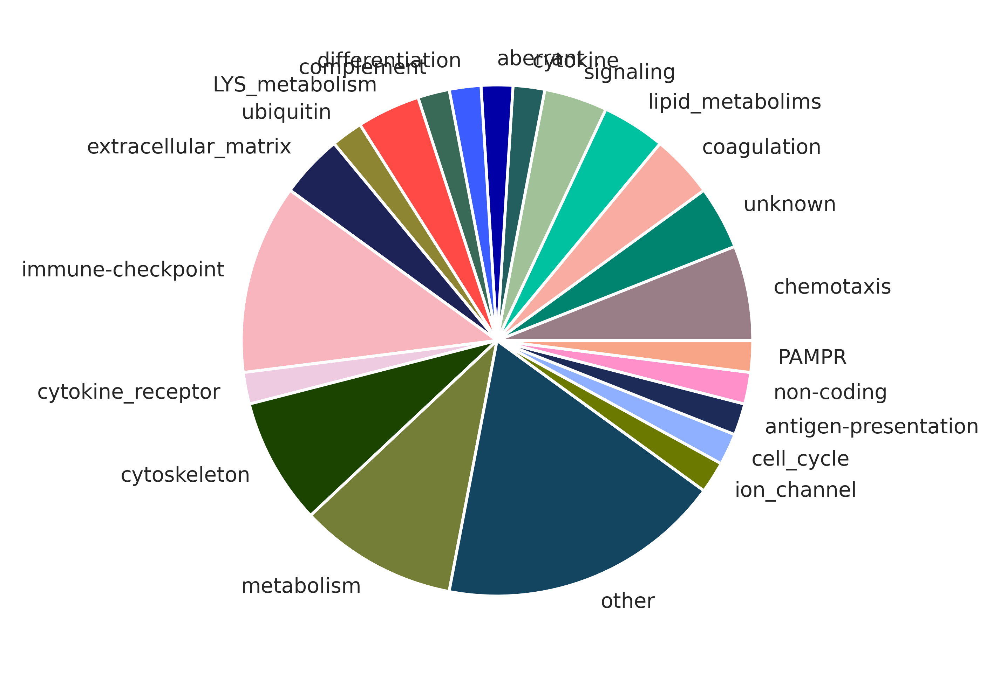

In [50]:
#plot
save_name = 'scHPF27_pie_interpret.svg'
fig, ax = plt.subplots()
plt.pie(counts, labels = labels,colors=[color_dict[x] for x in labels])
plt.savefig(figure_save_path+save_name)

In [69]:
scHPF_LYS = list(adata_scHPF.uns['scHPF_markers_global']['scHPF_45'])
scHPF_LYS

['IGLL5',
 'LINC02362',
 'AC012236.1',
 'AC233755.2',
 'TNFRSF17',
 'JSRP1',
 'FAM92B',
 'RASSF6',
 'BRSK1',
 'TXNDC5',
 'ITGA8',
 'DPEP1',
 'SDC1',
 'CHAC1',
 'SCNN1B',
 'DERL3',
 'AC233755.1',
 'MZB1',
 'IGHJ4',
 'AC007569.1',
 'AMPD1',
 'CLDN14',
 'IGHJ6',
 'AC141272.1',
 'IGKJ1',
 'JCHAIN',
 'AC106882.1',
 'AC093797.1',
 'FCRL5',
 'IGLJ3',
 'LINC02576',
 'SMPDL3B',
 'AC135068.2',
 'C4B',
 'IGLJ2',
 'LINC01485',
 'AC104699.1',
 'SPAG4',
 'E2F5',
 'IGKJ3',
 'LINC01055',
 'CCL25',
 'IGHJ5',
 'AC136616.2',
 'MYL2',
 'AC134981.1',
 'CPNE5',
 'DNAAF1',
 'IGKC',
 'B9D1']

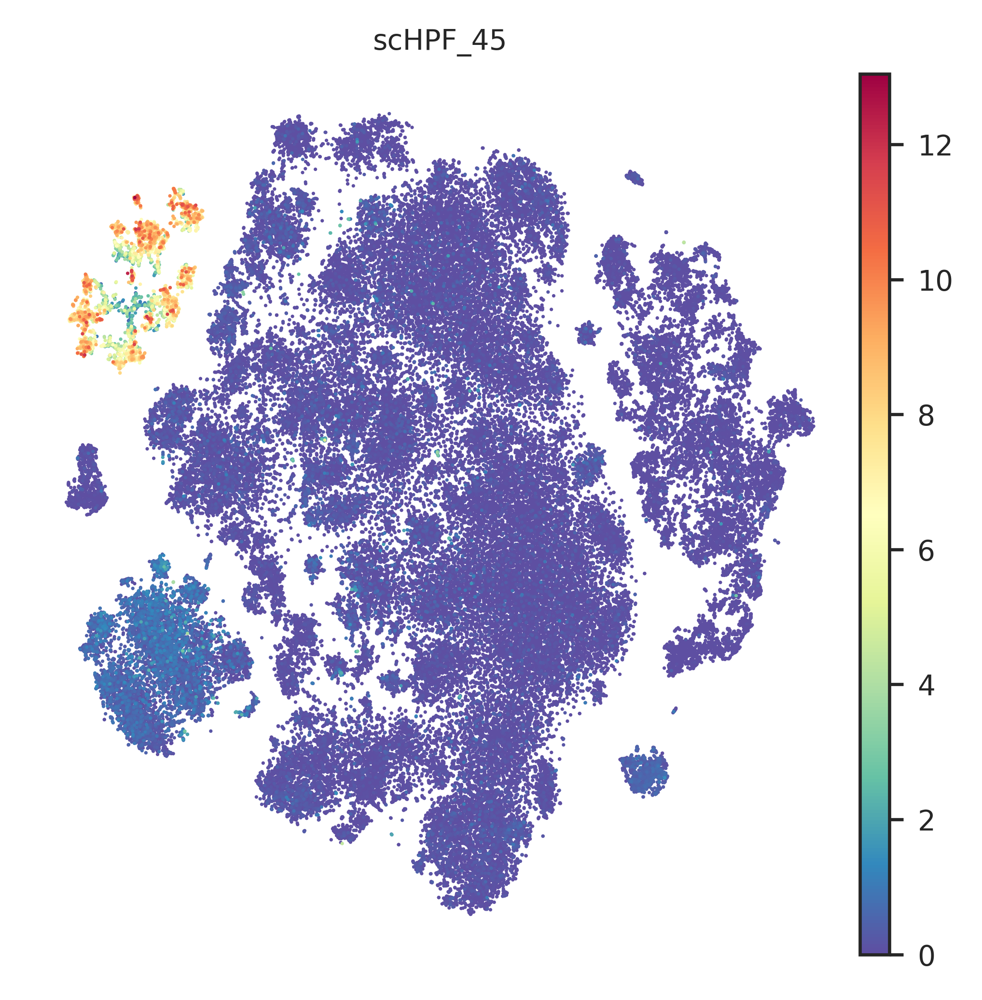

In [64]:
sc.pl.tsne(adata_scHPF, color = ['scHPF_45'], s = 3, cmap='Spectral_r', legend_fontsize = 10,save='Bassez_LYS_scHPF45.svg', vmin=0)

In [75]:
marker_dict = {'IGLL5':'marker',
 'LINC02362':'non-coding',
 'AC012236.1':'unknown',
 'AC233755.2':'unknown',
 'TNFRSF17':'immune-checkpoint',
 'JSRP1':'aberrant',
 'FAM92B':'cytoskeleton',
 'RASSF6':'Ras_signaling',
 'BRSK1':'cell_cycle',
 'TXNDC5':'ER_stress',
 'ITGA8': 'adhesion',
 'DPEP1':'metabolism',
 'SDC1':'marker',
 'CHAC1':'Notch_signaling',
 'SCNN1B':'ion_channel',
 'DERL3':'ER_stress',
 'AC233755.1':'unknown',
 'MZB1':'marker',
 'IGHJ4':'marker',
 'AC007569.1':'unknown',
 'AMPD1':'aberrant',
 'CLDN14': 'adhesion',
 'IGHJ6':'marker',
 'AC141272.1':'unknown',
 'IGKJ1':'marker',
 'JCHAIN':'marker',
 'AC106882.1':'unknown',
 'AC093797.1':'unknown',
 'FCRL5':'development',
 'IGLJ3':'marker',
 'LINC02576':'non-coding',
 'SMPDL3B':'glycolipid_metabolism',
 'AC135068.2':'unknown',
 'C4B':'other',
 'IGLJ2':'marker',
 'LINC01485':'non-coding',
 'AC104699.1':'unknown',
 'SPAG4':'other',
 'E2F5':'transcription_factor',
 'IGKJ3':'marker',
 'LINC01055':'non-coding',
 'CCL25':'chemotaxis',
 'IGHJ5':'marker',
 'AC136616.2':'unknown',
 'MYL2':'aberrant',
 'AC134981.1':'unknown',
 'CPNE5':'adhesion',
 'DNAAF1':'cytoskeleton',
 'IGKC':'marker',
 'B9D1':'cytoskeleton'}

In [76]:
color_dict = { 'ER_protein_synthesis':'#1CE6FF',
 'ER_stress':'#FF34FF',
 'LYS_metabolism':'#FF4A46',
 'NFkB_signaling': '#008941',
 'Notch_signaling':'#006FA6',
 'Ras_signaling': '#A30059',
 'VitB6_metabolism': '#7A4900',
 'aberrant':'#0000A6',
 'adhesion':'#63FFAC',
 'autophagy': '#B79762',
 'calcium_signaling': '#004D43',
 'cell_cycle': '#8FB0FF',
 'chemotaxis':'#997D87',
 'cholesterol_metabolism':'#5A0007',
 'creatinine_metabolism': '#809693',
 'cytoskeleton': '#1B4400',
 'development': '#4FC601',
 'differentiation': '#3B5DFF',
 'disulfide_bond':'#4A3B53',
 'glutathione_metabolism':'#FF2F80',
 'glycolipid_metabolism':'#61615A',
 'hypoxia':'#BA0900',
 'ion_channel': '#6B7900',
 'lipid_metabolims':'#00C2A0',
 'marker':'#FFAA92',
 'non-coding': '#FF90C9',
              'PAMPR':'#f8a487',
 'phospholipid_metabolism': '#B903AA',
 'proliferation': '#D16100',
 'proline_metabolism': '#DDEFFF',
 'protein_glycosylation': '#000035',
 'protein_synthesis':'#7B4F4B',
 'signaling': '#A1C299',
 'survival': '#300018',
 'transcription': '#0AA6D8',
 'transcription_factor': '#013349',
 'unknown': '#00846F',
 'urea_cycle': '#372101',
             'cytokine':'#235f5f',
             'immune-checkpoint':'#f8b5be',
             'cytokine_receptor':'#eecbe1',
             'metabolism':'#757e36',
             'extracellular_matrix':'#1d2356',
             'coagulation':'#f8aca2',
             'antigen-presentation':'#1d2b59',
             'complement':'#396a58',
             'ubiquitin':'#8d8532',
             'other':'#134460'}


In [77]:
#count categories
counts = []
labels=[]
marker_class = [marker_dict[x] for x in scHPF_LYS]

for i in set(marker_class):
    counts.append(marker_class.count(i))
    labels.append(i)

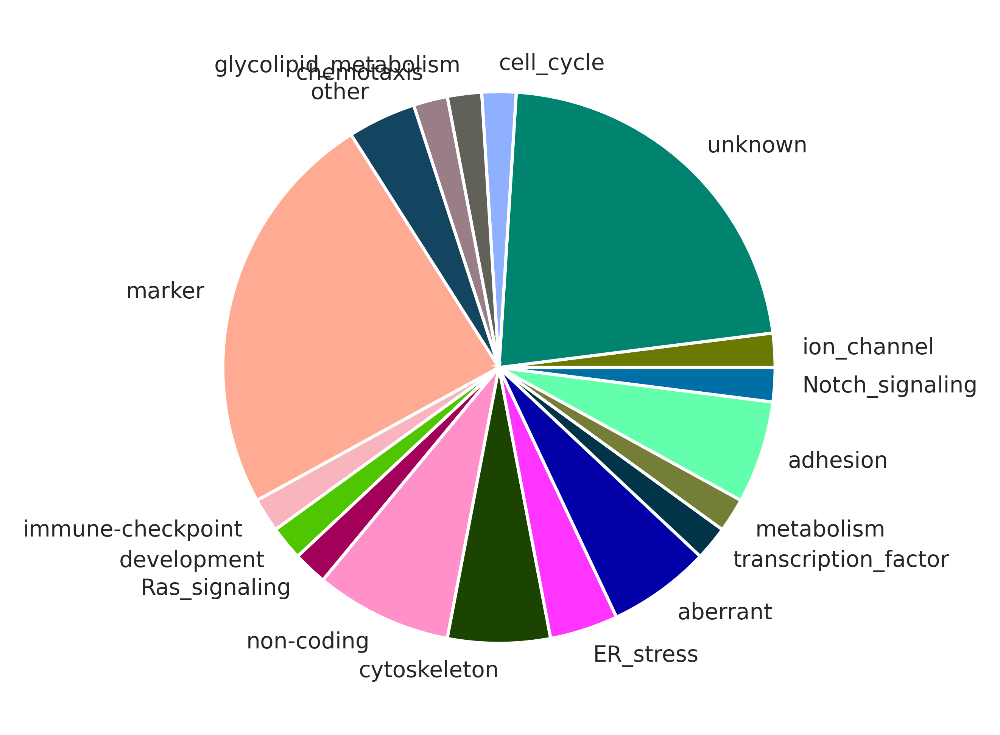

In [79]:
#plot
save_name = 'scHPF45_pie_interpret.svg'
fig, ax = plt.subplots()
plt.pie(counts, labels = labels,colors=[color_dict[x] for x in labels])
plt.savefig(figure_save_path+save_name)

### compare with SLALOM

In [40]:
SLALOM_LYS = list(adata_SLALOM.uns['SLALOM_markers_global']['SLALOM_9'])
SLALOM_LYS

['IGKC',
 'JCHAIN',
 'MZB1',
 'SSR4',
 'XBP1',
 'DERL3',
 'HERPUD1',
 'SEC11C',
 'HSP90B1',
 'FKBP11',
 'ITM2C',
 'PRDX4',
 'CD79A',
 'IGLL5',
 'FKBP2',
 'SSR3',
 'SEC61B',
 'UBE2J1',
 'SPCS2',
 'SPCS1',
 'PIM2',
 'SPCS3',
 'SDF2L1',
 'SELENOS',
 'MYDGF',
 'ERLEC1',
 'PDIA6',
 'LMAN1',
 'PLPP5',
 'TXNDC11',
 'MANF',
 'POU2AF1',
 'CD38',
 'DNAJB9',
 'TENT5C',
 'SDC1',
 'CRELD2',
 'SELENOM',
 'PDIA4',
 'TXNDC15',
 'HDLBP',
 'TNFRSF17',
 'RRBP1',
 'SEL1L',
 'CHPF',
 'SEL1L3',
 'JSRP1',
 'FCRL5',
 'ARSA',
 'LINC02362']

In [90]:
#which marker class of top plasma cell specific

marker_dict ={'IGKC':'marker',
 'JCHAIN':'marker',
 'MZB1':'marker',
 'SSR4':'protein_glycosylation',
 'XBP1':'ER_stress',
 'DERL3':'ER_stress',
 'HERPUD1':'ER_stress',
 'SEC11C':'ER_stress',
 'HSP90B1':'ER_stress',
 'FKBP11':'protein_synthesis',
 'ITM2C':'differentiation',
 'PRDX4':'NFkB_signaling',
 'CD79A':'marker',
 'IGLL5':'marker',
 'FKBP2':'protein_synthesis',
 'SSR3':'ER_stress',
 'SEC61B':'ER_protein_synthesis',
 'UBE2J1':'ER_stress',
 'SPCS2':'LYS_metabolism',
 'SPCS1':'LYS_metabolism',
 'PIM2':'survival',
 'SPCS3':'LYS_metabolism',
 'SDF2L1':'ER_stress',
 'SELENOS':'ER_stress',
 'MYDGF':'proliferation',
 'ERLEC1':'protein_glycosylation',
 'PDIA6':'ER_stress',
 'LMAN1':'protein_glycosylation',
 'PLPP5':'phospholipid_metabolism',
 'TXNDC11':'protein_synthesis',
 'MANF':'ER_stress',
 'POU2AF1':'transcription',
 'CD38':'marker',
 'DNAJB9':'ER_stress',
 'TENT5C':'transcription',
 'SDC1':'marker',
 'CRELD2':'calcium_signaling',
 'SELENOM':'aberrant',
 'PDIA4':'disulfide_bond',
 'TXNDC15':'disulfide_bond',
 'TNFRSF17':'marker',
 'HDLBP':'cholesterol_metabolism',
 'RRBP1':'ER_protein_synthesis',
 'SEL1L':'ER_stress',
 'CHPF':'protein_glycosylation',
 'JSRP1':'aberrant',
 'SEL1L3':'unknown',
 'FCRL5':'development',
 'ARSA':'glycolipid_metabolism',
 'LINC02362':'non-coding'}

In [91]:
len(set(marker_dict.keys()).intersection(set(SLALOM_LYS)))

50

In [92]:
color_dict = {'ER_protein_synthesis':'#1CE6FF',
 'ER_stress':'#FF34FF',
 'LYS_metabolism':'#FF4A46',
 'NFkB_signaling': '#008941',
 'Notch_signaling':'#006FA6',
 'Ras_signaling': '#A30059',
 'VitB6_metabolism': '#7A4900',
 'aberrant':'#0000A6',
 'adhesion':'#63FFAC',
 'autophagy': '#B79762',
 'calcium_signaling': '#004D43',
 'cell_cycle': '#8FB0FF',
 'chemotaxis':'#997D87',
 'cholesterol_metabolism':'#5A0007',
 'creatinine_metabolism': '#809693',
 'cytoskeleton': '#1B4400',
 'development': '#4FC601',
 'differentiation': '#3B5DFF',
 'disulfide_bond':'#4A3B53',
 'glutathione_metabolism':'#FF2F80',
 'glycolipid_metabolism':'#61615A',
 'hypoxia':'#BA0900',
 'ion_channel': '#6B7900',
 'lipid_metabolims':'#00C2A0',
 'marker':'#FFAA92',
 'non-coding': '#FF90C9',
 'phospholipid_metabolism': '#B903AA',
 'proliferation': '#D16100',
 'proline_metabolism': '#DDEFFF',
 'protein_glycosylation': '#000035',
 'protein_synthesis':'#7B4F4B',
 'signaling': '#A1C299',
 'survival': '#300018',
 'transcription': '#0AA6D8',
 'transcription_factor': '#013349',
 'unknown': '#00846F',
 'urea_cycle': '#372101'}


In [93]:
#count categories
counts = []
labels=[]
marker_class = [marker_dict[x] for x in SLALOM_LYS]

for i in set(marker_class):
    counts.append(marker_class.count(i))
    labels.append(i)

In [94]:
labels

['proliferation',
 'glycolipid_metabolism',
 'aberrant',
 'marker',
 'protein_glycosylation',
 'differentiation',
 'ER_protein_synthesis',
 'protein_synthesis',
 'NFkB_signaling',
 'phospholipid_metabolism',
 'LYS_metabolism',
 'calcium_signaling',
 'development',
 'cholesterol_metabolism',
 'disulfide_bond',
 'survival',
 'ER_stress',
 'non-coding',
 'transcription',
 'unknown']

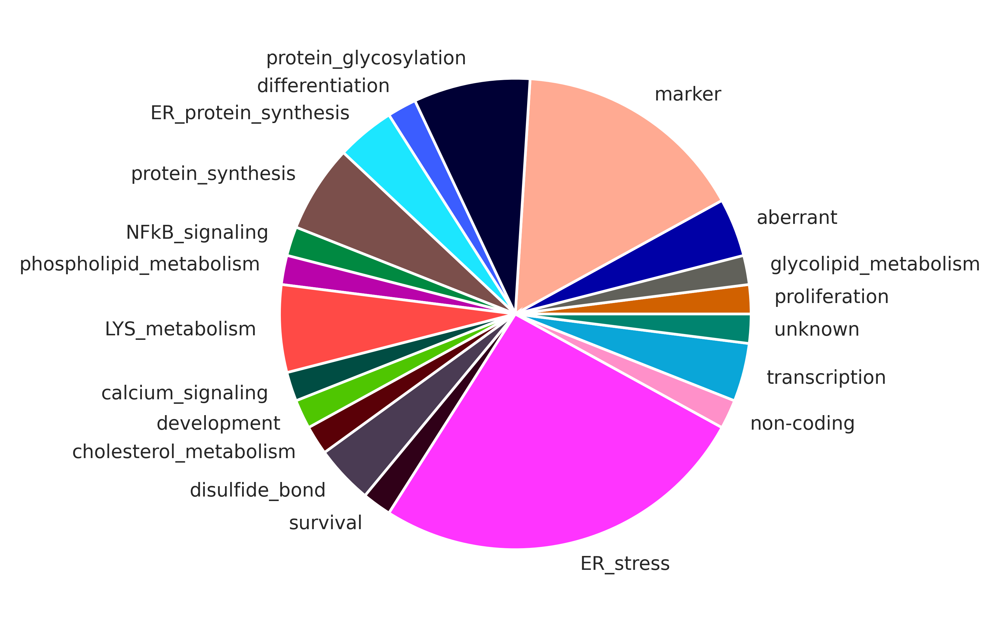

In [95]:
#plot
save_name = 'SLALOM_pie_interpret.svg'
fig, ax = plt.subplots()
plt.pie(counts, labels = labels,colors=[color_dict[x] for x in labels])
plt.savefig(figure_save_path+save_name)

# CD8 T cells

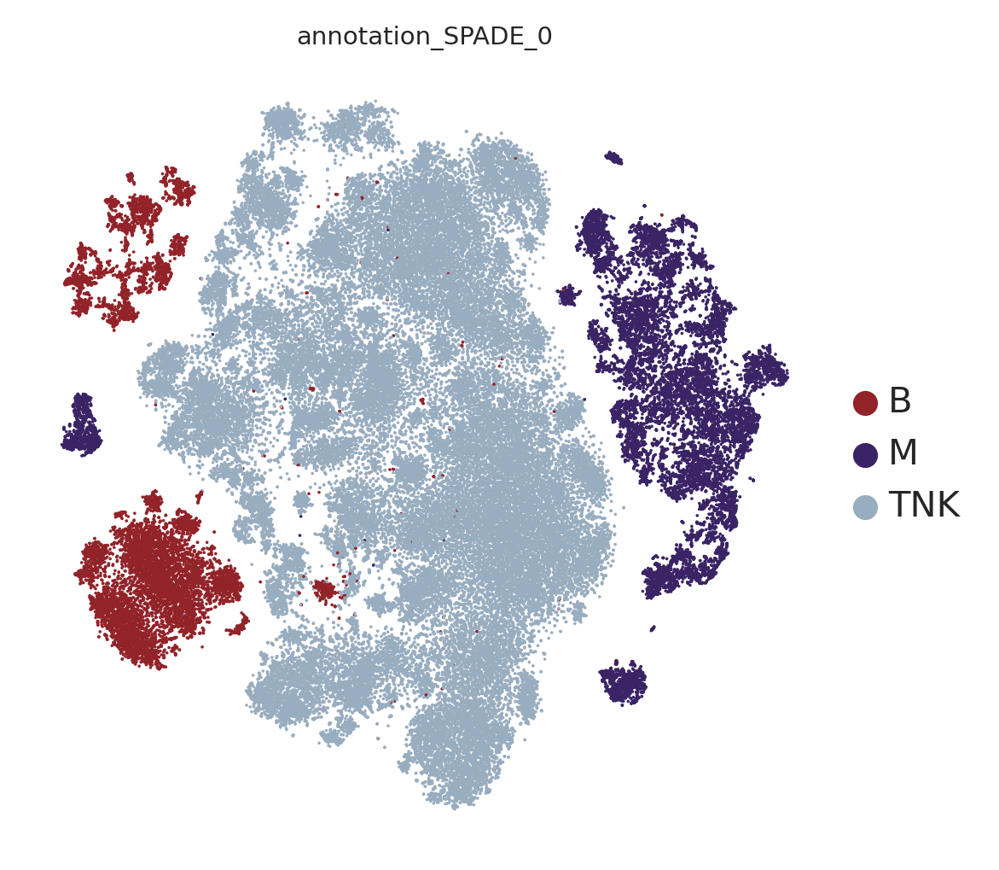

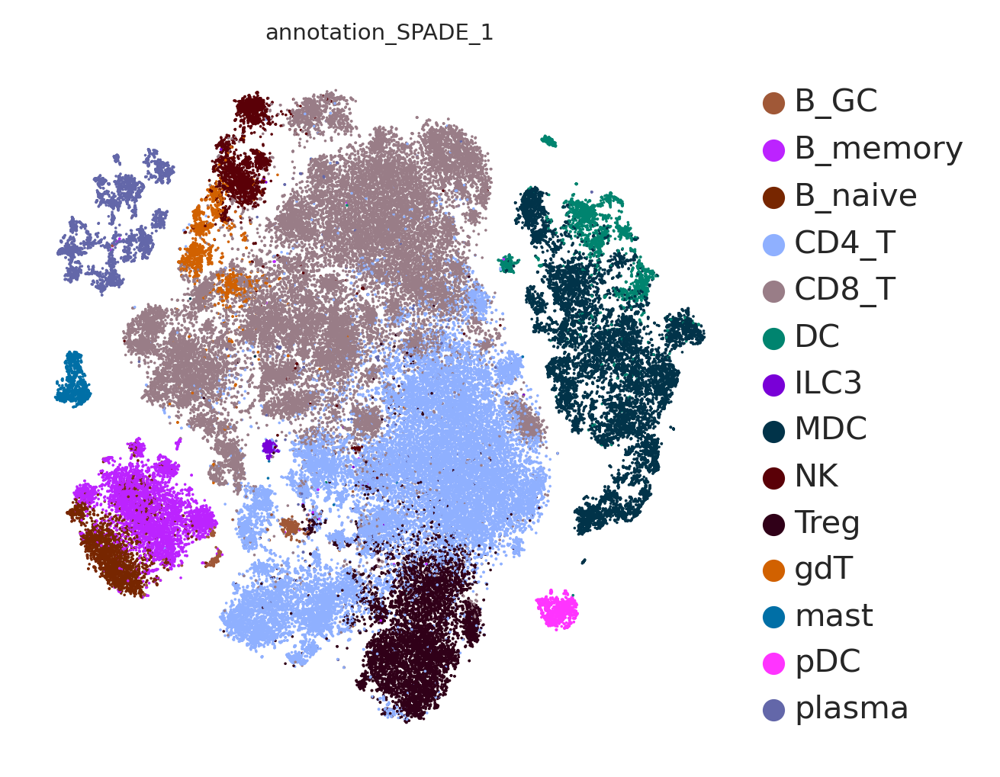

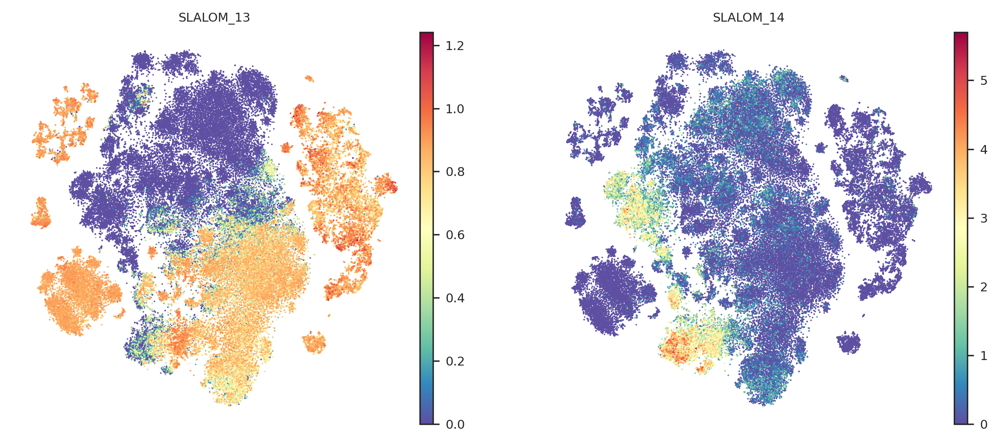

In [24]:
#SLALOM13 = tumor reaction #SLALOM14 = exhaustion
sc.pl.tsne(adata_SLALOM, color = ['annotation_SPADE_0'], s = 3, cmap='Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.tsne(adata_SLALOM, color = ['annotation_SPADE_1'], s = 3, cmap='Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.tsne(adata_SLALOM, color = ['SLALOM_13','SLALOM_14'], s = 3, cmap='Spectral_r', legend_fontsize = 10, vmin=0)

In [13]:
overlap_df_SLALOM['T_tcr-activation'].sort_values()

SLALOM_0     0.00
SLALOM_10    0.00
SLALOM_8     0.00
SLALOM_6     0.00
SLALOM_5     0.00
SLALOM_9     0.00
SLALOM_4     0.00
SLALOM_3     0.02
SLALOM_12    0.02
SLALOM_13    0.02
SLALOM_16    0.02
SLALOM_19    0.02
SLALOM_7     0.04
SLALOM_2     0.04
SLALOM_18    0.04
SLALOM_1     0.04
SLALOM_11    0.06
SLALOM_14    0.06
SLALOM_17    0.06
SLALOM_15    0.72
Name: T_tcr-activation, dtype: float64

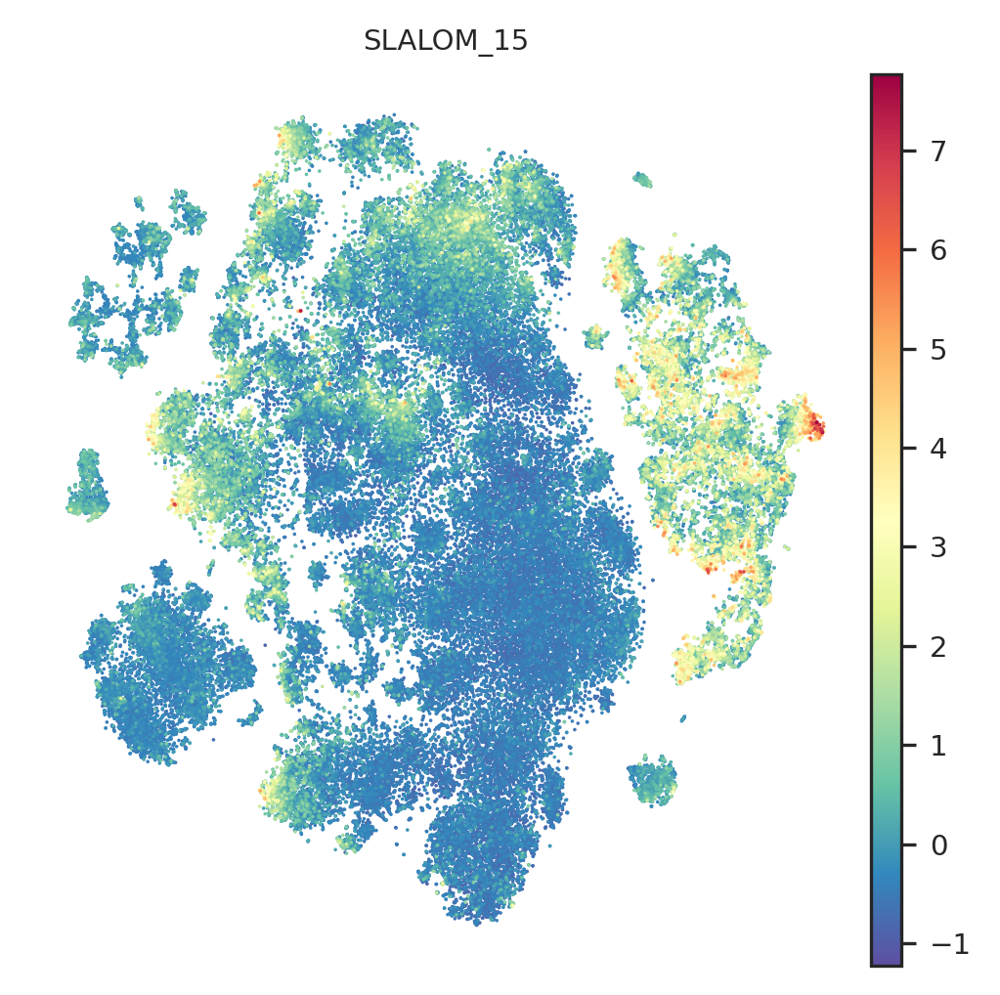

In [18]:
sc.pl.tsne(adata_SLALOM, color = ['SLALOM_15'], s = 3, cmap='Spectral_r', legend_fontsize = 10)

In [15]:
overlap_df_SLALOM['CD8-T_terminal-exhaustion'].sort_values()

SLALOM_0     0.000000
SLALOM_16    0.000000
SLALOM_11    0.000000
SLALOM_10    0.000000
SLALOM_18    0.000000
SLALOM_8     0.000000
SLALOM_9     0.000000
SLALOM_5     0.000000
SLALOM_4     0.000000
SLALOM_6     0.000000
SLALOM_7     0.076923
SLALOM_3     0.076923
SLALOM_2     0.076923
SLALOM_12    0.076923
SLALOM_13    0.076923
SLALOM_1     0.076923
SLALOM_17    0.076923
SLALOM_19    0.076923
SLALOM_15    0.153846
SLALOM_14    0.692308
Name: CD8-T_terminal-exhaustion, dtype: float64

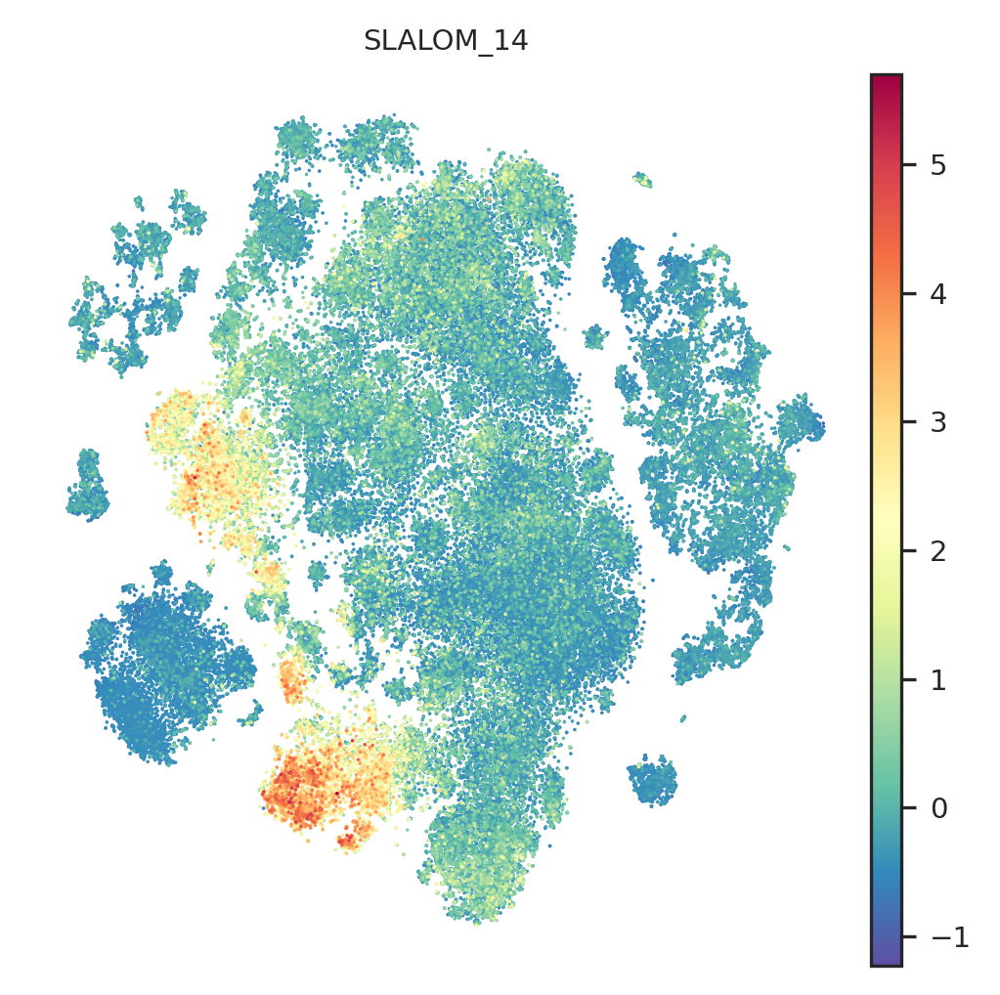

In [19]:
sc.pl.tsne(adata_SLALOM, color = ['SLALOM_14'], s = 3, cmap='Spectral_r', legend_fontsize = 10)

In [14]:
overlap_df_SLALOM['CD8-T_tumor-reactive-like_UP'].sort_values()

SLALOM_0     0.000
SLALOM_17    0.000
SLALOM_16    0.000
SLALOM_12    0.000
SLALOM_11    0.000
SLALOM_10    0.000
SLALOM_18    0.000
SLALOM_9     0.000
SLALOM_6     0.000
SLALOM_5     0.000
SLALOM_4     0.000
SLALOM_3     0.000
SLALOM_2     0.000
SLALOM_1     0.000
SLALOM_7     0.000
SLALOM_19    0.000
SLALOM_8     0.125
SLALOM_14    0.125
SLALOM_15    0.250
SLALOM_13    0.375
Name: CD8-T_tumor-reactive-like_UP, dtype: float64

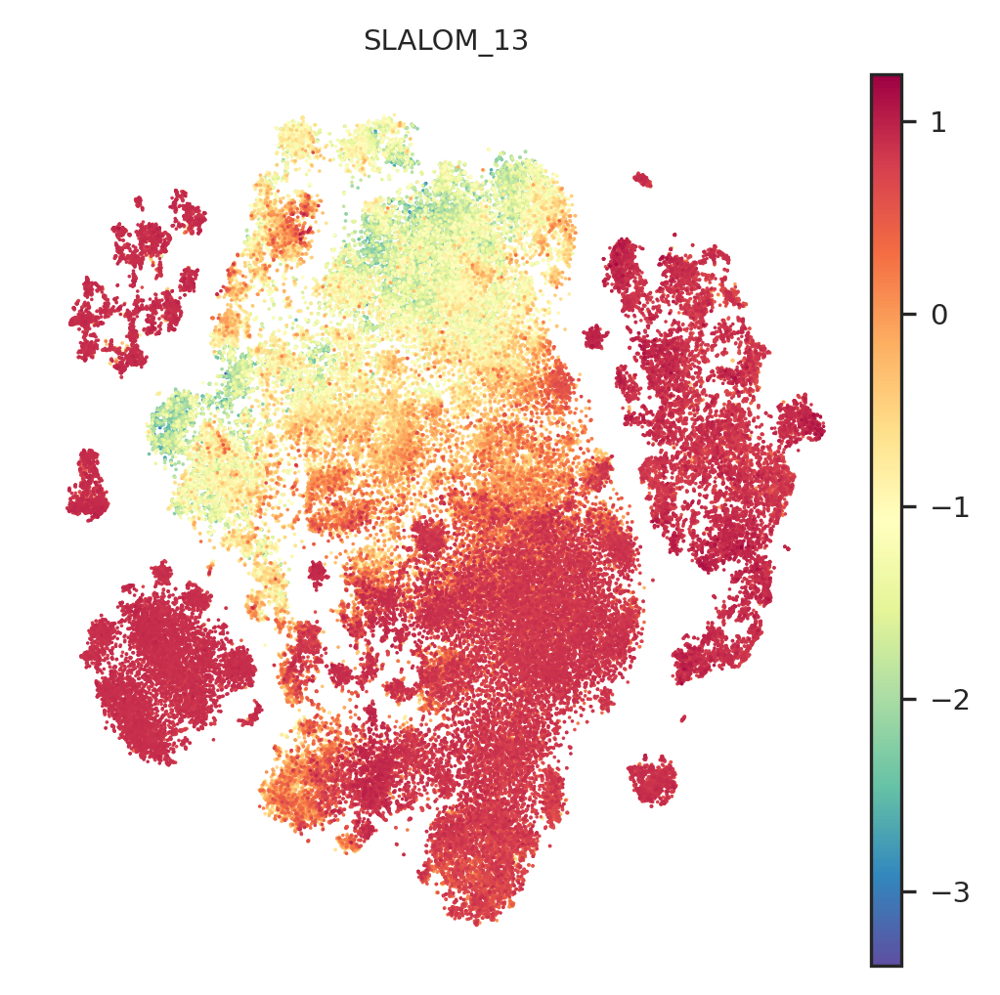

In [20]:
sc.pl.tsne(adata_SLALOM, color = ['SLALOM_13'], s = 3, cmap='Spectral_r', legend_fontsize = 10)

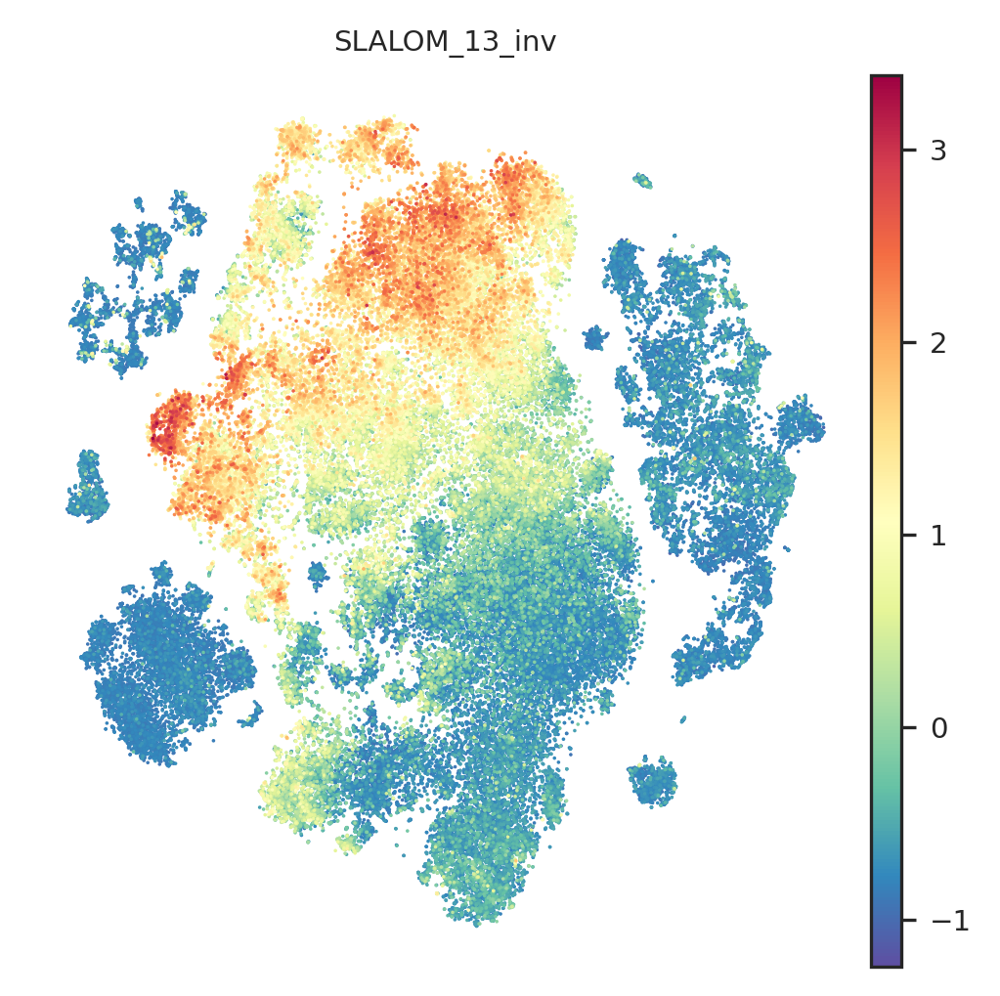

In [21]:
adata_SLALOM.obs['SLALOM_13_inv'] = adata_SLALOM.obs['SLALOM_13']*(-1)
sc.pl.tsne(adata_SLALOM, color = ['SLALOM_13_inv'], s = 3, cmap='Spectral_r', legend_fontsize = 10)

In [25]:
#restrict to CD8

adata_SPECTRA_celltype = adata_SPECTRA[adata_SPECTRA.obs['annotation_SPADE_1']=='CD8_T']
adata_SPECTRA_celltype

View of AnnData object with n_obs × n_vars = 31925 × 19984
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'phen

In [26]:
#restrict to CD8

adata_SLALOM_celltype = adata_SLALOM[adata_SLALOM.obs['annotation_SPADE_1']=='CD8_T']
adata_SLALOM_celltype

View of AnnData object with n_obs × n_vars = 31925 × 19984
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'phen

In [27]:
#restrict to CD8

adata_scHPF_celltype = adata_scHPF[adata_scHPF.obs['annotation_SPADE_1']=='CD8_T']
adata_scHPF_celltype

View of AnnData object with n_obs × n_vars = 31925 × 19984
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'phen

(28766, 3)
['all_:_3.6397135507195997%', 'NE_:_0.52%', 'E_:_5.302142172013215%']
saved to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/Bassez-SLALOM_exhaust_correlation-scatter.svg
SpearmanrResult(correlation=-0.21354534602390543, pvalue=6.534191748325361e-294)


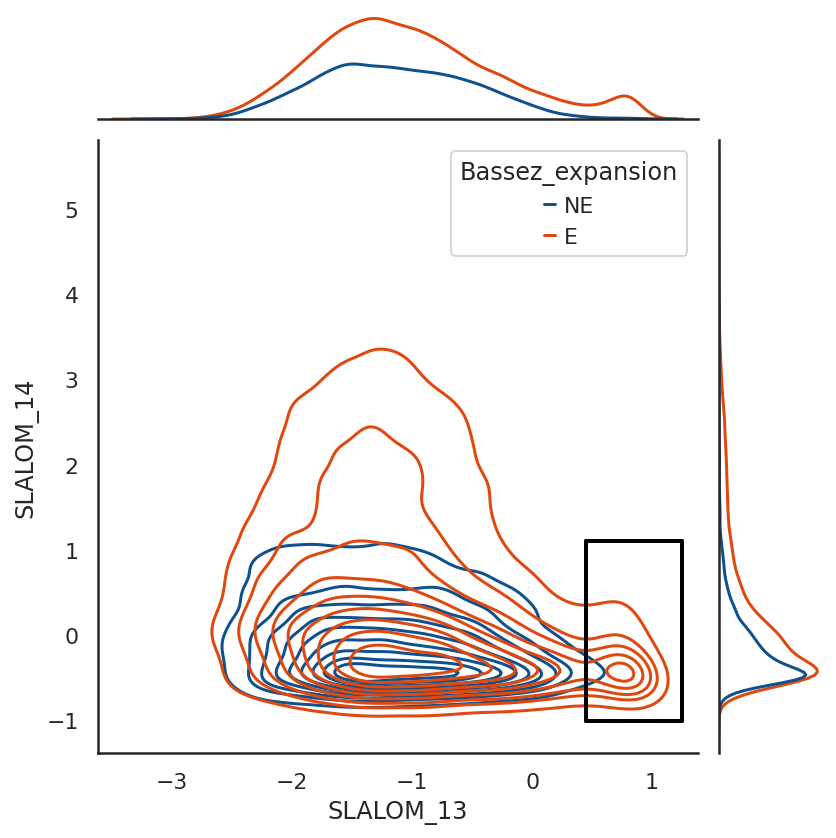

In [29]:
#density of tumor reactivity and exhaustion factors in responders and non-responders - SLALOM
%matplotlib inline
#create df for scatter
save_name = 'Bassez-SLALOM_exhaust_correlation-scatter.svg'
#create dict for batches to sample ids
clinical_var_key = 'Bassez_expansion'
use_gene_expression = True
hue_order = ['NE','E']
factor_list = ["SLALOM_14","SLALOM_13"]

zero_cutoff = None

df = adata_SLALOM_celltype[adata_SLALOM_celltype.obs[clinical_var_key].isin(hue_order)].obs[[clinical_var_key]+factor_list]
print(df.shape)

if zero_cutoff !=None:
    df = df[df[factor_list[0]]>zero_cutoff]
    print(df.shape)
    df = df[df[factor_list[1]]>zero_cutoff]
    print(df.shape)

#calculate correlation
title = scipy.stats.spearmanr(np.array(df[factor_list[0]]), np.array(df[factor_list[1]]), axis=0, nan_policy='propagate')

#plot
sns.set_theme(style="white")
#sns.relplot(x=factor_list[1], y=factor_list[0], hue=clinical_var_key,
  #          sizes=(40, 400), alpha=.5, palette=['#DF480F','#0E518F','#000000'],
 #           height=3, data=df,s=4)

g = sns.jointplot(
    data=df,
    x=df.columns[2], y=df.columns[1] ,hue=df.columns[0],hue_order = hue_order,palette=blue_red,
    kind="kde",
)

draw_square_gate(df, g, clinical_var_key, factor_list[1], factor_list[0], (0.45,1.25),(-1,1.1), 
                 width=2, color='#000000',print_absolute=False)


#plt.title(title)
save_name_complete = figure_save_path + save_name
plt.savefig(save_name_complete)
print('saved to:',save_name_complete)
print(title)

(28766, 3)
['all_:_8.774247375373704%', 'NE_:_8.12%', 'E_:_9.122881807524246%']
saved to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/Bassez-scHPF_exhaust_correlation-scatter.svg
SpearmanrResult(correlation=0.43533756835438586, pvalue=0.0)


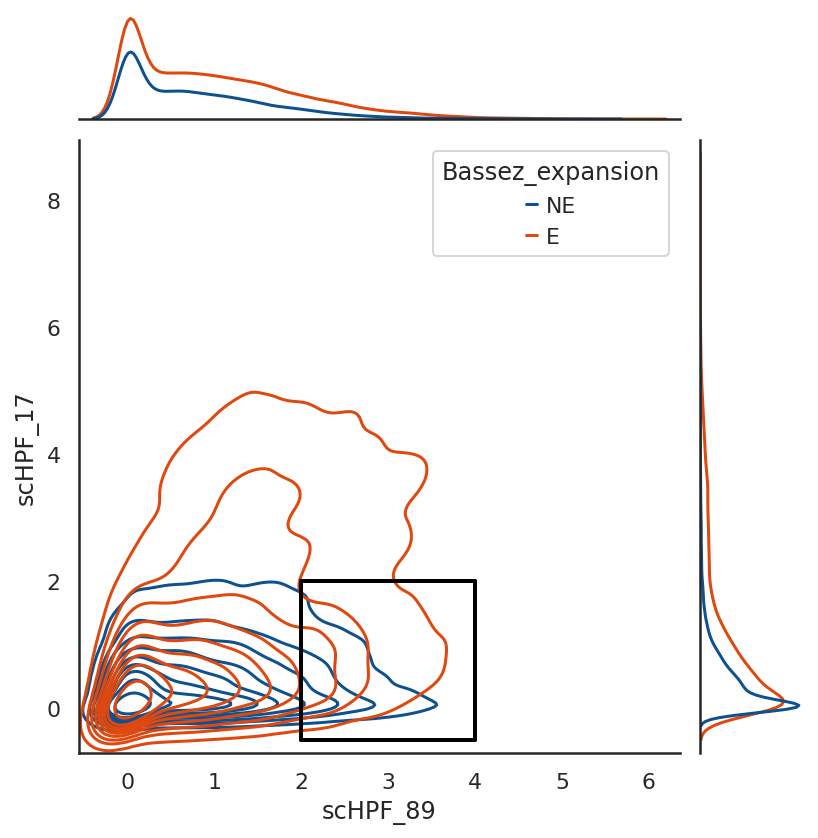

In [30]:
#density of tumor reactivity and exhaustion factors in responders and non-responders - scHPF
%matplotlib inline
#create df for scatter
save_name = 'Bassez-scHPF_exhaust_correlation-scatter.svg'
#create dict for batches to sample ids
clinical_var_key = 'Bassez_expansion'
use_gene_expression = True
hue_order = ['NE','E']
factor_list = ["scHPF_17","scHPF_89"]

zero_cutoff = None

df = adata_scHPF_celltype[adata_scHPF_celltype.obs[clinical_var_key].isin(hue_order)].obs[[clinical_var_key]+factor_list]
print(df.shape)

if zero_cutoff !=None:
    df = df[df[factor_list[0]]>zero_cutoff]
    print(df.shape)
    df = df[df[factor_list[1]]>zero_cutoff]
    print(df.shape)

#calculate correlation
title = scipy.stats.spearmanr(np.array(df[factor_list[0]]), np.array(df[factor_list[1]]), axis=0, nan_policy='propagate')

#plot
sns.set_theme(style="white")
#sns.relplot(x=factor_list[1], y=factor_list[0], hue=clinical_var_key,
  #          sizes=(40, 400), alpha=.5, palette=['#DF480F','#0E518F','#000000'],
 #           height=3, data=df,s=4)

g = sns.jointplot(
    data=df,
    x=df.columns[2], y=df.columns[1] ,hue=df.columns[0],hue_order = hue_order,palette=blue_red,
    kind="kde",
)

draw_square_gate(df, g, clinical_var_key, factor_list[1], factor_list[0], (2,4),(-0.5,2), 
                 width=2, color='#000000',print_absolute=False)


#plt.title(title)
save_name_complete = figure_save_path + save_name
plt.savefig(save_name_complete)
print('saved to:',save_name_complete)
print(title)

(28766, 3)
['all_:_13.397761245915316%', 'NE_:_2.35%', 'E_:_19.28487690504103%']
saved to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/Bassez-SPECTRA_exhaust_correlation-scatter.svg
SpearmanrResult(correlation=0.07206225442876901, pvalue=1.959049984792364e-34)


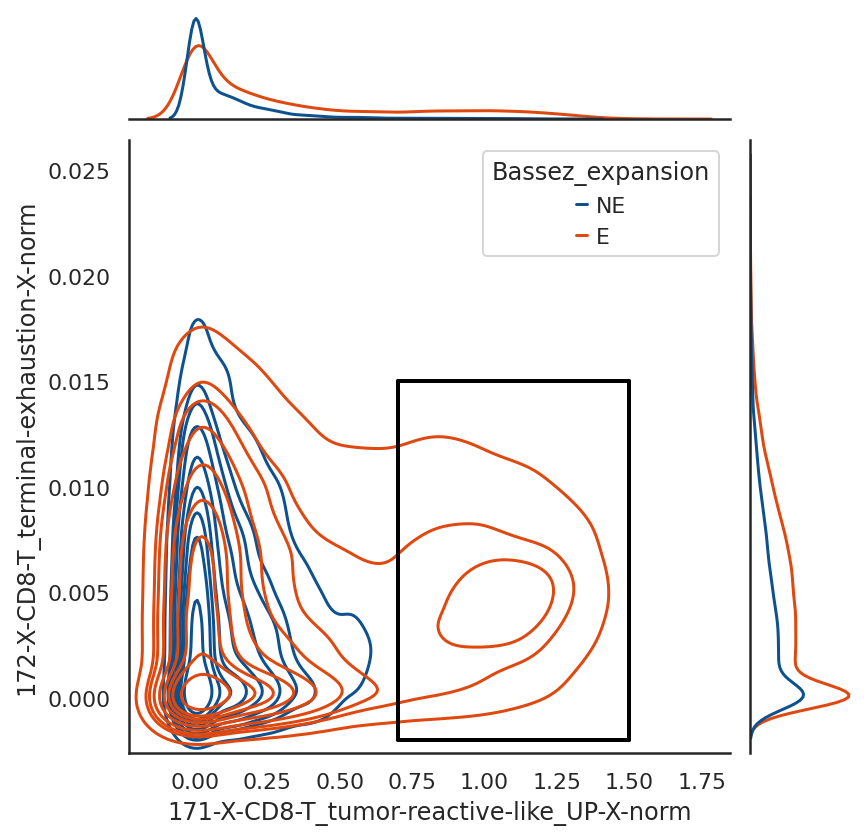

In [31]:
#density of tumor reactivity and exhaustion factors in responders and non-responders - Spectra
%matplotlib inline
#create df for scatter
save_name = 'Bassez-SPECTRA_exhaust_correlation-scatter.svg'
#create dict for batches to sample ids
clinical_var_key = 'Bassez_expansion'
use_gene_expression = True
hue_order = ['NE','E']
factor_list = ['172-X-CD8-T_terminal-exhaustion-X-norm','171-X-CD8-T_tumor-reactive-like_UP-X-norm']

zero_cutoff = None

df = adata_SPECTRA_celltype[adata_SPECTRA_celltype.obs[clinical_var_key].isin(hue_order)].obs[[clinical_var_key]+factor_list]
print(df.shape)

if zero_cutoff !=None:
    df = df[df[factor_list[0]]>zero_cutoff]
    print(df.shape)
    df = df[df[factor_list[1]]>zero_cutoff]
    print(df.shape)

#calculate correlation
title = scipy.stats.spearmanr(np.array(df[factor_list[0]]), np.array(df[factor_list[1]]), axis=0, nan_policy='propagate')

#plot
sns.set_theme(style="white")
#sns.relplot(x=factor_list[1], y=factor_list[0], hue=clinical_var_key,
  #          sizes=(40, 400), alpha=.5, palette=['#DF480F','#0E518F','#000000'],
 #           height=3, data=df,s=4)

g = sns.jointplot(
    data=df,
    x=df.columns[2], y=df.columns[1] ,hue=df.columns[0],hue_order = hue_order,palette=blue_red,
    kind="kde",
)

draw_square_gate(df, g, clinical_var_key, factor_list[1], factor_list[0], (0.7,1.5),(-0.002,0.015), 
                 width=2, color='#000000',print_absolute=False)


#plt.title(title)
save_name_complete = figure_save_path + save_name
plt.savefig(save_name_complete)
print('saved to:',save_name_complete)
print(title)

## compare mean cell scores per sample in CD8 T cells responders vs non-responders

### SLALOM

In [32]:
#calculate aggregate factor loadings per batch

#set parameters0
factor_name_list_corr = ['SLALOM_0', 'SLALOM_1', 'SLALOM_2', 'SLALOM_3', 'SLALOM_4', 'SLALOM_5', 'SLALOM_6', 'SLALOM_7',
                         'SLALOM_8', 'SLALOM_9', 'SLALOM_10', 'SLALOM_11', 
                         'SLALOM_12', 'SLALOM_13', 'SLALOM_14', 'SLALOM_15', 'SLALOM_16', 'SLALOM_17', 'SLALOM_18', 'SLALOM_19']
clinical_var_obs = 'Bassez_timepoint' #obs for clinical variable to correlate with
clinical_var2_obs = 'Bassez_expansion'
patient_obs = 'Bassez_patient_id'
obs_columns = ['clinical_var','clinical_var2','patient'] #these will store the obs above and will be dropped for calculations
zero_cutoff = None
#zero_cutoff = 0.01
#define parameters
#factor_name_list_corr = list(set(adata_SLALOM_celltype.uns['SPADE_markers_global'].keys()))


df_batches = aggregate_cell_scores(adata_SLALOM_celltype,clinical_var_obs,clinical_var2_obs,factor_name_list_corr,batch_key='batch',
                      patient_obs=patient_obs,
                            obs_columns=['clinical_var','clinical_var2','patient'],
                            zero_cutoff =zero_cutoff)



In [240]:
#wilcoxon matched pairs test

result= compare_factors(df_batches[df_batches['clinical_var']=='Pre'], 'SLALOM_13','patient','clinical_var2',
                       ['E','NE'], test='mann-whitney')
result

MannwhitneyuResult(statistic=198.0, pvalue=0.38393711022388266)

In [52]:
df_sub = df_batches[df_batches['clinical_var']=='Pre']
df_sub_1 = df_sub[df_sub['clinical_var2']=='NE']
df_sub_2  = df_sub[df_sub['clinical_var2']=='E']
(np.mean(df_sub_1['SLALOM_13'])-np.mean(df_sub_2['SLALOM_13']))/np.std(list(df_sub_1['SLALOM_13'])+list(df_sub_2['SLALOM_13']))

-0.2485902759113339

In [53]:
df_sub = df_batches[df_batches['clinical_var']=='On']
df_sub_1 = df_sub[df_sub['clinical_var2']=='NE']
df_sub_2  = df_sub[df_sub['clinical_var2']=='E']
(np.mean(df_sub_1['SLALOM_13'])-np.mean(df_sub_2['SLALOM_13']))/np.std(list(df_sub_1['SLALOM_13'])+list(df_sub_2['SLALOM_13']))

0.05923813176103523

In [56]:
#wilcoxon matched pairs test
import scipy
result= compare_factors(df_batches[df_batches['clinical_var']=='On'], 'SLALOM_13','patient','clinical_var2',
                       ['E','NE'], test='mann-whitney')
result

NameError: name 'scipy' is not defined

saved to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/SLALOM_13.svg


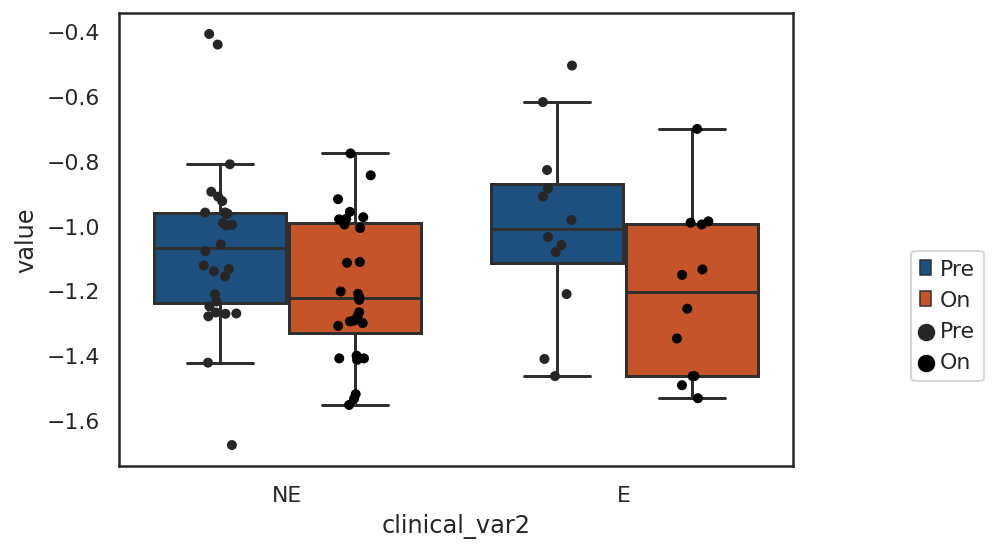

In [57]:
gene_set = 'SLALOM_13'
save_name = gene_set + '.svg'

clinical_var_to_include = ['Pre','On']
clinical_var_to_include2 = ['NE','E',]
sns.set_style('white')
df_plot = df_batches.copy()   
df_plot = df_plot.melt(id_vars=['clinical_var','clinical_var2'])
df_plot = df_plot[df_plot['variable']==gene_set]
df_plot = df_plot[df_plot['clinical_var'].isin(clinical_var_to_include)]
df_plot = df_plot[df_plot['clinical_var2'].isin(clinical_var_to_include2)]

ax = sns.boxplot(x='clinical_var2',y='value',hue='clinical_var',data=df_plot, showfliers = False,
                hue_order=clinical_var_to_include,order=clinical_var_to_include2,palette=timepoint_dict)
sns.stripplot(x='clinical_var2',y='value',hue='clinical_var',data=df_plot, color='#000000',dodge=True,
             hue_order=clinical_var_to_include,order=clinical_var_to_include2)
#ax.set_ylim(0,)
plt.legend(bbox_to_anchor=(0.8, 0., 0.5, 0.5))
save_name_complete = figure_save_path + save_name
plt.savefig(save_name_complete)
print('saved to:',save_name_complete)

## scHPF

In [59]:
#calculate aggregate factor loadings per batch

#set parameters0
factor_name_list_corr = ['scHPF_0', 'scHPF_1', 'scHPF_2', 'scHPF_3', 'scHPF_4', 'scHPF_5', 'scHPF_6', 'scHPF_7', 'scHPF_8', 'scHPF_9',
                         'scHPF_10', 'scHPF_11', 'scHPF_12', 'scHPF_13', 'scHPF_14', 'scHPF_15', 'scHPF_16', 'scHPF_17', 'scHPF_18',
                         'scHPF_19', 'scHPF_20', 'scHPF_21', 'scHPF_22', 'scHPF_23', 'scHPF_24', 'scHPF_25', 'scHPF_26', 'scHPF_27',
                         'scHPF_28', 'scHPF_29', 'scHPF_30', 'scHPF_31', 'scHPF_32', 'scHPF_33', 'scHPF_34', 'scHPF_35', 'scHPF_36',
                         'scHPF_37', 'scHPF_38', 'scHPF_39', 'scHPF_40', 'scHPF_41', 'scHPF_42', 'scHPF_43', 'scHPF_44', 'scHPF_45', 
                         'scHPF_46', 'scHPF_47', 'scHPF_48', 'scHPF_49', 'scHPF_50', 'scHPF_51', 'scHPF_52', 'scHPF_53', 'scHPF_54', 
                         'scHPF_55', 'scHPF_56', 'scHPF_57', 'scHPF_58', 'scHPF_59', 'scHPF_60', 'scHPF_61', 'scHPF_62', 'scHPF_63', 
                         'scHPF_64', 'scHPF_65', 'scHPF_66', 'scHPF_67', 'scHPF_68', 'scHPF_69', 'scHPF_70', 'scHPF_71', 'scHPF_72',
                         'scHPF_73', 'scHPF_74', 'scHPF_75', 'scHPF_76', 'scHPF_77', 'scHPF_78', 'scHPF_79', 
                         'scHPF_80', 'scHPF_81', 'scHPF_82', 'scHPF_83', 'scHPF_84', 'scHPF_85', 'scHPF_86', 'scHPF_87', 
                         'scHPF_88', 'scHPF_89', 'scHPF_90', 'scHPF_91', 'scHPF_92', 'scHPF_93', 'scHPF_94', 'scHPF_95', 
                         'scHPF_96', 'scHPF_97', 'scHPF_98', 'scHPF_99']
clinical_var_obs = 'Bassez_timepoint' #obs for clinical variable to correlate with
clinical_var2_obs = 'Bassez_expansion'
patient_obs = 'Bassez_patient_id'
obs_columns = ['clinical_var','clinical_var2','patient'] #these will store the obs above and will be dropped for calculations
zero_cutoff = 0.001


df_batches = aggregate_cell_scores(adata_scHPF_celltype,clinical_var_obs,clinical_var2_obs,factor_name_list_corr,batch_key='batch',
                      patient_obs=patient_obs,
                            obs_columns=['clinical_var','clinical_var2','patient'],
                            zero_cutoff =zero_cutoff)



/home/wallet/.local/lib/python3.10/site-packages/pandas/core/indexing.py:1684: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.obj[key] = infer_fill_value(value)


In [232]:
#wilcoxon matched pairs test

result= compare_factors(df_batches[df_batches['clinical_var']=='On'], 'scHPF_89','patient','clinical_var2',
                       ['E','NE'], test='mann-whitney')
result

MannwhitneyuResult(statistic=216.0, pvalue=0.16093968296119787)

In [64]:
df_sub = df_batches[df_batches['clinical_var']=='Pre']
df_sub_1 = df_sub[df_sub['clinical_var2']=='NE']
df_sub_2  = df_sub[df_sub['clinical_var2']=='E']
(np.mean(df_sub_1['scHPF_89'])-np.mean(df_sub_2['scHPF_89']))/np.std(list(df_sub_1['scHPF_89'])+list(df_sub_2['scHPF_89']))

-0.467121616654345

In [231]:
#wilcoxon matched pairs test

result= compare_factors(df_batches[df_batches['clinical_var']=='Pre'], 'scHPF_89','patient','clinical_var2',
                       ['E','NE'], test='mann-whitney')
result

MannwhitneyuResult(statistic=201.0, pvalue=0.33745438856130017)

In [65]:
df_sub = df_batches[df_batches['clinical_var']=='On']
df_sub_1 = df_sub[df_sub['clinical_var2']=='NE']
df_sub_2  = df_sub[df_sub['clinical_var2']=='E']
(np.mean(df_sub_1['scHPF_89'])-np.mean(df_sub_2['scHPF_89']))/np.std(list(df_sub_1['scHPF_89'])+list(df_sub_2['scHPF_89']))

-0.5921749273445479

saved to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/scHPF_89.svg


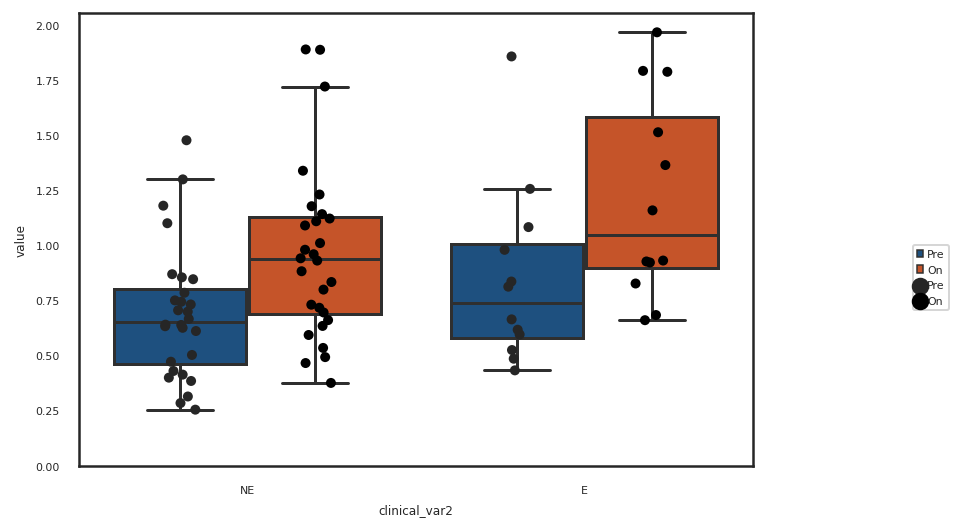

In [173]:
gene_set = 'scHPF_89'
save_name = gene_set + '.svg'

clinical_var_to_include = ['Pre','On']
clinical_var_to_include2 = ['NE','E',]
sns.set_style('white')
df_plot = df_batches.copy()   
df_plot = df_plot.melt(id_vars=['clinical_var','clinical_var2'])
df_plot = df_plot[df_plot['variable']==gene_set]
df_plot = df_plot[df_plot['clinical_var'].isin(clinical_var_to_include)]
df_plot = df_plot[df_plot['clinical_var2'].isin(clinical_var_to_include2)]

ax = sns.boxplot(x='clinical_var2',y='value',hue='clinical_var',data=df_plot, showfliers = False,
                hue_order=clinical_var_to_include,order=clinical_var_to_include2,palette=timepoint_dict)
sns.stripplot(x='clinical_var2',y='value',hue='clinical_var',data=df_plot, color='#000000',dodge=True,
             hue_order=clinical_var_to_include,order=clinical_var_to_include2)
ax.set_ylim(0,)
plt.legend(bbox_to_anchor=(0.8, 0., 0.5, 0.5))
save_name_complete = figure_save_path + save_name
plt.savefig(save_name_complete)
print('saved to:',save_name_complete)